In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
from scipy.io import mmread
import sys
from anndata import AnnData
import scanpy as sc
import importlib
from collections import defaultdict, Counter
import json
import seaborn as sns
from scipy.stats import chisquare, spearmanr, pearsonr
from statsmodels.stats.multitest import multipletests
import warnings
from os.path import join

import spatialcorr

DATA_ROOT = './data'
RESULTS_ROOT = './results'

warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
def plot_gene(gene, ad, log=False, cmap='viridis', ax=None, figure=None, title=None):
    if log:
        expr = np.log(ad.obs_vector(gene))
    else:
        expr = ad.obs_vector(gene)
    llrtp.plot_slide(
        ad.obs, 
        expr, 
        cmap=cmap, 
        title=title,
        dsize=10,
        ax=ax,
        figure=figure
    )
    plt.title(gene)
    plt.show()
    
def plot_cluster_scatter(g1, g2, clust, col_vals=None, cmap=None, color=None, xlim=None, ylim=None):
    fig, ax = plt.subplots(1,1, figsize=(3, 3)) 
    ct_to_inds = defaultdict(lambda: [])
    for ind, ct in enumerate(adata.obs['BayesSpace_11']):
        ct_to_inds[ct].append(ind)
    expr_1 = adata.obs_vector(g1)[ct_to_inds[clust]]
    expr_2 = adata.obs_vector(g2)[ct_to_inds[clust]]
    if col_vals is not None:
        scatter_kws = {
            'color': None,
            'c': col_vals[ct_to_inds[clust]],
            'cmap': cmap,
            'alpha': 1.0
        }
        sns.regplot(expr_1, expr_2, scatter_kws=scatter_kws)        
    elif color is not None:
        scatter_kws = {
            'color': color,
            's': 5
        }
        sns.regplot(expr_1, expr_2, scatter_kws=scatter_kws, ax=ax) 
        #sns.kdeplot(expr_1, expr_2, scatter_kws=scatter_kws, ax=ax) 
    else:
        sns.regplot(expr_1, expr_2)#, s=4)
    #plt.show()
    plt.xlabel(f'{g1} Expression')
    plt.ylabel(f'{g2} Expression')
    
    if xlim:
        plt.xlim(xlim)
    if ylim:
        plt.ylim(ylim)


    
def plot_cluster_mvn(g1, g2, clust, col_vals=None, cmap=None, xlim=None, ylim=None):
    
    
    ct_to_inds = defaultdict(lambda: [])
    for ind, ct in enumerate(adata.obs['BayesSpace_11']):
        ct_to_inds[ct].append(ind)
    expr_1 = adata.obs_vector(g1)[ct_to_inds[clust]]
    expr_2 = adata.obs_vector(g2)[ct_to_inds[clust]]
    X = np.array([expr_1, expr_2])
    mean = np.mean(X, axis=1)
    cov = np.cov(X)
    
    fig, ax = plt.subplots(1,1, figsize=(5,5))

    v, w = np.linalg.eigh(cov)
    v = 2. * np.sqrt(2.) * np.sqrt(v)
    u = w[0] / np.linalg.norm(w[0])

    ax.scatter(X[0, :], X[1, :], .8, color='black')
    #ax.scatter([the_x[0]], [the_x[1]], 5., color='red')
    # Plot an ellipse to show the Gaussian component
    angle = np.arctan(u[1] / u[0])
    angle = 180. * angle / np.pi  # convert to degrees
    ell = mpl.patches.Ellipse(mean, v[0], v[1], 180. + angle, color='blue')
    ell.set_clip_box(ax.bbox)
    ell.set_alpha(0.2)
    ax.add_artist(ell)
    
    plt.xlabel(f'{g1} Expression')
    plt.ylabel(f'{g2} Expression')
    
    if xlim:
        plt.xlim(xlim)
    if ylim:
        plt.ylim(ylim)

######### TODO MOVE THIS INTO THE SPATIALCORR PACKAGE
def _map_row_col_to_barcode(df):
    """
    Map each row, column pair to its barcode.
    """
    row_to_col_to_bc = defaultdict(lambda: {})
    for ri, row in df.iterrows():
        r = row['row']
        c = row['col']
        b = row.name
        row_to_col_to_bc[r][c] = b
    return row_to_col_to_bc

def compute_spotwise_significance(df, spot_p_vals):
    df = df.copy()
    df['tissue'] = [1 for i in range(df.shape[0])]

    row_col_to_barcode = _map_row_col_to_barcode(df)
    
    print('Mapping each barcode to its neighbors...')
    bc_to_neighs, bc_to_above_neighs, bc_to_below_neighs = map_neighbors._map_coords_to_neighbors(
        df, 
        row_col_to_barcode,
        row_key='row',
        col_key='col'
    )
    print('done.')
    
    bc_to_plot_index = {
        bc: index
        for index, bc in enumerate(df.index)
    }
    cs_pvals = []
    for bc_i, bc in enumerate(df.index):
        neighs = bc_to_neighs[bc]
        neigh_inds = [bc_to_plot_index[neigh] for neigh in neighs]
        neigh_p_vals = np.array(spot_p_vals)[neigh_inds]
        intervals = [0.25, 0.5, 0.75, 1.0]
        interval_counts = [0,0,0,0]
        for p_val in neigh_p_vals:
            for int_i in range(len(intervals)):
                if p_val <= intervals[int_i]:
                    interval_counts[int_i] += 1
                    break
        _, cs_pval = chisquare(interval_counts)
        cs_pvals.append(cs_pval)
    return cs_pvals


In [3]:
df_meta = pd.read_csv(join(DATA_ROOT, 'spatial/tissue_positions_list.csv'), header=None)
df_meta.columns = ['barcode', 'tissue', 'row', 'col', 'imgrow', 'imgcol']
df_meta = df_meta.set_index('barcode')
df_meta

,tissue,row,col,imgrow,imgcol
barcode,,,,,
ACGCCTGACACGCGCT-1,0,0,0,5819,5006
TACCGATCCAACACTT-1,0,1,1,6325,5296
ATTAAAGCGGACGAGC-1,0,0,2,5819,5587
GATAAGGGACGATTAG-1,0,1,3,6325,5878
GTGCAAATCACCAATA-1,0,0,4,5819,6169
...,...,...,...,...,...
GAACGTTTGTATCCAC-1,0,77,123,44804,40741
ATTGAATTCCCTGTAG-1,0,76,124,44298,41032
TACCTCACCAATTGTA-1,0,77,125,44804,41322


In [4]:
df_feats = pd.read_csv(join(DATA_ROOT, 'filtered_feature_bc_matrix/features.tsv.gz'), sep='\t', header=None)
df_feats.columns = ['gene_id', 'gene_name', 'assay']
df_feats = df_feats.set_index('gene_id')
df_bc = pd.read_csv(join(DATA_ROOT, 'filtered_feature_bc_matrix/barcodes.tsv.gz'), header=None, sep='\t')
df_bc.columns=['barcode']
df_bc = df_bc.set_index('barcode')
X = mmread(join(DATA_ROOT, 'filtered_feature_bc_matrix/matrix.mtx.gz')).todense().T
    
df_counts = pd.DataFrame(
    data=X,
    columns=df_feats['gene_name'],
    index=df_bc.index
)
df_counts

gene_name,MIR1302-2HG,FAM138A,OR4F5,AL627309.1,AL627309.3,AL627309.2,AL627309.4,AL732372.1,OR4F29,AC114498.1,...,AC007325.2,BX072566.1,AL354822.1,AC023491.2,AC004556.1,AC233755.2,AC233755.1,AC240274.1,AC213203.1,FAM231C
barcode,,,,,,,,,,,,,,,,,,,,,
AAACAAGTATCTCCCA-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AAACATTTCCCGGATT-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AAACCTAAGCAGCCGG-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AAACGAGACGGTTGAT-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AAACGGGCGTACGGGT-1,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTCGTTCAGTTACC-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TTGTGAACCTAATCCG-1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TTGTGGTGGTACTAAG-1,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0


### Filter tissue spots

In [5]:
df_meta_ts = df_meta.loc[df_meta['tissue'] == 1]
df_counts_ts = df_counts.loc[df_meta_ts.index]

total_counts = np.sum(df_counts_ts, axis=1)
df_meta_ts['total_umi_count'] = total_counts
df_meta_ts = df_meta_ts.loc[df_meta_ts['total_umi_count'] > 100]
df_counts_ts = df_counts.loc[df_meta_ts.index]

assert df_counts_ts.shape[0] == df_meta_ts.shape[0]

/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


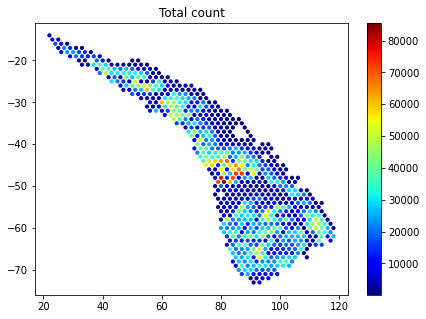

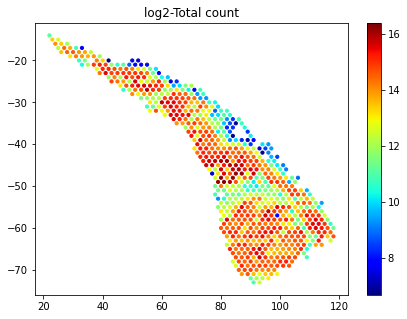

In [6]:
total_counts = np.sum(df_counts_ts, axis=1)
spatialcorr.plot_slide(
    df_meta_ts, 
    total_counts, 
    cmap='jet',
    colorbar=True,
    title="Total count",
    dsize=10
)

spatialcorr.plot_slide(
    df_meta_ts, 
    np.log2(total_counts), 
    cmap='jet',
    colorbar=True,
    title="log2-Total count",
    dsize=10
)

In [7]:
df_dino = pd.read_csv(join(DATA_ROOT, 'dino/GSM4565824_P4_rep1.dino.tsv.gz'), sep='\t', index_col=0)
df_dino = df_dino.transpose()
df_dino.index = [x.replace('.', '-') for x in df_dino.index]
df_dino = df_dino.loc[df_meta_ts.index]
df_dino

,MIR1302-2HG,FAM138A,OR4F5,AL627309.1,AL627309.3,AL627309.2,AL627309.4,AL732372.1,OR4F29,AC114498.1,...,AC007325.2,BX072566.1,AL354822.1,AC023491.2,AC004556.1,AC233755.2,AC233755.1,AC240274.1,AC213203.1,FAM231C
barcode,,,,,,,,,,,,,,,,,,,,,
CGAGGCCAGGCATTGG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TCTGCGTCCGGTTTCT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CTGAGCAAGTAACAAG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAATGCTCGTTACGTT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CACCTAATAGAGTCGT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CTTCAGTTGGACAACG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TGATCTATCACACTCT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TAGCAGATACTTAGGG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
df_bayes_11 = pd.read_csv(join(DATA_ROOT, 'BayesSpace/BayesSpace_output.7_clusts.tsv'), sep='\t', index_col=0)
df_bayes_11 = df_bayes_11.loc[df_meta_ts.index]
df_meta_ts['BayesSpace'] = [x for x in df_bayes_11['spatial.cluster']]
df_bayes_11

,spot,in_tissue,row,col,imagerow,imagecol,sizeFactor,cluster.init,spatial.cluster
barcode,,,,,,,,,
CGAGGCCAGGCATTGG-1,CGAGGCCAGGCATTGG-1,1,14,22,12907,11397,0.121724,2,2
TCTGCGTCCGGTTTCT-1,TCTGCGTCCGGTTTCT-1,1,15,23,13413,11688,0.572064,2,2
CTGAGCAAGTAACAAG-1,CTGAGCAAGTAACAAG-1,1,15,25,13413,12269,0.334261,2,2
AAATGCTCGTTACGTT-1,AAATGCTCGTTACGTT-1,1,16,24,13919,11978,0.938606,2,2
CACCTAATAGAGTCGT-1,CACCTAATAGAGTCGT-1,1,17,25,14425,12268,0.271728,2,2
...,...,...,...,...,...,...,...,...,...
CTTCAGTTGGACAACG-1,CTTCAGTTGGACAACG-1,1,73,91,42773,31437,0.106652,7,7
TGATCTATCACACTCT-1,TGATCTATCACACTCT-1,1,72,92,42267,31729,0.239447,7,7
TAGCAGATACTTAGGG-1,TAGCAGATACTTAGGG-1,1,73,93,42773,32019,0.312668,7,7


In [9]:
adata = AnnData(df_dino)
adata.obs = df_meta_ts
adata

AnnData object with n_obs × n_vars = 733 × 33538
    obs: 'tissue', 'row', 'col', 'imgrow', 'imgcol', 'total_umi_count', 'BayesSpace'

### GO term results analysis

BHR-Test
['GO_REGULATION_OF_MITOCHONDRIAL_MEMBRANE_PERMEABILITY_INVOLVED_IN_APOPTOTIC_PROCESS', 0.0001, 0.0008289855072463769]
['GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE', 0.0001, 0.0008289855072463769]
['GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0008289855072463769]
['GO_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE', 0.0001, 0.0008289855072463769]
['GO_NEGATIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0008289855072463769]
['GO_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_BY_P53_CLASS_MEDIATOR', 0.0001, 0.0008289855072463769]
['GO_POSITIVE_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0008289855072463769]
['GO_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0008289855072463769]
['GO_APOPTOTIC_MITOCHONDRIAL_CHANGES', 0.0001, 0.0008289855072463769]
['GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0008289855072463769]
['GO_REGULATION_OF_APOPTOTIC_S

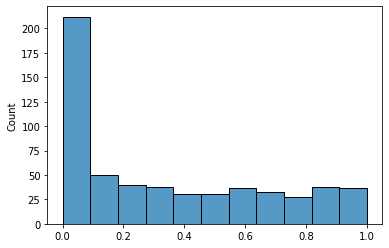

In [12]:
with open(join(RESULTS_ROOT, 'ANGIOGENESIS.BHR.json'), 'r') as f:
    j_angiogenesis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'APOPTOSIS.BHR.json'), 'r') as f:
    j_apoptosis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'B_CELL.BHR.json'), 'r') as f:
    j_b_cell_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CALCIUM.BHR.json'), 'r') as f:
    j_calcium_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DEATH.BHR.json'), 'r') as f:
    j_cell_death_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CYCLE.BHR.json'), 'r') as f:
    j_cell_cycle_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DIVISION.BHR.json'), 'r') as f:
    j_cell_division_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPAIR.BHR.json'), 'r') as f:
    j_dna_repair_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPLICATION.BHR.json'), 'r') as f:
    j_dna_replication_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'EPIDERMIS_DEVELOPMENT.BHR.json'), 'r') as f:
    j_epidermis_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'EPITHELIAL.BHR.json'), 'r') as f:
    j_epithelial_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'FIBROBLAST.BHR.json'), 'r') as f:
    j_fibroblast_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CELL_ADHESION.BHR.json'), 'r') as f:
    j_cell_cell_adhesion_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'KERATINOCYTE.BHR.json'), 'r') as f:
    j_keratinocyte_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'HYPOXIA.BHR.json'), 'r') as f:
    j_hypoxia_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERFERON.BHR.json'), 'r') as f:
    j_interferon_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERLEUKIN_RELATED.BHR.json'), 'r') as f:
    j_interleukin_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'MATRIX.BHR.json'), 'r') as f:
    j_matrix_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'MIGRATION.BHR.json'), 'r') as f:
    j_migration_bhr = json.load(f)
with open(join(RESULTS_ROOT, 'T_CELL.BHR.json'), 'r') as f:
    j_t_cell_bhr = json.load(f)
    
res_l = [
    j_angiogenesis_bhr,
    j_apoptosis_bhr,
    j_b_cell_bhr,
    j_calcium_bhr,
    j_cell_cycle_bhr,
    j_cell_death_bhr,
    j_cell_division_bhr,
    j_dna_repair_bhr,
    j_dna_replication_bhr,
    j_epidermis_bhr,
    j_epithelial_bhr,
    j_fibroblast_bhr,
    j_cell_cell_adhesion_bhr,
    j_keratinocyte_bhr,
    j_hypoxia_bhr,
    j_interferon_bhr,
    j_interleukin_bhr,
    j_matrix_bhr,
    j_migration_bhr,
    j_t_cell_bhr
]
bhr_results = []
for res in res_l:
    bhr_results += res['gene_set_to_pval'].items()
    
print("BHR-Test")
gs_bhr_p_vals = [x[1] for x in bhr_results]
gs_bhr_p_vals_fdr, gs_bhr_p_vals_adj, _, _ = multipletests(
    gs_bhr_p_vals, 
    method='fdr_bh',
    alpha=0.05
)
bhr_results = [list(x) for x in bhr_results]
for adj, res in zip(gs_bhr_p_vals_adj, bhr_results):
    res.append(adj)
print('\n'.join(map(str, sorted(bhr_results, key=lambda x: x[1])[:150])))
print(Counter(gs_bhr_p_vals_fdr))
sns.histplot(gs_bhr_p_vals)
plt.show()

WHR-Test
['GO_EXTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0012456521739130436]
['GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE', 0.0001, 0.0012456521739130436]
['GO_NEGATIVE_REGULATION_OF_EXTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0012456521739130436]
['GO_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0012456521739130436]
['GO_REGULATION_OF_EXTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0012456521739130436]
['GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0012456521739130436]
['GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_BY_P53_CLASS_MEDIATOR', 0.0001, 0.0012456521739130436]
['GO_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0012456521739130436]
['GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0012456521739130436]
['GO_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0001, 0.0012456521739130436]
['GO_ACTIVATION_OF_CYSTEINE_TYPE_ENDOPEPTIDASE_ACTIVITY_INVOLVED_IN_APOPTOTIC_PROCESS', 0.0001, 0.0012456521739130436]
['GO_C

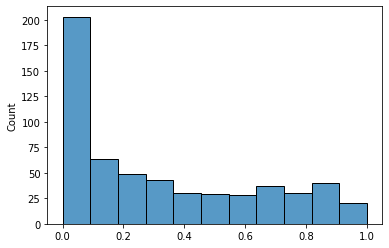

In [6]:
with open(join(RESULTS_ROOT, 'ANGIOGENESIS.WHR.json'), 'r') as f:
    j_angiogenesis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'APOPTOSIS.WHR.json'), 'r') as f:
    j_apoptosis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'B_CELL.WHR.json'), 'r') as f:
    j_b_cell_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CALCIUM.WHR.json'), 'r') as f:
    j_calcium_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CYCLE.WHR.json'), 'r') as f:
    j_cell_cycle_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DEATH.WHR.json'), 'r') as f:
    j_cell_death_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_DIVISION.WHR.json'), 'r') as f:
    j_cell_division_whr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPAIR.WHR.json'), 'r') as f:
    j_dna_repair_whr = json.load(f)
with open(join(RESULTS_ROOT, 'DNA_REPLICATION.WHR.json'), 'r') as f:
    j_dna_replication_whr = json.load(f)
with open(join(RESULTS_ROOT, 'EPIDERMIS_DEVELOPMENT.WHR.json'), 'r') as f:
    j_epidermis_whr = json.load(f)
with open(join(RESULTS_ROOT, 'EPITHELIAL.WHR.json'), 'r') as f:
    j_epithelial_whr = json.load(f)
with open(join(RESULTS_ROOT, 'FIBROBLAST.WHR.json'), 'r') as f:
    j_fibroblast_whr = json.load(f)
with open(join(RESULTS_ROOT, 'CELL_CELL_ADHESION.WHR.json'), 'r') as f:
    j_cell_cell_adhesion_whr = json.load(f)
with open(join(RESULTS_ROOT, 'KERATINOCYTE.WHR.json'), 'r') as f:
    j_keratinocyte_whr = json.load(f)
with open(join(RESULTS_ROOT, 'HYPOXIA.WHR.json'), 'r') as f:
    j_hypoxia_whr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERFERON.WHR.json'), 'r') as f:
    j_interferon_whr = json.load(f)
with open(join(RESULTS_ROOT, 'INTERLEUKIN_RELATED.WHR.json'), 'r') as f:
    j_interleukin_whr = json.load(f)
with open(join(RESULTS_ROOT, 'MATRIX.WHR.json'), 'r') as f:
    j_matrix_whr = json.load(f)
with open(join(RESULTS_ROOT, 'MIGRATION.WHR.json'), 'r') as f:
    j_migration_whr = json.load(f)
with open(join(RESULTS_ROOT, 'T_CELL.WHR.json'), 'r') as f:
    j_t_cell_whr = json.load(f)
    
res_l = [
    j_angiogenesis_whr,
    j_apoptosis_whr,
    j_b_cell_whr,
    j_calcium_whr,
    j_cell_cycle_whr,
    j_cell_death_whr,
    j_cell_division_whr,
    j_dna_repair_whr,
    j_dna_replication_whr,
    j_epidermis_whr,
    j_epithelial_whr,
    j_fibroblast_whr,
    j_cell_cell_adhesion_whr,
    j_keratinocyte_whr,
    j_hypoxia_whr,
    j_interferon_whr,
    j_interleukin_whr,
    j_matrix_whr,
    j_migration_whr,
    j_t_cell_whr
]
whr_results = []
for res in res_l:
    whr_results += res['gene_set_to_pval'].items()
    
gs_to_genes = {}
for res in res_l:
    gs_to_genes.update(res['gene_set_to_genes'])
    
print("WHR-Test")
gs_whr_p_vals = [x[1] for x in whr_results]

gs_whr_p_vals_fdr, gs_whr_p_vals_adj, _, _ = multipletests(
    gs_whr_p_vals, 
    method='fdr_bh',
    alpha=0.05
)
whr_results = [list(x) for x in whr_results]
for adj, res in zip(gs_whr_p_vals_adj, whr_results):
    res.append(adj)

print('\n'.join(map(str, sorted(whr_results, key=lambda x: x[1])[:50])))
print(Counter(gs_whr_p_vals_fdr))
sns.histplot(gs_whr_p_vals)
plt.show()

In [11]:
print(', '.join(gs_to_genes['GO_KERATINOCYTE_DIFFERENTIATION']))
print(', '.join(gs_to_genes['GO_CELL_CYCLE']))
print(', '.join(gs_to_genes['GO_DNA_REPAIR']))
print(', '.join(gs_to_genes['GO_MYELOID_LEUKOCYTE_MIGRATION']))
print(', '.join(gs_to_genes['GO_T_CELL_PROLIFERATION']))

CSTA, DSP, KRT1, KRT10, KRT14, KRT16, KRT17, KRT5, KRT6A, KRT6B, KRT6C, PERP, S100A7, SFN, SPRR1B
ACTB, CFL1, DYNLL1, EIF4G2, GJA1, HSP90AA1, RACK1, RPL23, RPL24, RPL26, RPS15A, RPS3, RPS6, SFN, TUBA1C
HMGB1, HMGN1, ISG15, MORF4L1, NPM1, POLR2L, RBX1, RPS27A, RPS3, UBA52, UBB, UBC, UBE2D3, VCP, XRCC6
ANXA1, CD47, CD74, CD81, CD9, HMGB1, LGALS3, MIF, RAC1, RPS19, S100A14, S100A7, S100A8, S100A9, WDR1
ANXA1, CD24, CD81, CEBPB, CTNNB1, GPNMB, HLA-E, HMGB1, LGALS3, PRDX2, PRKAR1A, PRNP, PYCARD, RPS3, RPS6


In [18]:
print(', '.join(gs_to_genes['GO_KERATINOCYTE_PROLIFERATION']))
print(', '.join(gs_to_genes['GO_CELL_CYCLE']))
print(', '.join(gs_to_genes['GO_CELL_MATRIX_ADHESION']))
print(', '.join(gs_to_genes['GO_RESPONSE_TO_INTERFERON_GAMMA']))
print(', '.join(gs_to_genes['GO_REGULATION_OF_CELL_DEATH']))

CDH3, EPPK1, IRF6, KLK8, KRT2, NOTCH2, SDR16C5, SFN, SLURP1, SRSF6, TGM1, TP63, YAP1, ZFP36, ZFP36L1
ACTB, CFL1, DYNLL1, EIF4G2, GJA1, HSP90AA1, RACK1, RPL23, RPL24, RPL26, RPS15A, RPS3, RPS6, SFN, TUBA1C
CD44, CD63, COL17A1, COL3A1, CTNNB1, CTTN, EMP2, ITGA6, ITGB1, JUP, LYPD3, MACF1, RAC1, RHOA, S100A10
ACTG1, ACTR3, B2M, CD44, CDC42, GAPDH, GSN, HLA-DRA, HLA-E, HSP90AB1, IFITM3, MT2A, RPL13A, STAT1, VIM
GAPDH, GJA1, GSTP1, HSPB1, MT-CO2, PERP, RPL10, RPL26, RPS27A, RPS3A, RPS6, S100A8, S100A9, SFN, TPT1


In [5]:
total_gene_sets = set()
for genes in gs_to_genes.values():
    total_gene_sets.add(frozenset(genes))
print("Total gene sets analyzed:", len(total_gene_sets))

Total gene sets analyzed: 539


### Create other plots

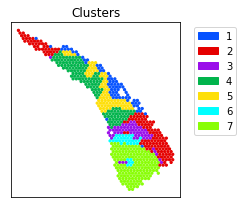

In [10]:
fig, ax = plt.subplots(1,1, figsize=(3.5, 3))
spatialcorr.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace'], 
    cmap='categorical', 
    title="Clusters",
    dsize=5,
    colorbar=True,
    ticks=False,
    figure=fig,
    ax=ax
)

plt.tight_layout()
fig.savefig('./figures/P4_clusters.pdf', format='pdf')

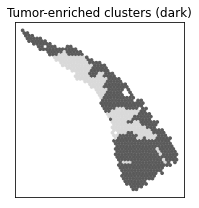

In [20]:
fig, ax = plt.subplots(1,1, figsize=(2.7, 3))
spatialcorr.plot_slide(
    adata.obs, 
    [x in set([1,2,5,6,7]) for x in adata.obs['BayesSpace']], 
    cmap='categorical', 
    title="Tumor-enriched clusters (dark)",
    dsize=7,
    ticks=False,
    figure=fig,
    ax=ax,
    cat_palette=['#d9d9d9', '#595959']
)

plt.tight_layout()
fig.savefig('./figures_V2/P4_tumor_region.pdf', format='pdf')

Kept 642/733 spots.


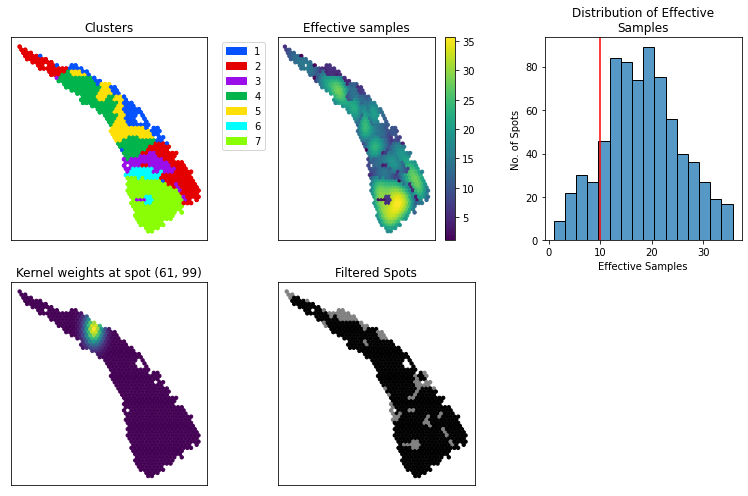

In [11]:
spatialcorr.kernel_diagnostics(
    adata,
    'BayesSpace_11',
    bandwidth=5,
    contrib_thresh=10,
    dsize=11
)

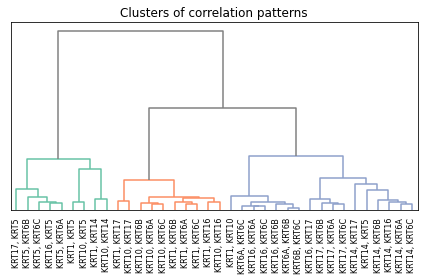

<Figure size 432x288 with 0 Axes>

In [22]:
spatialcorr.plot.cluster_pairwise_correlations(
    [
        "KRT1",
        "KRT10",
        "KRT14",
        "KRT16",
        "KRT17",
        "KRT5",
        "KRT6A",
        "KRT6B",
        "KRT6C"
    ],
    adata,
    'BayesSpace_11',
    color_thresh=25,
    remove_y_ticks=True,
    title='Clusters of correlation patterns',
    fig_path='./figures_V2/P4_keratin_pairwise_cluster.pdf',
    fig_format='pdf'
)
    

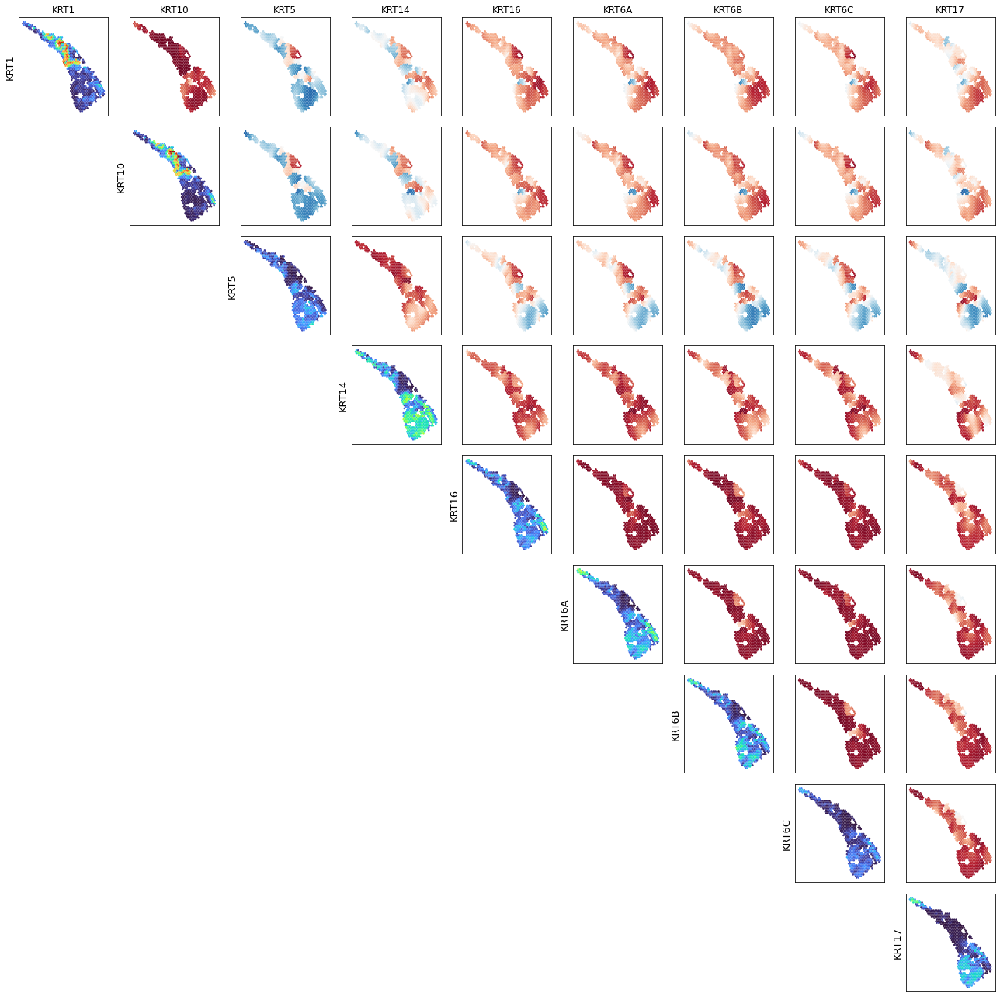

In [20]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "KRT1",
        "KRT10",
        "KRT5",
        "KRT14",
        "KRT16",
        "KRT6A",
        "KRT6B",
        "KRT6C",
        "KRT17"
    ],
    adata,
    'BayesSpace_11',
    dsize=2,
    estimate_type='local',
    fig_path='./figures_V2/P4_keratin_corr_heatmaps.pdf',
    fig_format='pdf'
)

PRKCDBP not in data...


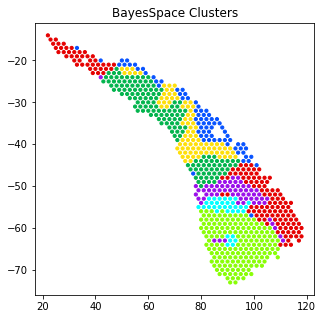

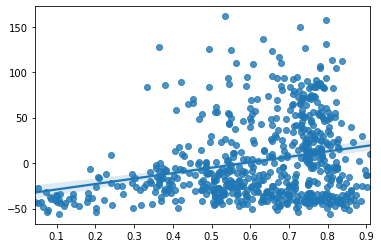

In [24]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_zs = scaler.fit_transform(adata.X)
adata_zs = AnnData(
    X=X_zs,
    obs=adata.obs,
    var=adata.var
)

tsk_genes = [
    'MMP10',
    'PTHLH',
    'FEZ1',
    'IL24',
    'KCNMA1',
    'INHBA',
    'MAGEA4',
    'NT5E',
    'LAMC2',
    'SLITRK6',
    'MMP1',
    'SERPINE1',
    'SERPINE2',
    'IGFBP6',
    'TNC',
    'ITGA5',
    'ECM1',
    'SPINK6',
    'TMSB10',
    'KRT18',
    'FST',
    'ODC1',
    'LAMB3',
    'ITGA6',
    'ACTB',
    'ITGB1',
    'SORL1',
    'PFN1',
    'EMP3',
    'S100A10',
    'EREG',
    'LAMA3',
    'PRKCDBP',
    'OCIAD2',
    'CTSV',
    'ANXA3',
    'S100A2',
    'MET',
    'CD99',
    'TMSB4X',
    'TIMP3',
    'TPM4',
    'NEFM',
    'SCG5',
    'SH3BGRL3',
    'PLAU',
    'PKM',
    'CD63',
    'LGALS1',
    'BMP1',
    'TNFRSF12A',
    'ATP1B1',
    'CFL1',
    'MBOAT2',
    'F3',
    'TNFRSF21',
    'CLIC1',
    'CAP1',
    'PDPN',
    'SERINC2',
    'ANXA1',
    'BSG',
    'DSG2',
    'RHOC',
    'KRT17',
    'PDLIM7',
    'PHLDA1',
    'GLO1',
    'LTBP1',
    'TAGLN2',
    'CD151',
    'CAPN2',
    'COL5A2',
    'IGFBP2',
    'P4HA2',
    'COL17A1',
    'PLEK2',
    'AREG',
    'ARPC1B',
    'GLIPR1',
    'S100A6',
    'PLOD3',
    'YWHAZ',
    'CAV1',
    'ADIRF',
    'TGFBI',
    'RBP1',
    'FSTL3',
    'C16orf74',
    'UPP1',
    'TNNT1',
    'ANXA5',
    'SDC1',
    'PRDX5',
    'MYL12A',
    'GJB6',
    'SLC7A8',
    'RAB32',
    'FXYD5',
    'FSCN1'   
]

tsk_zs = []
for gene in tsk_genes:
    try:
        tsk_zs.append(adata_zs.obs_vector(gene))
    except KeyError:
        print(f'{gene} not in data...')
tsk_zs = np.array(tsk_zs)
tsk_zs

spatialcorr.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="BayesSpace Clusters",
    dsize=10
)
plt.show()

tsk_scores = np.sum(tsk_zs, axis=0)
adata_zs.obs['TSK Score'] = tsk_scores

corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
    adata,
    'KRT17',
    'KRT16',
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    sigma=5,
    contrib_thresh=10
)

sns.regplot(corrs, np.array(tsk_scores)[keep_inds])
plt.show()

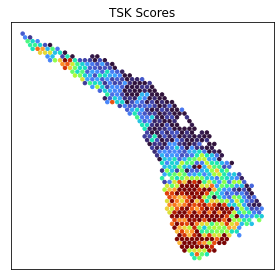

/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:23: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox_layout" which is no longer supported as of 3.3 and will become an error two minor releases later


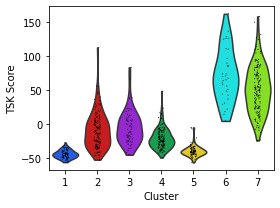

In [25]:
fig, ax = plt.subplots(1,1, figsize=(4, 4)) 
spatialcorr.plot_slide(
    df_meta_ts, 
    tsk_scores, 
    cmap='turbo',
    colorbar=False,
    title="TSK Scores",
    dsize=12,
    vmin=np.quantile(tsk_scores, 0.1),
    vmax=np.quantile(tsk_scores, 0.9),
    ax=ax,
    figure=fig,
    ticks=False
)
plt.tight_layout()
fig.savefig('./figures_V2/Patient_4_TSK_Scores_heatmap.pdf', format='pdf')
plt.show()

fig, ax = plt.subplots(1,1, figsize=(4, 3))
sc.pl.violin(adata_zs, keys='TSK Score', groupby='BayesSpace_11', log=False, palette=spatialcorr.plot.PALETTE_MANY, ax=ax, show=False)
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures_V2/Patient_4_TSK_Scores_violin.pdf', bbox_layout='tight', format='pdf')
#plt.show()

#sc.pl.violin(adata_zs, keys='TSK Score', groupby='BayesSpace_11', log=False)
#plt.show()

Trying to set attribute `.obs` of view, copying.


Text(0, 0.5, 'Correlation')

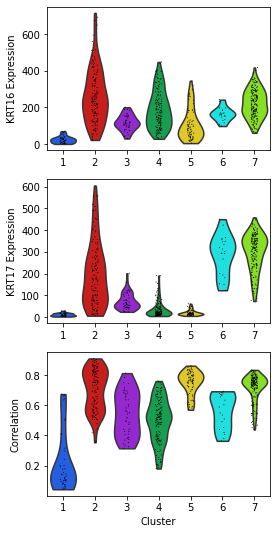

In [22]:
adata_keep = adata.copy()
corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
    adata, 
    'KRT17', 'KRT16',
    kernel_matrix=None, 
    row_key='row', 
    col_key='col', 
    condition='BayesSpace_11', 
    sigma=5,
    contrib_thresh=10
)
adata_keep = adata_keep[keep_inds,:]
adata_keep.obs['Correlation KRT16 & KRT6B'] = corrs

fig, axarr = plt.subplots(3,1, figsize=(4, 9))
cust_pal = np.array(spatialcorr.plot.PALETTE_MANY)[
    [0, 1, 2, 3, 4, 5, 6, 7, 9, 10]
]
sc.pl.violin(
    adata_keep, 
    'KRT16', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[0], 
    show=False
)
sc.pl.violin(
    adata_keep, 
    'KRT17', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[1], 
    show=False
)
sc.pl.violin(
    adata_keep, 
    'Correlation KRT16 & KRT6B', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[2], 
    show=False
)

axarr[0].set_xlabel('')
axarr[1].set_xlabel('')
axarr[2].set_xlabel('Cluster')
axarr[0].set_ylabel('KRT16 Expression')
axarr[1].set_ylabel('KRT17 Expression')
axarr[2].set_ylabel('Correlation')
#plt.show()

#plt.tight_layout()
#fig.savefig('./figures/P6_KRT16_KRT6B_expression_corr_distr_violin.pdf', bbox_layout='tight', format='pdf')

Trying to set attribute `.X` of view, copying.


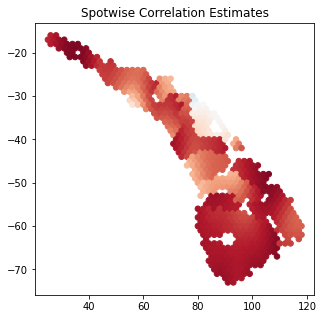

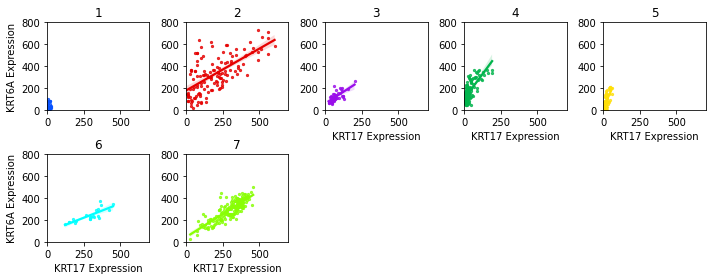

Trying to set attribute `.X` of view, copying.


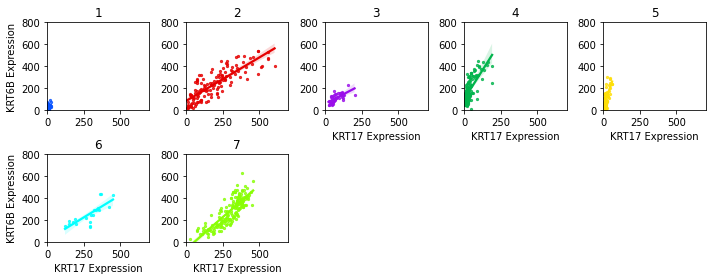

Trying to set attribute `.X` of view, copying.


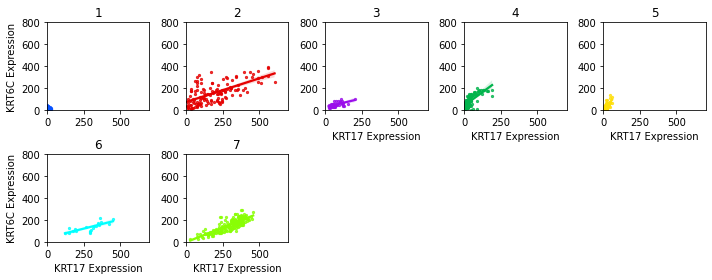

Trying to set attribute `.X` of view, copying.


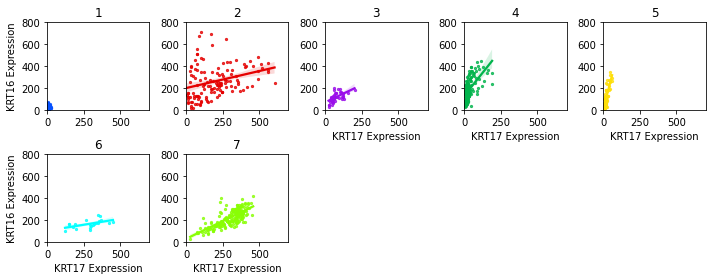

In [18]:
corrs, kept_inds_fig, _ = spatialcorr.plot.plot_correlation(
    adata,
    'KRT17', 'KRT6C',
    sigma=5,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace',
    cmap='RdBu_r',
    colorbar=False,
    ticks=True,
    #ax=ax,
    #figure=None,
    estimate='local',
    dsize=30,
    title='Spotwise Correlation Estimates'
);
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT6A',
    adata[kept_inds_fig,:],
    'BayesSpace',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,700),
    ylim=(0,800),
    fig_path='./figures/P4_KRT17_KRT6A_region_scatters.pdf',
    fig_format='pdf',
    fig_dpi=150
)
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT6B',
    adata[kept_inds_fig,:],
    'BayesSpace',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,700),
    ylim=(0,800),
    fig_path='./figures/P4_KRT17_KRT6B_region_scatters.pdf',
    fig_format='pdf',
    fig_dpi=150
)
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT6C',
    adata[kept_inds_fig,:],
    'BayesSpace',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,700),
    ylim=(0,800),
    fig_path='./figures/P4_KRT17_KRT6C_region_scatters.pdf',
    fig_format='pdf',
    fig_dpi=150
)
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT16',
    adata[kept_inds_fig,:],
    'BayesSpace',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,700),
    ylim=(0,800),
    fig_path='./figures/P4_KRT17_KRT16_region_scatters.pdf',
    fig_format='pdf',
    fig_dpi=150
)

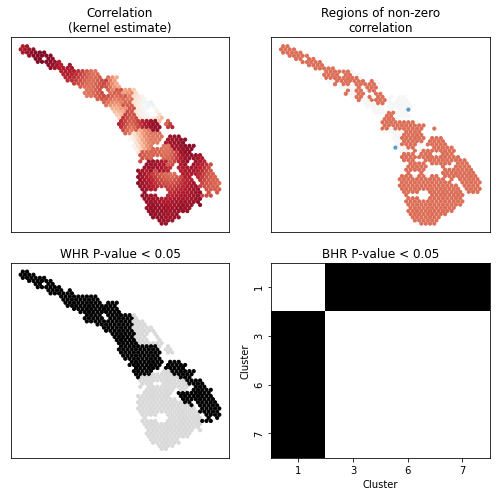

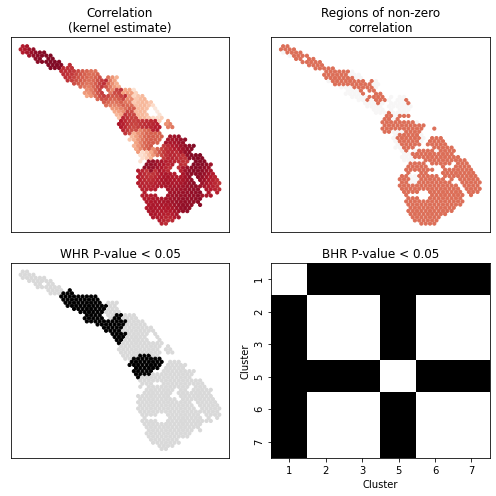

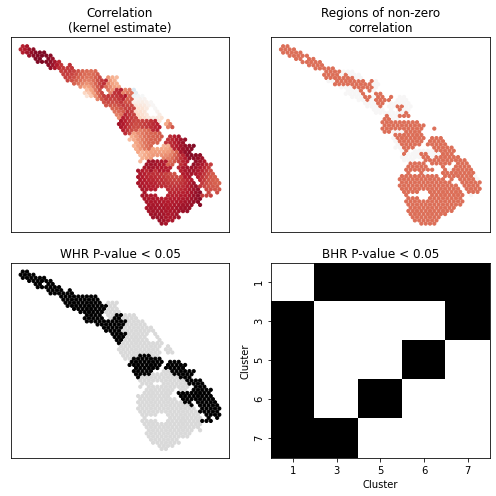

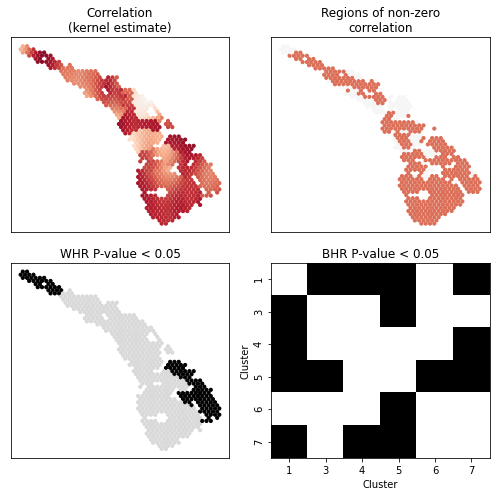

In [20]:
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6A',  
    adata,
    5,
    'BayesSpace',                
    max_perms=1000,
    dsize=10,
    verbose=0,
    only_stats=True,
    fig_path='./figures/P4_KRT17_KRT6A_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6B',  
    adata,
    5,
    'BayesSpace',                
    max_perms=1000,
    dsize=10,
    verbose=0,
    only_stats=True,
    fig_path='./figures/P4_KRT17_KRT6B_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6C',  
    adata,
    5,
    'BayesSpace',                
    max_perms=1000,
    dsize=10,
    verbose=0,
    only_stats=True,
    fig_path='./figures/P4_KRT17_KRT6C_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT16',  
    adata,
    5,
    'BayesSpace',                
    max_perms=1000,
    dsize=10,
    verbose=0,
    only_stats=True,
    fig_path='./figures/P4_KRT17_KRT16_pairwise_analysis.pdf',
    fig_format='pdf'
)

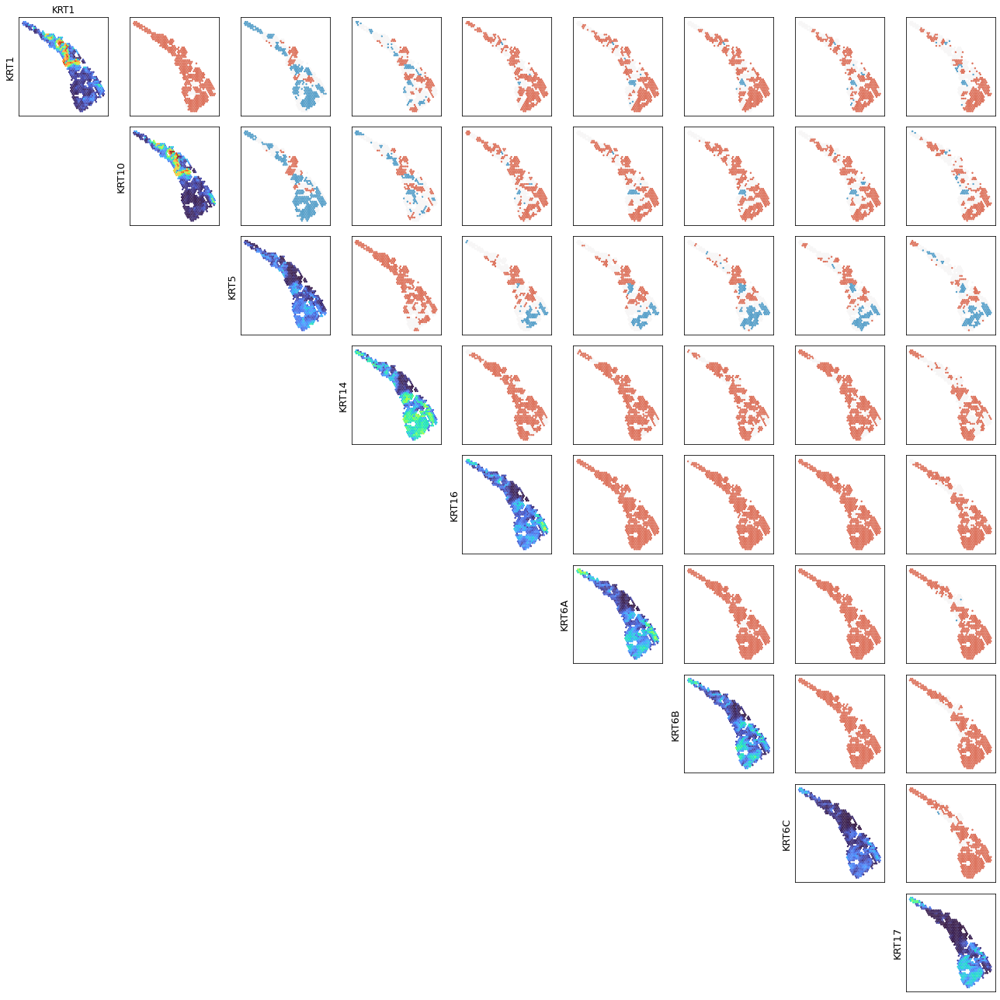

In [21]:
spatialcorr.plot.mult_genes_plot_correlation(
    [
        "KRT1",
        "KRT10",
        "KRT5",
        "KRT14",
        "KRT16",
        "KRT6A",
        "KRT6B",
        "KRT6C",
        "KRT17"
    ],
    adata,
    'BayesSpace_11',
    dsize=2,
    estimate_type='local_ci',
    fig_path='./figures_V2/P4_keratin_corr_heatmaps_ci.pdf',
    fig_format='pdf'
)

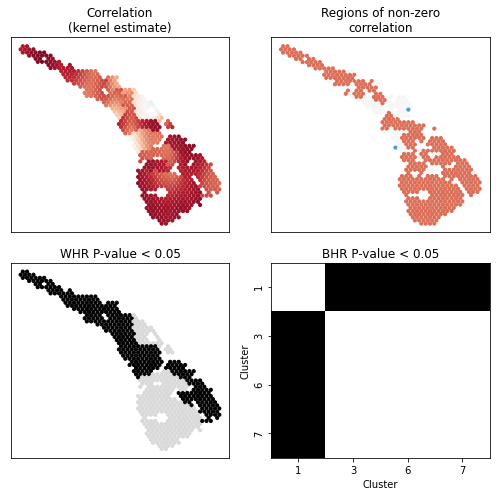

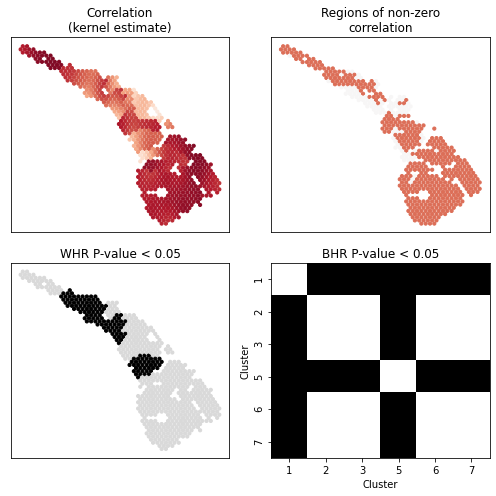

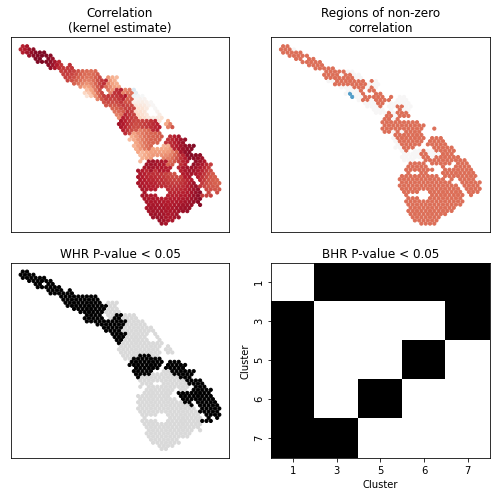

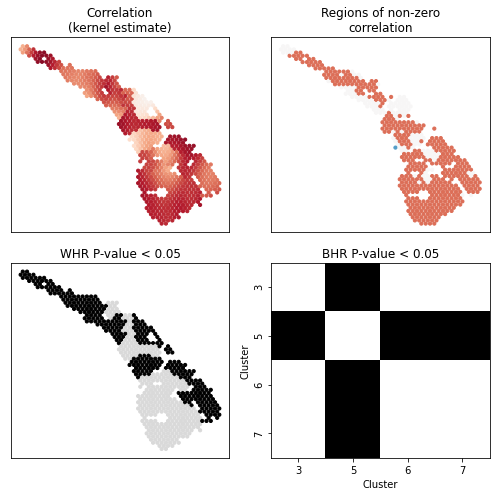

In [28]:
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6A',  
    adata,
    5,
    'BayesSpace_11',                
    max_perms=1000,
    dsize=10,
    verbose=0,
    only_stats=True,
    fig_path='./figures_V2/P4_KRT17_KRT6A_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6B',  
    adata,
    5,
    'BayesSpace_11',                
    max_perms=1000,
    dsize=10,
    verbose=0,
    only_stats=True,
    fig_path='./figures_V2/P4_KRT17_KRT6B_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT6C',  
    adata,
    5,
    'BayesSpace_11',                
    max_perms=1000,
    dsize=10,
    verbose=0,
    only_stats=True,
    fig_path='./figures_V2/P4_KRT17_KRT6C_pairwise_analysis.pdf',
    fig_format='pdf'
)
spatialcorr.analysis_pipeline_pair(
    'KRT17', 'KRT16',  
    adata,
    5,
    'BayesSpace_11',                
    max_perms=1000,
    dsize=10,
    verbose=0,
    only_stats=True,
    fig_path='./figures_V2/P4_KRT17_KRT16_pairwise_analysis.pdf',
    fig_format='pdf'
)

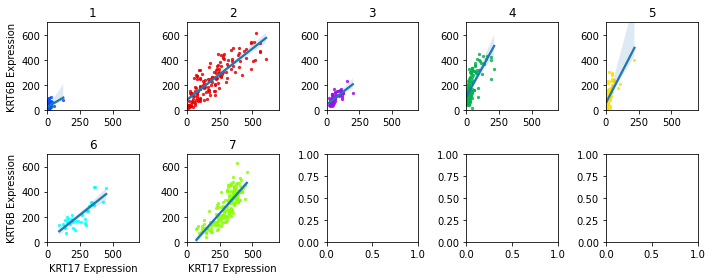

In [24]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT6B',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,700),
    ylim=(0,700)
)

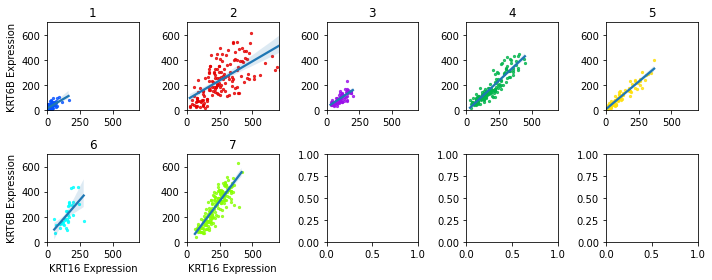

In [23]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT6B',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,700),
    ylim=(0,700)
)

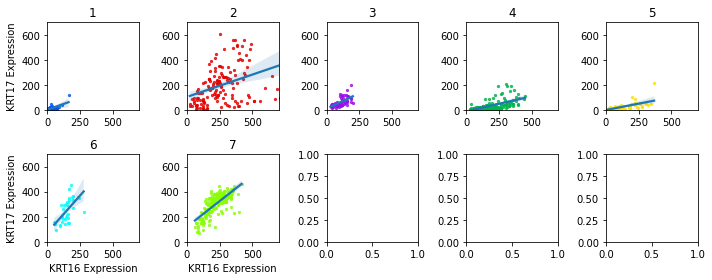

In [11]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT17',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    ylim=(0,700),
    xlim=(0,700)
)

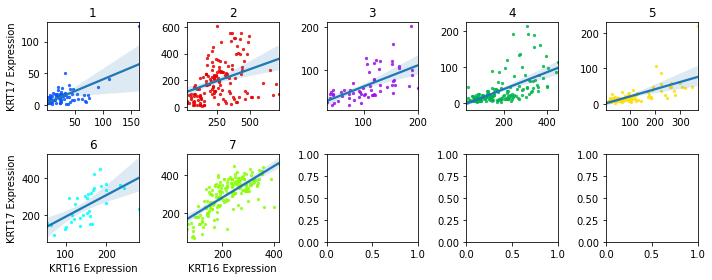

In [27]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT16',
    'KRT17',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

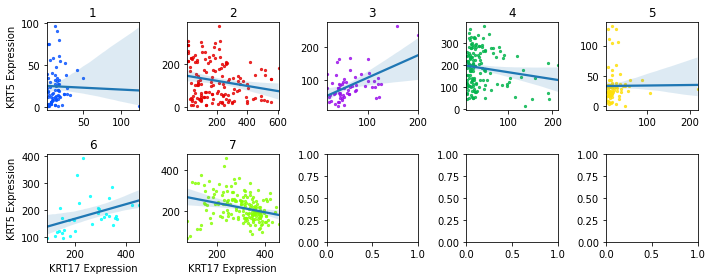

In [32]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT17',
    'KRT5',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

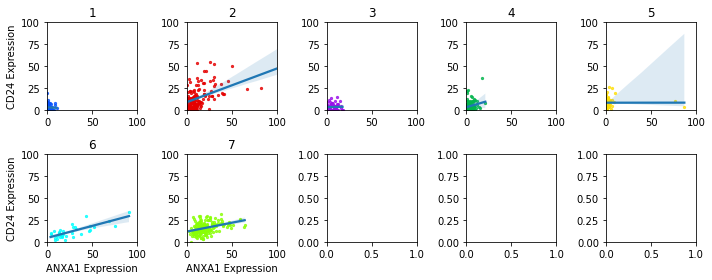

In [18]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'ANXA1',
    'CD24',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,100),
    ylim=(0,100)
)

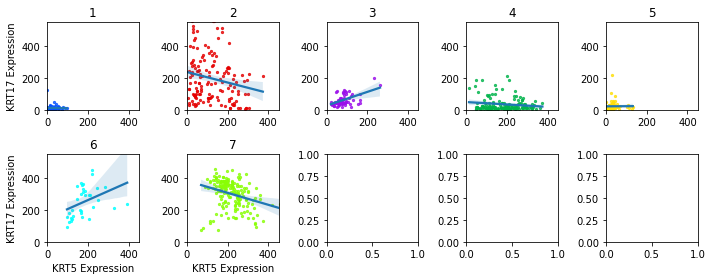

In [15]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'KRT5',
    'KRT17',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col',
    xlim=(0,450),
    ylim=(0,550)
)

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attrib

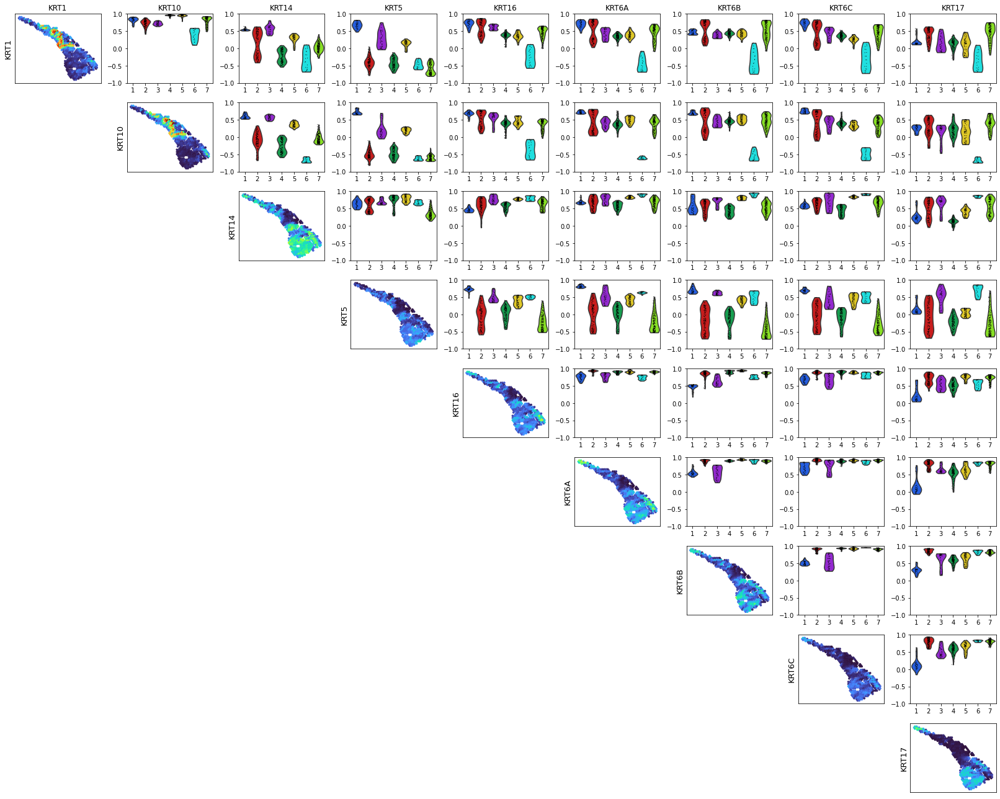

In [10]:

def draw_violin_corrs(g1, g2, ax, ylabel='', title=''):
    cust_pal = np.array(spatialcorr.plot.PALETTE_MANY)[
        [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11]
    ]
    
    adata_keep = adata.copy()
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata, 
        g1, g2,
        kernel_matrix=None, 
        row_key='row', 
        col_key='col', 
        condition='BayesSpace', 
        sigma=5,
        contrib_thresh=10
    )
    adata_keep = adata_keep[keep_inds,:]
    adata_keep.obs[f'Correlation {g1} & {g2}'] = corrs

    
    sc.pl.violin(
        adata_keep, 
        f'Correlation {g1} & {g2}', 
        groupby='BayesSpace', 
        palette=cust_pal, 
        ax=ax, 
        show=False
    )
    ax.set_ylim((-1,1))

    if ylabel is not None:
        ax.set_ylabel(ylabel)
    if title is not None:
        ax.set_title(title)
    ax.set_xlabel('')


def plot_pairwise_violins(
        plot_genes,
        cond_key,
        bandwidth=5,
        precomputed_kernel=None,
        contrib_thresh=10,
        estimate_type='local',
        row_key='row',
        col_key='col',
        dsize=7,
        fig_path=None,
        fig_format='png',
        fig_dpi=150
    ):
    condition = cond_key is not None
    kernel_matrix = spatialcorr.statistical_test._compute_kernel_matrix(
        adata.obs,
        sigma=bandwidth,
        cell_type_key=cond_key,
        condition_on_cell_type=condition,
        y_col=row_key,
        x_col=col_key
    )
    
    # Compute kept indices
    corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
        adata,
        plot_genes[0], plot_genes[1],
        kernel_matrix=kernel_matrix,
        row_key=row_key,
        col_key=col_key,
        condition=cond_key,
        sigma=bandwidth,
        contrib_thresh=contrib_thresh
    )

    # Filter kernel matrix, if it's provided
    kernel_matrix = kernel_matrix[keep_inds,:]
    kernel_matrix = kernel_matrix[:,keep_inds]

    
    # Get range of expression values for colormap
    # of expression
    all_expr = []
    for gene in plot_genes:
        expr = adata[keep_inds,:].obs_vector(gene)
        all_expr += list(expr)
    min_expr = min(all_expr)
    max_expr = max(all_expr)
    
    fig, axarr = plt.subplots(
        len(plot_genes),
        len(plot_genes),
        figsize=(2.5*len(plot_genes),2*len(plot_genes))
    )

    for row, ax_row in enumerate(axarr):
        for col, ax in enumerate(ax_row):
            gene_1 = plot_genes[row]
            gene_2 = plot_genes[col]

            if row == 0:
                title = gene_2
            else:
                title = None

            if col == row:
                spatialcorr.plot.plot_slide(
                    adata[keep_inds,:].obs,
                    adata[keep_inds,:].obs_vector(gene_1),
                    cmap='turbo',
                    title=title,
                    dsize=dsize,
                    ax=ax,
                    figure=fig,
                    ticks=False,
                    vmin=min_expr,
                    vmax=max_expr,
                    row_key=row_key,
                    col_key=col_key
                )
                ax.set_ylabel(gene_1, fontsize=13)
            elif col > row:
                ylabel=''
                if col == 0:
                    ylabel = gene_1
                title = ''
                if row == 0:
                    title = gene_2
                draw_violin_corrs(gene_1, gene_2, ax, ylabel=ylabel, title=title)
            else:
                ax.set_visible(False)

    plt.tight_layout()
    fig.savefig('./figures/P4_pairwise_corr_distr_violin_matrix.pdf', bbox_layout='tight', format='pdf')
    fig.savefig('./figures/P4_pairwise_corr_distr_violin_matrix.png', bbox_layout='tight', format='png', dpi=150)
    
plot_genes = ['KRT1', 'KRT10', 'KRT14', 'KRT5', 'KRT16', 'KRT6A', 'KRT6B', 'KRT6C', 'KRT17']
plot_pairwise_violins(plot_genes, cond_key='BayesSpace')

Kept 642/733 spots.


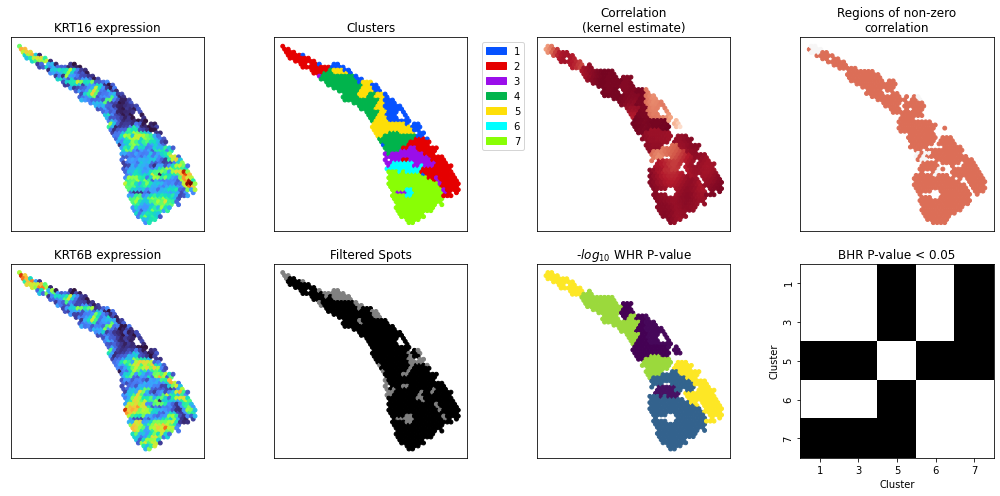

In [22]:
spatialcorr.analysis_pipeline_pair(
    'KRT16',            
    'KRT6B',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=15,           
    verbose=0
)

Kept 642/733 spots.


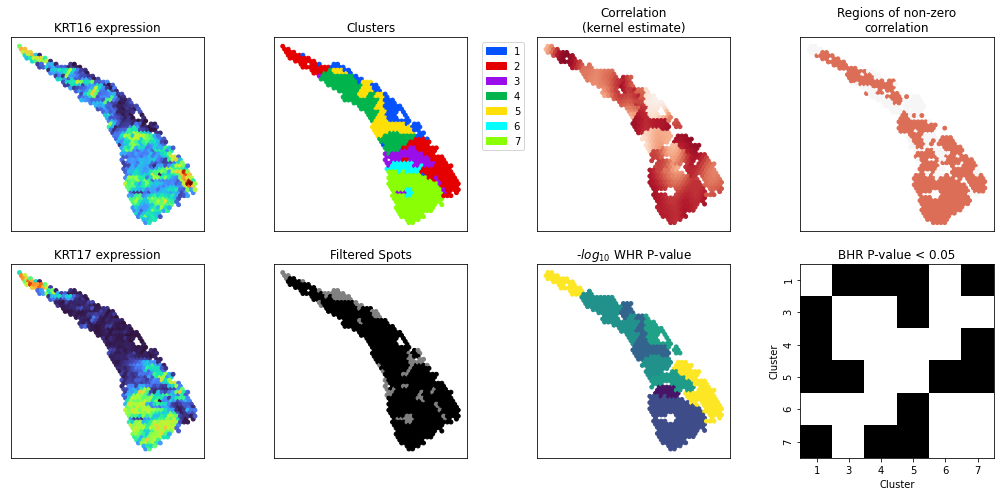

In [26]:
spatialcorr.analysis_pipeline_pair(
    'KRT16',            
    'KRT17',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=15,           
    verbose=0
)

Kept 642/733 spots.


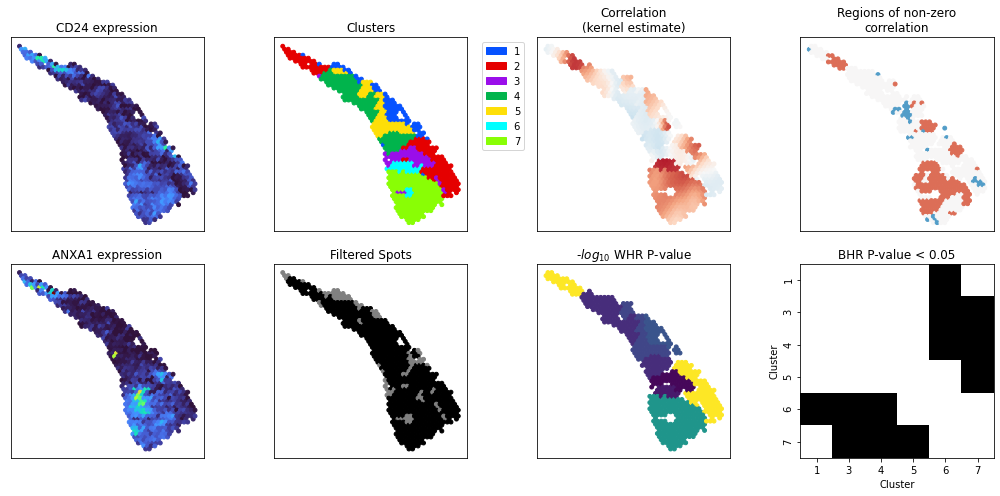

In [24]:
spatialcorr.analysis_pipeline_pair(
    'CD24',            
    'ANXA1',            
    adata,              
    bandwidth=5,        
    cond_key='BayesSpace_11', 
    max_perms=100,      
    dsize=15,           
    verbose=0
)

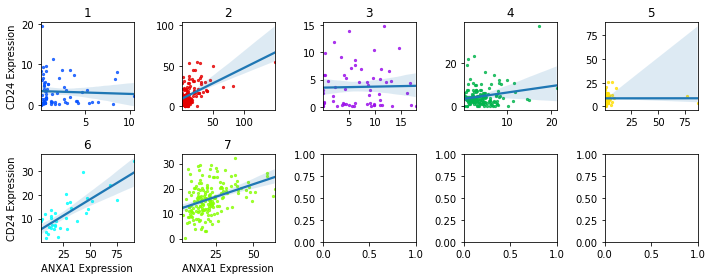

In [10]:
spatialcorr.plot.cluster_pairwise_scatterplots(
    'ANXA1',
    'CD24',
    adata,
    'BayesSpace_11',
    sigma=5,
    row_key='row',
    col_key='col'
)

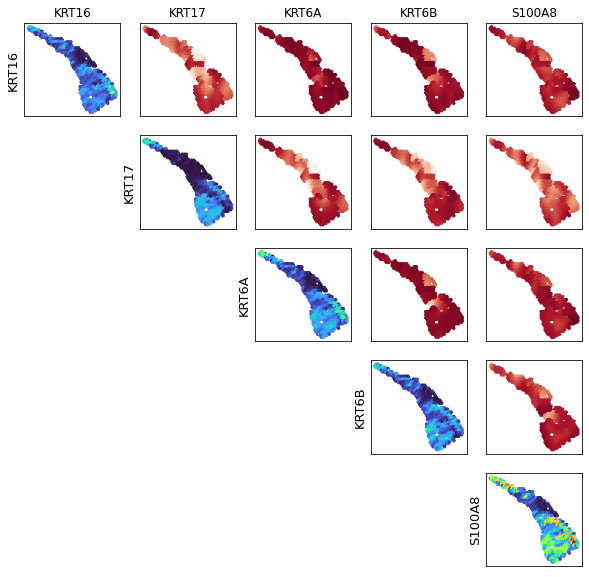

In [25]:
spatialcorr.plot.mult_genes_plot_correlation(
    ['KRT16', 'KRT17', 'KRT6A', 'KRT6B', 'S100A8'],
    adata,
    'BayesSpace_11',
    estimate_type='local'
)

In [23]:
def plot_within(g1, g2, condition='BayesSpace_11', sigma=5, dsize=10, ax=None, figure=None):
    plot_gene(g1, adata, cmap='turbo')
    plot_gene(g2, adata, cmap='turbo')
    corrs, kept_inds, _ = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        sigma=sigma,
        contrib_thresh=10,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition=condition,
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        ax=ax,
        figure=figure,
        estimate='local',
        dsize=dsize
    )
    #plt.show()
    return corrs, kept_inds

def plot_between(g1, g2, condition='BayesSpace_11'):
    plot_gene(g1, adata, cmap='turbo')
    plot_gene(g2, adata, cmap='turbo')
    corrs, kept_inds = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition=condition,
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        ax=None,
        figure=None,
        estimate='regional'
    )
    plt.show()
    return corrs, kept_inds

def run_full_analysis_pairwise(
        g1, 
        g2, 
        sigma=5, 
        max_perms=500, 
        n_procs=5, 
        test_between=False, 
        spot_to_neighbors=None, 
        spot_to_neighbors_clust=None
    ):
    plot_within(g1, g2, sigma=sigma);
    plt.show()

    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, clust_to_p_val = spatialcorr.run_test(
        adata,
        [g1, g2],
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=n_procs,
        test_between_conds=test_between,
        compute_spotwise_pvals=True,
        max_perms=max_perms,
        mc_pvals=False,
        spot_to_neighbors=spot_to_neighbors_clust
    )
    print("P-value: ", p_val)
    
    n_sig_0_05 = len([x for x in spot_p_vals if x < 0.05])
    print("Number of spotwise p-values < 0.05: ", n_sig_0_05)
    
    max_val = np.quantile([abs(x) for x in obs_spot_lls], 0.8)
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        obs_spot_lls, 
        cmap='PRGn',
        colorbar=True,
        dsize=13,
        vmin=-1*np.log(2),
        vmax=np.log(2),
        title='Log-likelihood ratios'
    )
    plt.show()
    
    #print("Mean p-value: ", np.mean(spot_p_vals))
    #sns.histplot(-1 * np.log10(spot_p_vals))
    #plt.show()
    
    #llrtp.plot_slide(
    #    adata.obs.iloc[kept_inds], 
    #    spot_p_vals, 
    #    cmap='viridis_r',
    #    colorbar=True,
    #    #vmin=0,
    #    #vmax=-1 * np.log10(1/max_perms),
    #    dsize=13,
    #    title='p-value'
    #)
    #plt.show()
    
    llrtp.plot_slide(
        adata.obs.iloc[kept_inds], 
        -1 * np.log10(spot_p_vals), 
        cmap='viridis',
        colorbar=True,
        #vmin=0,
        #vmax=-1 * np.log10(1/max_perms),
        dsize=13,
        title=r'$-log_{10}$ p-value'
    )
    plt.show()
    
    #cs_pvals = compute_spotwise_significance(
    #    adata.obs.iloc[kept_inds], 
    #    spot_p_vals
    #)
    #cs_pvals_fdr, _, _, _ = multipletests(
    #    cs_pvals, 
    #    method='fdr_bh',
    #    alpha=0.05
    #)

    #llrtp.plot_slide(
    #    adata.obs.iloc[kept_inds], 
    #    cs_pvals_fdr, 
    #    cmap='categorical',
    #    colorbar=True,
    #    vmin=0,
    #    vmax=1,
    #    dsize=20
    #)
    #plt.show()
    
    #return cs_pvals_fdr, kept_inds

def run_full_analysis_gene_set(genes, sigma=5, test_between=False, n_perms=100):
    #plot_within(g1, g2);
    #plt.show()

    
    
    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, clust_to_p_val = spatialcorr.run_test(
        adata,
        genes,
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=5,
        test_between_conds=False,
        compute_spotwise_pvals=True,
        max_perms=n_perms
    )
    print("P-value: ", p_val)
    
    print(clust_to_p_val)
    
    run_regions = [
        ct 
        for ct, p_val in clust_to_p_val.items()
        if p_val >= 0.05
    ]
    if len(run_regions) > 1:
    
        ct_to_ct_to_pval = spatialcorr.run_test_between_region_pairs(
            adata,
            genes,
            sigma,
            'BayesSpace_11',
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            verbose=1,
            n_procs=1,
            standardize_var=False,
            max_perms=n_perms,
            mc_pvals=True,
            spot_to_neighbors=None,
            run_regions=run_regions
        )
        da = []
        for ct_1 in sorted(set(ct_to_ct_to_pval.keys())):
            row = []
            for ct_2 in sorted(set(ct_to_ct_to_pval.keys())):
                if ct_1 == ct_2:
                    row.append(False)
                else:
                    row.append(ct_to_ct_to_pval[ct_1][ct_2] < 0.05)
            da.append(row)
        df_plot = pd.DataFrame(
            data=da,
            columns=sorted(set(ct_to_ct_to_pval.keys())),
            index=sorted(set(ct_to_ct_to_pval.keys()))
        )
        fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
        res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
        for _, spine in res.spines.items():
            spine.set_visible(True)
        ax.set_title('BHR P-value < 0.05')
        ax.set_ylabel('Cluster')
        ax.set_xlabel('Cluster')
        plt.tight_layout()
        plt.show()
    
    #return cs_pvals_fdr, kept_inds

In [18]:
def full_analysis_pair_2(
        g1, 
        g2, 
        sigma=5, 
        max_perms=500, 
        n_procs=5, 
        test_between=False, 
        spot_to_neighbors=None, 
        spot_to_neighbors_clust=None
    ):
    fig, axarr = plt.subplots(
        2,
        4,
        figsize=(14,7)
    )  
    
    expr_1 = adata.obs_vector(g1)
    expr_2 = adata.obs_vector(g2)
    min_expr = min(list(expr_1) + list(expr_2))
    max_expr = max(list(expr_1) + list(expr_2))
        
    spatialcorr.plot_slide(
        adata.obs,
        expr_1,
        cmap='turbo',
        colorbar=False,
        vmin=min_expr,
        vmax=max_expr,
        title=f'{g1} expression',
        ax=axarr[0][0],
        figure=None,
        ticks=False,
        dsize=12,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    spatialcorr.plot_slide(
        adata.obs,
        expr_2,
        cmap='turbo',
        colorbar=False,
        vmin=min_expr,
        vmax=max_expr,
        title=f'{g2} expression',
        ax=axarr[1][0],
        figure=None,
        ticks=False,
        dsize=12,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    spatialcorr.plot_slide(
        adata.obs,
        adata.obs['BayesSpace_11'],
        cmap='categorical',
        colorbar=True,
        vmin=min_expr,
        vmax=max_expr,
        title=f'Clusters',
        ax=axarr[1][1],
        figure=None,
        ticks=False,
        dsize=12,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
    if test_between:
        spatialcorr.plot_correlation(
            adata,
            g1,
            g2,
            sigma=5,
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=False,
            ticks=False,
            ax=axarr[0][1],
            figure=fig,
            dsize=12,
            estimate='regional',
            title='Correlation\n(cluster estimate)'
        )
    else:
        spatialcorr.plot_correlation(
            adata,
            g1,
            g2,
            sigma=5,
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=False,
            ticks=False,
            ax=axarr[0][1],
            figure=fig,
            dsize=12,
            estimate='local',
            title='Correlation\n(kernel estimate)'
        )
    
    if test_between:
        bin_corrs = corr_pos_neg_by_cluster(g1, g2, adata)
        keep_inds = np.arange(adata.shape[0])
    else:
        bin_corrs, keep_inds = corr_pos_neg(
            g1, g2, 
            adata, 
            neigh_thresh=10, 
            bc_to_neighs=spot_to_neighbors
        )
    spatialcorr.plot_slide(
        adata.obs.iloc[keep_inds],
        bin_corrs,
        cmap='RdBu_r',
        colorbar=False,
        vmin=-1.8,
        vmax=1.8,
        title=f'Regions of non-zero\ncorrelation',
        ax=axarr[0][2],
        figure=None,
        ticks=False,
        dsize=12,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
    p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, clust_to_p_val = spatialcorr.run_test(
        adata,
        [g1, g2],
        sigma,
        cond_key='BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=n_procs,
        test_between_conds=test_between,
        compute_spotwise_pvals=True,
        max_perms=max_perms,
        mc_pvals=False,
        spot_to_neighbors=spot_to_neighbors_clust
    )
    
    spot_p_vals = [
        clust_to_p_val[ct]
        for ct in adata.obs.iloc[kept_inds]['BayesSpace_11']
    ]
    
    print(f"P-value: {p_val}")
    spatialcorr.plot_slide(
        adata.obs.iloc[kept_inds],
        -1 * np.log10(spot_p_vals),
        cmap='viridis',
        colorbar=False,
        vmin=0,
        vmax=-1 * np.log10(1/max_perms),
        title=r'-$log_{10}$ p-value',
        ax=axarr[1][2],
        figure=None,
        ticks=False,
        dsize=12,
        colorticks=None,
        row_key='row',
        col_key='col'
    )
    
    run_regions = [
        ct 
        for ct, p_val in clust_to_p_val.items()
        if p_val >= 0.05
    ]
    
    df_plot = pairwise_clust_between([g1, g2], run_regions=run_regions, max_perms=max_perms)
    res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=axarr[0][3])
    for _, spine in res.spines.items():
        spine.set_visible(True)
    axarr[0][3].set_title('BHR P-value < 0.05')
    axarr[0][3].set_ylabel('Cluster')
    axarr[0][3].set_xlabel('Cluster')
    
    axarr[1][3].set_visible(False)
    
    plt.tight_layout()
    
    

In [19]:
row_col_to_barcode = spatialcorr.utils.map_row_col_to_barcode(
    adata.obs,
    row_key='row',
    col_key='col'
)
bc_to_neighs = spatialcorr.utils.compute_neighbors(
    adata.obs,
    row_col_to_barcode,
    row_key='row',
    col_key='col',
    rad=3
)

In [20]:
clust_to_bcs = defaultdict(lambda: [])
for bc, clust in zip(adata.obs.index, adata.obs['BayesSpace_11']):
    clust_to_bcs[clust].append(bc)   
bc_to_index = {
    bc: bc_i
    for bc_i, bc in enumerate(adata.obs.index)
}
clust_to_indices = {
    clust: [bc_to_index[bc] for bc in bcs]
    for clust, bcs in clust_to_bcs.items()
}
bc_to_clust = {
    bc: clust
    for bc, clust in zip(adata.obs.index, adata.obs['BayesSpace_11'])
}
bc_to_neighs_clust_cond = {}
for bc, neighs in bc_to_neighs.items():
    curr_clust = bc_to_clust[bc]
    new_neighs = [
        x 
        for x in neighs
        if bc_to_clust[x] == curr_clust
    ]
    #print(new_neighs)
    bc_to_neighs_clust_cond[bc] = new_neighs
    
bc_to_neighs_full_clust = {
    bc: [adata.obs.index[ind] for ind in clust_to_indices[bc_to_clust[bc]]]
    for bc in bc_to_neighs_clust_cond
}

In [21]:

def local_spearman(g1, g2, ad, neigh_thresh=10, bc_to_neighs=None, corr_type='spearman'):
    expr_1 = ad.obs_vector(g1)
    expr_2 = ad.obs_vector(g2)
    if bc_to_neighs is None:
        row_col_to_barcode = spatialcorr.utils.map_row_col_to_barcode(
            ad.obs,
            row_key='row',
            col_key='col'
        )
        bc_to_neighs = spatialcorr.utils.compute_neighbors(
            ad.obs,
            row_col_to_barcode,
            row_key='row',
            col_key='col',
            rad=3
        )
    
    clust_to_bcs = defaultdict(lambda: set())
    for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11']):
        clust_to_bcs[clust].add(bc)
                             
    bc_to_clust = {
        bc: clust
        for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11'])
    }
    keep_inds = []
    corrs = []
    bc_to_ind = {
        bc: bc_i
        for bc_i, bc in enumerate(ad.obs.index)
    }
    for bc_i, bc in enumerate(ad.obs.index):
        #if bc_i % 50 == 0:
        #    print(f"Spot {bc_i}...")
        neighs = bc_to_neighs[bc]
        curr_clust = bc_to_clust[bc]
        neighs = sorted(set(neighs) & clust_to_bcs[curr_clust])
        if len(neighs) < neigh_thresh:
            continue
        keep_inds.append(bc_i)
        neigh_inds = [bc_to_ind[x] for x in neighs]
        expr_1_neigh = expr_1[neigh_inds]
        expr_2_neigh = expr_2[neigh_inds]
        if corr_type == 'spearman':
            corr, _ = spearmanr(expr_1_neigh, expr_2_neigh)
        elif corr_type == 'pearson':
            corr, _ = pearsonr(expr_1_neigh, expr_2_neigh)
        corrs.append(corr)
    return corrs, keep_inds

In [22]:
def est_corr_cis(g1, g2, ad, kernel_matrix, cond_key, neigh_thresh=10, bc_to_neighs=None, n_boots=100, mag=0):
    expr_1 = ad.obs_vector(g1)
    expr_2 = ad.obs_vector(g2)
    if bc_to_neighs is None:
        row_col_to_barcode = spatialcorr.utils.map_row_col_to_barcode(
            ad.obs,
            row_key='row',
            col_key='col'
        )
        bc_to_neighs = spatialcorr.utils.compute_neighbors(
            ad.obs,
            row_col_to_barcode,
            row_key='row',
            col_key='col',
            rad=3
        )
    
    clust_to_bcs = defaultdict(lambda: set())
    for bc, clust in zip(ad.obs.index, ad.obs[cond_key]):
        clust_to_bcs[clust].add(bc)
                             
    bc_to_clust = {
        bc: clust
        for bc, clust in zip(ad.obs.index, ad.obs[cond_key])
    }
    keep_inds = []
    bin_corrs = []
    bc_to_ind = {
        bc: bc_i
        for bc_i, bc in enumerate(ad.obs.index)
    }
    cis = []
    for bc_i, bc in enumerate(ad.obs.index):
        neighs = bc_to_neighs[bc]
        neighs = set(neighs) | set([bc]) # Add current spot
        curr_clust = bc_to_clust[bc]
        neighs = sorted(set(neighs) & clust_to_bcs[curr_clust])
        if len(neighs) < neigh_thresh:
            continue
        keep_inds.append(bc_i)
        neigh_inds = [bc_to_ind[x] for x in neighs]
        
        weights_neigh = kernel_matrix[bc_i][neigh_inds]
        expr_1_neigh = expr_1[neigh_inds]
        expr_2_neigh = expr_2[neigh_inds]
        
        boot_corrs = []
        for i in range(n_boots): 
            boot_inds = np.random.choice(
                np.arange(len(expr_1_neigh)), 
                size=len(expr_1_neigh), 
                replace=True
            )
            e_1_boot = expr_1_neigh[boot_inds]
            e_2_boot = expr_2_neigh[boot_inds]
            weights_boot = weights_neigh[boot_inds]
            
            mean_1_boot = sum(e_1_boot * weights_boot) / sum(weights_boot)
            mean_2_boot = sum(e_2_boot * weights_boot) / sum(weights_boot)
            var_1_boot = sum( np.power((e_1_boot - mean_1_boot), 2) * weights_boot) / sum(weights_boot)
            var_2_boot = sum( np.power((e_1_boot - mean_2_boot), 2) * weights_boot) / sum(weights_boot)
            cov_boot = sum( (e_1_boot - mean_1_boot) * (e_2_boot - mean_2_boot) * weights_boot) / sum(weights_boot)
            corr_boot = cov_boot / np.sqrt(var_1_boot * var_2_boot)
            
            boot_corrs.append(corr_boot)
        boot_corrs = sorted(boot_corrs)
        cis.append((boot_corrs[5], boot_corrs[95]))
        
    return cis, keep_inds

In [23]:
def corr_pos_neg(g1, g2, ad, neigh_thresh=10, bc_to_neighs=None, corr_type='spearman'):
    expr_1 = ad.obs_vector(g1)
    expr_2 = ad.obs_vector(g2)
    if bc_to_neighs is None:
        row_col_to_barcode = spatialcorr.utils.map_row_col_to_barcode(
            ad.obs,
            row_key='row',
            col_key='col'
        )
        bc_to_neighs = spatialcorr.utils.compute_neighbors(
            ad.obs,
            row_col_to_barcode,
            row_key='row',
            col_key='col',
            rad=3
        )
    
    clust_to_bcs = defaultdict(lambda: set())
    for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11']):
        clust_to_bcs[clust].add(bc)
                             
    bc_to_clust = {
        bc: clust
        for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11'])
    }
    keep_inds = []
    bin_corrs = []
    bc_to_ind = {
        bc: bc_i
        for bc_i, bc in enumerate(ad.obs.index)
    }
    for bc_i, bc in enumerate(ad.obs.index):
        neighs = bc_to_neighs[bc]
        curr_clust = bc_to_clust[bc]
        neighs = sorted(set(neighs) & clust_to_bcs[curr_clust])
        if len(neighs) < neigh_thresh:
            continue
        keep_inds.append(bc_i)
        neigh_inds = [bc_to_ind[x] for x in neighs]
        expr_1_neigh = expr_1[neigh_inds]
        expr_2_neigh = expr_2[neigh_inds]
        
        boot_corrs = []
        for i in range(100): 
            boot_inds = np.random.choice(np.arange(len(expr_1_neigh)), size=len(expr_1_neigh), replace=True)
            e_1_boot = expr_1_neigh[boot_inds]
            e_2_boot = expr_2_neigh[boot_inds]
            corr_boot, _ = pearsonr(e_1_boot, e_2_boot)
            boot_corrs.append(corr_boot)
        boot_corrs = sorted(boot_corrs)
        #print(boot_corrs)
        if 0 > boot_corrs[95]:
            bin_corrs.append(-1)
        elif 0 < boot_corrs[5]:
            bin_corrs.append(1)
        else:
            bin_corrs.append(0)
    return bin_corrs, keep_inds

def corr_pos_neg_by_cluster(g1, g2, ad):
    expr_1 = ad.obs_vector(g1)
    expr_2 = ad.obs_vector(g2)
    
    
    clust_to_bcs = defaultdict(lambda: set())
    for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11']):
        clust_to_bcs[clust].add(bc)
                             
    bc_to_clust = {
        bc: clust
        for bc, clust in zip(ad.obs.index, ad.obs['BayesSpace_11'])
    }
    keep_inds = []
    bin_corrs = []
    bc_to_ind = {
        bc: bc_i
        for bc_i, bc in enumerate(ad.obs.index)
    }
    
    clust_to_boot = {}
    for clust, clust_bcs in clust_to_bcs.items():
        clust_inds = [bc_to_ind[x] for x in clust_bcs]
        expr_1_clust = expr_1[clust_inds]
        expr_2_clust = expr_2[clust_inds]
        
        boot_corrs = []
        for i in range(100): 
            boot_inds = np.random.choice(np.arange(len(expr_1_clust)), size=len(expr_1_clust), replace=True)
            e_1_boot = expr_1_clust[boot_inds]
            e_2_boot = expr_2_clust[boot_inds]
            corr_boot, _ = pearsonr(e_1_boot, e_2_boot)
            boot_corrs.append(corr_boot)
        boot_corrs = sorted(boot_corrs)
        if 0 > boot_corrs[95]:
            clust_to_boot[clust] = -1
        elif 0 < boot_corrs[5]:
            clust_to_boot[clust] = 1
        else:
            clust_to_boot[clust] = 0
        
    bin_corrs = [
        clust_to_boot[bc_to_clust[bc]]
        for bc in adata.obs.index
    ]
        
    return bin_corrs

In [24]:
def plot_corr_confs(g1, g2, ad, bc_to_neighs, bc_is_border, ax=None, figure=None, dsize=10, dsize2=15, title=None):
    corrs, keep_inds = corr_pos_neg(g1, g2, ad, bc_to_neighs=bc_to_neighs)
    #llrtp.plot_slide(
    #    adata.obs.iloc[keep_inds], 
    #    np.array(bc_is_border)[keep_inds], 
    #    cmap='binary', 
    #    title="Border",
    #    vmin=0,
    #    vmax=0.1,
    #    dsize=dsize2,
    #    ax=ax,
    #    figure=figure,
    #    ticks=False
    #)
    llrtp.plot_slide(
        ad.obs.iloc[keep_inds], 
        np.full(len(keep_inds), 0.15), 
        cmap='binary', 
        #title="Border",
        vmin=0,
        vmax=1,
        dsize=dsize2,
        ax=ax,
        figure=figure,
        ticks=False
    )
    llrtp.plot_slide(
        ad.obs.iloc[keep_inds,:], 
        corrs, 
        #cmap='bwr',
        cmap='RdBu_r',
        vmin=-1.8,
        vmax=1.8,
        title=title,
        ax=ax,
        figure=figure,
        ticks=False,
        dsize=dsize
    )
    return corrs

In [25]:
kernel_matrix_s5_cond_bs_11 = llt._compute_kernel_matrix(
    adata.obs, 
    sigma=5, 
    condition_on_cell_type=True,
    cell_type_key='BayesSpace_11',
    y_col='row',
    x_col='col'
)
cis, keep_inds = est_corr_cis(
    'KRT16', 'KRT6B', 
    adata, 
    neigh_thresh=10, 
    bc_to_neighs=bc_to_neighs,
    kernel_matrix=kernel_matrix_s5_cond_bs_11,
    n_boots=100,
    mag=0.25
)

bin_corrs = []
for ci in cis:
    if -1 * 0 > ci[1]:
        bin_corrs.append(-1)
    elif 0 < ci[0]:
        bin_corrs.append(1)
    else:
        bin_corrs.append(0)
spatialcorr.plot_slide(
    adata.obs.iloc[keep_inds],
    bin_corrs,
    cmap='RdBu_r',
    colorbar=False,
    vmin=-1.8,
    vmax=1.8,
    title=f'Regions of non-zero\ncorrelation',
    ax=None,
    figure=None,
    ticks=False,
    dsize=12,
    colorticks=None,
    row_key='row',
    col_key='col'
)

TypeError: est_corr_cis() missing 1 required positional argument: 'cond_key'

### Compute border spots

In [22]:
bc_to_neighs_rad1 = spatialcorr.utils.compute_neighbors(
    adata.obs,
    row_col_to_barcode,
    row_key='row',
    col_key='col',
    rad=1
)

    
bc_to_clust = {
    bc: clust
    for bc, clust in zip(adata.obs.index, adata.obs['BayesSpace_11'])
}
bc_is_border = []
for bc in adata.obs.index:
    neighs = bc_to_neighs_rad1[bc]
    curr_clust = bc_to_clust[bc] 
    is_border = 0
    for neigh in neighs:
        if bc_to_clust[neigh] != curr_clust:
            is_border = 1
            break
    bc_is_border.append(is_border)

# Compute cluster markers

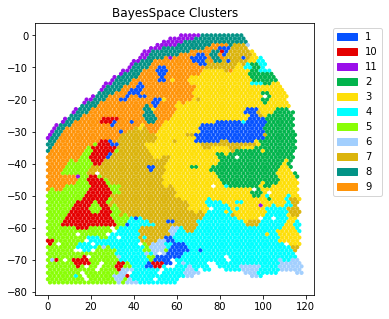

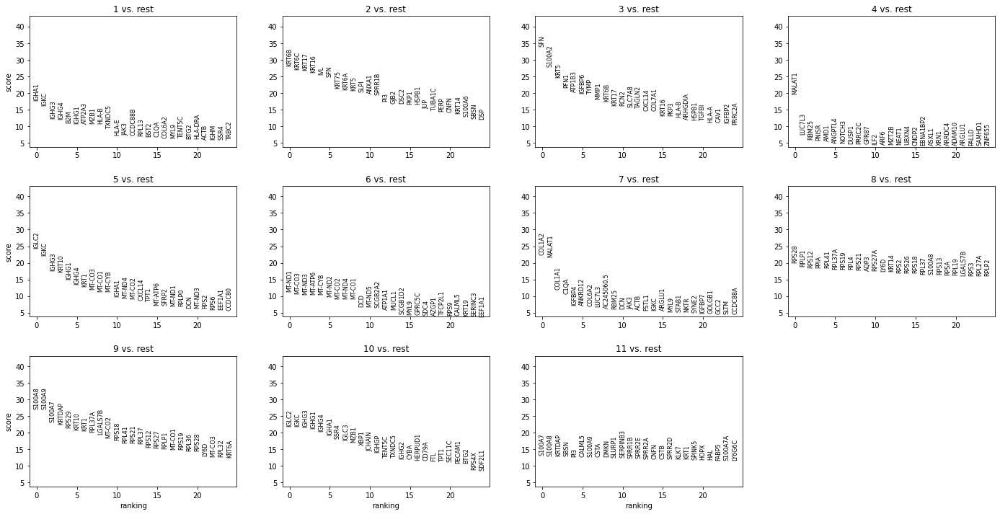

In [30]:
llrtp.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="BayesSpace Clusters",
    dsize=10
)
sc.tl.rank_genes_groups(adata, 'BayesSpace_11', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=True, save=True)

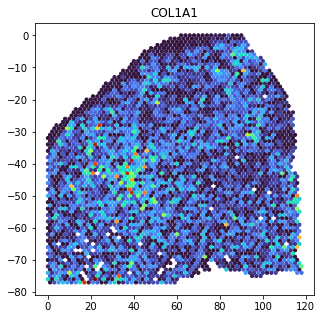

In [163]:
plot_gene('COL1A1', adata, cmap='turbo')

## Compute TSK-scores

In [25]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_zs = scaler.fit_transform(adata.X)
adata_zs = AnnData(
    X=X_zs,
    obs=adata.obs,
    var=adata.var
)

tsk_genes = [
    'MMP10',
    'PTHLH',
    'FEZ1',
    'IL24',
    'KCNMA1',
    'INHBA',
    'MAGEA4',
    'NT5E',
    'LAMC2',
    'SLITRK6',
    'MMP1',
    'SERPINE1',
    'SERPINE2',
    'IGFBP6',
    'TNC',
    'ITGA5',
    'ECM1',
    'SPINK6',
    'TMSB10',
    'KRT18',
    'FST',
    'ODC1',
    'LAMB3',
    'ITGA6',
    'ACTB',
    'ITGB1',
    'SORL1',
    'PFN1',
    'EMP3',
    'S100A10',
    'EREG',
    'LAMA3',
    'PRKCDBP',
    'OCIAD2',
    'CTSV',
    'ANXA3',
    'S100A2',
    'MET',
    'CD99',
    'TMSB4X',
    'TIMP3',
    'TPM4',
    'NEFM',
    'SCG5',
    'SH3BGRL3',
    'PLAU',
    'PKM',
    'CD63',
    'LGALS1',
    'BMP1',
    'TNFRSF12A',
    'ATP1B1',
    'CFL1',
    'MBOAT2',
    'F3',
    'TNFRSF21',
    'CLIC1',
    'CAP1',
    'PDPN',
    'SERINC2',
    'ANXA1',
    'BSG',
    'DSG2',
    'RHOC',
    'KRT17',
    'PDLIM7',
    'PHLDA1',
    'GLO1',
    'LTBP1',
    'TAGLN2',
    'CD151',
    'CAPN2',
    'COL5A2',
    'IGFBP2',
    'P4HA2',
    'COL17A1',
    'PLEK2',
    'AREG',
    'ARPC1B',
    'GLIPR1',
    'S100A6',
    'PLOD3',
    'YWHAZ',
    'CAV1',
    'ADIRF',
    'TGFBI',
    'RBP1',
    'FSTL3',
    'C16orf74',
    'UPP1',
    'TNNT1',
    'ANXA5',
    'SDC1',
    'PRDX5',
    'MYL12A',
    'GJB6',
    'SLC7A8',
    'RAB32',
    'FXYD5',
    'FSCN1'   
]

tsk_zs = []
for gene in tsk_genes:
    try:
        tsk_zs.append(adata_zs.obs_vector(gene))
    except KeyError:
        print(f'{gene} not in data...')
tsk_zs = np.array(tsk_zs)
tsk_zs

spatialcorr.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="BayesSpace Clusters",
    dsize=10
)

tsk_scores = np.sum(tsk_zs, axis=0)
adata_zs.obs['TSK Score'] = tsk_scores

fig, ax = plt.subplots(1,1, figsize=(4, 4)) 
spatialcorr.plot_slide(
    df_meta_ts, 
    tsk_scores, 
    cmap='turbo',
    colorbar=False,
    title="TSK Scores",
    dsize=12,
    vmin=np.quantile(tsk_scores, 0.1),
    vmax=np.quantile(tsk_scores, 0.9),
    ax=ax,
    figure=fig,
    ticks=False
)
plt.tight_layout()
fig.savefig('./figures_V2/Patient_4_TSK_Scores_heatmap.pdf', format='pdf')
plt.show()

fig, ax = plt.subplots(1,1, figsize=(4, 3))
sc.pl.violin(adata_zs, keys='TSK Score', groupby='BayesSpace_11', log=False, palette=spatialcorr.plot.PALETTE_MANY, ax=ax, show=False)
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures_V2/Patient_4_TSK_Scores_violin.pdf', bbox_layout='tight', format='pdf')
#plt.show()

#sc.pl.violin(adata_zs, keys='TSK Score', groupby='BayesSpace_11', log=False)
#plt.show()

PRKCDBP not in data...


array([[-0.29691434, -0.28339607, -0.291715  , ...,  2.2154078 ,
        -0.29795423, -0.23348239],
       [-0.608193  , -0.608193  , -0.608193  , ..., -0.5871994 ,
        -0.28464445,  0.9947308 ],
       [-0.57316035, -0.57316035, -0.26198432, ..., -0.57316035,
        -0.57316035,  0.85306317],
       ...,
       [ 1.8170308 , -0.5877154 ,  0.04656856, ..., -0.5995711 ,
        -0.6292106 , -0.25575367],
       [-0.9026962 ,  0.5244031 , -0.85485744, ..., -0.15501444,
         0.45882642, -0.5764253 ],
       [ 0.12376368, -0.11259543, -0.95692766, ...,  0.9788804 ,
         0.03973485,  0.36326823]], dtype=float32)

In [72]:
dermis_genes = [
    'COL1A1', 
    'COL1A2', 
    'SPARC', 
    'DCN', 
    'CCDC80', 
    'PI16', 
    'CFD', 
    'ELN', 
    'MMP2', 
    'COL3A1', 
    'FBLN1', 
    'COL6A2', 
    'IGFBP5', 
    'COL6A1', 
    'MGP'
]
blood_vessel_genes = [
    'CD74', 
    'RGS5', 
    'SPARCL1', 
    'VIM', 
    'A2M', 
    'LYZ', 
    'ESAM', 
    'IGFBP7', 
    'CLDN5', 
    'DEPP1', 
    'PECAM1', 
    'TPSB2', 
    'KCTD12', 
    'FXYD5', 
    'HLA-DRA', 
    'IGFBP4', 
    'IL32', 
    'C3', 
    'CD34', 
    'ACKR1', 
    'RNASE1', 
    'IFITM2', 
    'CXCL12', 
    'CCL14', 
    'CAV1', 
    'MCAM'
]
epithelial_1_genes = [
    'KRT10', 'KRT1', 'KRTDAP', 'KRT2', 'DMKN', 'KRT5', 'KRT14'
]
epithelial_3_genes = [
    'CDSN', 
    'LCE1A', 
    'LCE1C', 
    'FLG', 
    'FLG2', 
    'SBSN', 
    'SPRR2E', 
    'KRT10', 
    'LCE1B', 
    'DMKN', 
    'KRTDAP', 
    'LOR', 
    'CALML5', 
    'ASPRV1', 
    'LCE2B', 
    'C1orf68', 
    'KRT1', 
    'KRT2', 
    'SLURP1', 
    'SPRR2G', 
    'CST6'
]

In [70]:
def score_gene_set(genes, score_name, title):
    zs = []
    for gene in genes:
        try:
            zs.append(adata_zs.obs_vector(gene))
        except KeyError:
            print(f'{gene} not in data...')
    zs = np.array(zs)
    zs

    scores = np.sum(zs, axis=0)
    adata_zs.obs[score_name] = scores
    llrtp.plot_slide(
        df_meta_ts, 
        scores, 
        cmap='turbo',
        colorbar=True,
        title=title,
        dsize=15
    )
    plt.show()

    sc.pl.violin(adata_zs, keys=score_name, groupby='BayesSpace_11', log=False, palette=llrtp.PALETTE)
    plt.show()

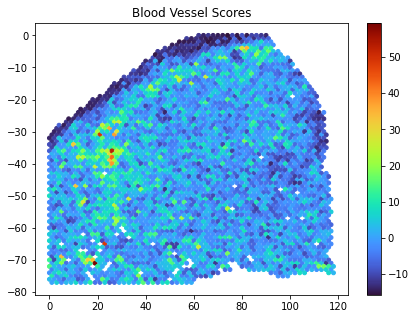

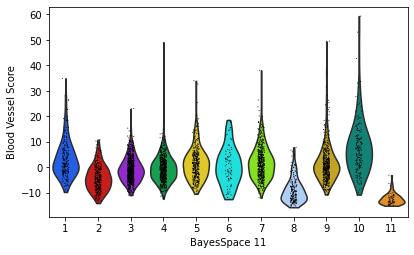

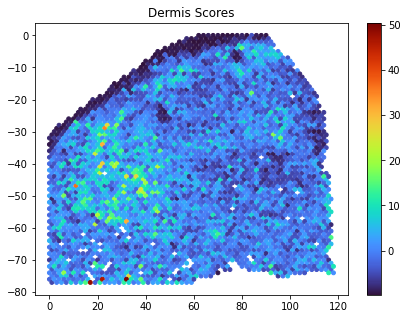

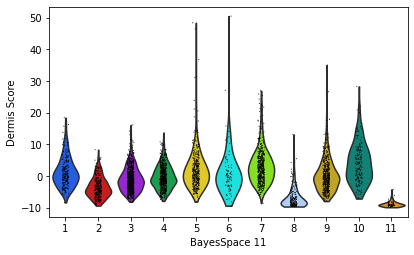

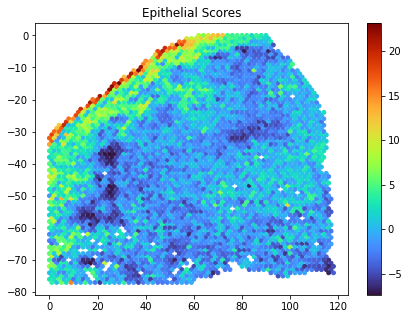

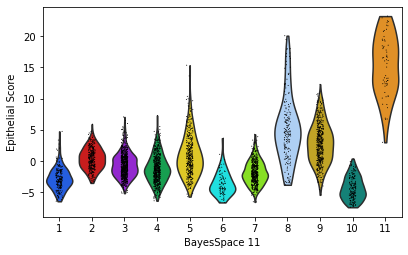

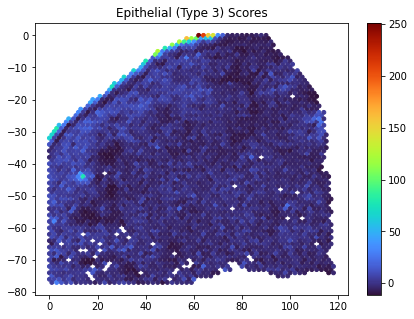

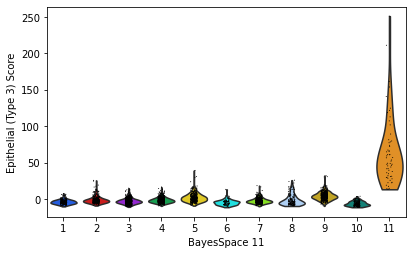

In [73]:
score_gene_set(blood_vessel_genes, 'Blood Vessel Score', 'Blood Vessel Scores')
score_gene_set(dermis_genes, 'Dermis Score', 'Dermis Scores')
score_gene_set(epithelial_1_genes, 'Epithelial Score', 'Epithelial Scores')
score_gene_set(epithelial_3_genes, 'Epithelial (Type 3) Score', 'Epithelial (Type 3) Scores')

# Dig into results from running on GO terms

In [30]:
def generate_gene_set_plots(
    genes_in_gs, 
    adata, 
    condition='BayesSpace_11', 
    sigma=5,
    corr_magnitude=False,
    estimate_type='local',
    plot_conf=True,
    pairwise_pvals=None,
    pairwise_pvals_2=None,
    fig_path=None
):

    fig, axarr = plt.subplots(
        len(genes_in_gs),
        len(genes_in_gs),
        figsize=(2*len(genes_in_gs),2*len(genes_in_gs))
    )  
    
    # Get range of expression values for colormap
    # of expression
    all_expr = []
    for gene in genes_in_gs:
        expr = adata.obs_vector(gene)
        all_expr += list(expr)
    min_expr = min(all_expr)
    max_expr = max(all_expr)
    
    
    if pairwise_pvals is not None:
        gene_pair_to_pval = {
            frozenset(k.split(',')): v
            for k,v in pairwise_pvals.items()
        }
    if pairwise_pvals_2 is not None:
        pairwise_pvals_2 = {
            frozenset(k.split(',')): v
            for k,v in pairwise_pvals_2.items()
        }
    
    for row, ax_row in enumerate(axarr):
        for col, ax in enumerate(ax_row):
            gene_1 = genes_in_gs[row]
            gene_2 = genes_in_gs[col]

            if row == 0:
                title = gene_2
            else: 
                title = None
                
            if corr_magnitude:
                cmap = 'turbo'
            else:
                cmap = 'RdBu_r'
            
            if col == row:
                llrtp.plot_slide(
                    adata.obs, 
                    adata.obs_vector(gene_1), 
                    cmap='turbo', 
                    title=title,
                    dsize=0.75,
                    ax=ax,
                    figure=fig,
                    ticks=False,
                    vmin=min_expr,
                    vmax=max_expr
                )
                ax.set_ylabel(gene_1, fontsize=13)
            elif col > row:
                #if col == row+1:
                #    ax.set_ylabel(gene_1, fontsize=13)
                if plot_conf:
                    plot_corr_confs(
                        gene_1, 
                        gene_2, 
                        adata, 
                        bc_to_neighs, 
                        bc_is_border, 
                        ax=ax, 
                        figure=None, 
                        dsize=0.5, 
                        dsize2=8,
                        title=title
                    )
                else:
                    corrs, kept_inds, _ = spatialcorr.plot_correlation(
                        adata,
                        gene_1, gene_2,
                        sigma=sigma,
                        contrib_thresh=10,
                        kernel_matrix=None,
                        row_key='row',
                        col_key='col',
                        condition=condition,
                        corr_magnitude=corr_magnitude,
                        cmap=cmap,
                        colorbar=False,
                        ticks=False,
                        ax=ax,
                        figure=None,
                        estimate=estimate_type,
                        dsize=0.75,
                        title=title
                    )
                if pairwise_pvals is not None:
                    if gene_pair_to_pval[frozenset({gene_1, gene_2})] < 0.005:
                        ax.scatter([115, 105], [5, 5], marker='*', s=20, color='black')
                    elif gene_pair_to_pval[frozenset({gene_1, gene_2})] < 0.05:
                        ax.scatter([115], [5], marker='*', s=20, color='black')
                if pairwise_pvals_2 is not None:
                    if pairwise_pvals_2[frozenset({gene_1, gene_2})] < 0.005:
                        ax.scatter([115, 105], [15, 15], marker='o', s=20, color='black')
                    elif pairwise_pvals_2[frozenset({gene_1, gene_2})] < 0.05:
                        ax.scatter([115], [15], marker='o', s=20, color='black')
                
            else:
                ax.set_visible(False)

    if fig_path:
        plt.tight_layout()
        fig.savefig(
            fig_path, 
            format='pdf'
        )

    
def barplot():
    # Create barplots
    fig, ax = plt.subplots(
        1,
        1,
        figsize=(3,4)
    )
    pairs = [x[0] for x in targ_gs_to_pair_w_pval[targ_gs]]
    pvals = [x[1] for x in targ_gs_to_pair_w_pval[targ_gs]]
    r = multipletests(
        pvals, 
        alpha=0.05, 
        method='fdr_bh'
    )
    pvals_adj = list(-1 * np.log10(r[1]))
    sns.barplot(
        x=['All'] + [f"{x.split(',')[0]}, {x.split(',')[1]}" for x in pairs], 
        y=[-1 * np.log10(targ_res['gene_set_to_pval'][targ_gs])] + list(pvals_adj), 
        ax=ax, 
        palette=['#1c59ff'] +  ['#1cff95' for x in pairs]
    )
    ax.set_xticklabels(
        ['All'] + [f"{x.split(',')[0]}, {x.split(',')[1]}" for x in pairs], 
        rotation = 90
    )
    ax.axhline(-1 * np.log10(0.05), color='grey', ls='--')
    ax.set_xlabel('Gene Set')
    ax.set_ylabel(r'-$log_{10}$ p-value')
    ax.set_title('Compare joint p-value to\npairwise adjusted p-values')
    plt.tight_layout()
    #fig.savefig(
    #    f'../results/compare_joint_vs_pairwise.{gs}.barplot.pdf', 
    #    format='pdf'
    #)

In [31]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, set_link_color_palette
from sklearn.datasets import load_iris
from sklearn.cluster import AgglomerativeClustering

def compute_pairwise_corrs(gene_pairs):
    gps = []
    all_corrs = []
    for gp in gene_pairs:
        g1, g2 = gp.split(',')
        corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
            adata, 
            g1, g2,
            kernel_matrix=None, 
            row_key='row', 
            col_key='col', 
            condition=None, 
            sigma=5
        )
        gps.append(gp)
        all_corrs.append(corrs)    
    return gps, all_corrs

def cluster_corrs(gsp, all_corrs, color_thresh=19):
    pal = list(sns.color_palette("Set2").as_hex())
    print(pal)

    def plot_dendrogram(model, **kwargs):
        # Create linkage matrix and then plot the dendrogram

        # create the counts of samples under each node
        counts = np.zeros(model.children_.shape[0])
        n_samples = len(model.labels_)
        for i, merge in enumerate(model.children_):
            current_count = 0
            for child_idx in merge:
                if child_idx < n_samples:
                    current_count += 1  # leaf node
                else:
                    current_count += counts[child_idx - n_samples]
            counts[i] = current_count

        linkage_matrix = np.column_stack([model.children_, model.distances_,
                                          counts]).astype(float)

        # Plot the corresponding dendrogram
        dendrogram(linkage_matrix, **kwargs)


    fig, ax = plt.subplots(
        1,
        1,
        figsize=(8,6)
    )
    # setting distance_threshold=0 ensures we compute the full tree.
    model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)

    model = model.fit(np.array(all_corrs).squeeze())
    plt.title('Hierarchical Clustering Dendrogram')
    # plot the top three levels of the dendrogram

    set_link_color_palette(pal)

    plot_dendrogram(
        model, 
        truncate_mode='level', 
        p=6, 
        labels=gps, 
        color_threshold=color_thresh, 
        leaf_rotation=90, 
        ax=ax, 
        above_threshold_color='grey'
    )
    plt.show()

In [32]:
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_hypoxia_related.sequential_mc.between_layers.json', 'r') as f:
    j_hypoxia_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_interferon_related_related.sequential_mc.between_layers.json', 'r') as f:
    j_interferon_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_interleukin_related.sequential_mc.between_layers.json', 'r') as f:
    j_interleukin_between = json.load(f)
#with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_dna_repair_related.sequential_mc.between_layers.json', 'r') as f:
#    j_dna_repair_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_apoptosis_related.sequential_mc.between_layers.json', 'r') as f:
    j_apoptosis_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_epidermis_development_related.sequential_mc.between_layers.json', 'r') as f:
    j_epidermis_dev_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_keratinocyte_related.sequential_mc.between_layers.json', 'r') as f:
    j_keratinocyte_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_b_cell_related_related.sequential_mc.between_layers.json', 'r') as f:
    j_b_cell_between = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_t_cell_related.sequential_mc.between_layers.json', 'r') as f:
    j_t_cell_between = json.load(f) 
#with open('../GSM4565826_P6_rep2_GO_experiment/results_clust_11/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_cell_cell_adhesion_related.sequential_mc.between_layers.json', 'r') as f:
#    j_cell_cell_adhesion_between = json.load(f) 
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_dna_replication_related.sequential_mc.between_layers.json', 'r') as f:
    j_dna_replication_between = json.load(f) 
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_cell_cell_adhesion_related.sequential_mc.between_layers.json', 'r') as f:
    j_cell_cell_adhesion_between = json.load(f)
    
between_results = list(j_b_cell_between['gene_set_to_pval'].items()) \
    + list(j_hypoxia_between['gene_set_to_pval'].items()) \
    + list(j_epidermis_dev_between['gene_set_to_pval'].items()) \
    + list(j_interferon_between['gene_set_to_pval'].items()) \
    + list(j_dna_replication_between['gene_set_to_pval'].items()) \
    + list(j_interleukin_between['gene_set_to_pval'].items()) \
    + list(j_apoptosis_between['gene_set_to_pval'].items()) \
    + list(j_t_cell_between['gene_set_to_pval'].items()) \
    + list(j_keratinocyte_between['gene_set_to_pval'].items()) \
    + list(j_cell_cell_adhesion_between['gene_set_to_pval'].items()) \
#    + list(j_dna_repair_between['gene_set_to_pval'].items()) \
#    


In [33]:
#with open('../GSM4565826_P6_rep2_GO_experiment/results_clust_11/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_hypoxia_related.sequential_mc.json', 'r') as f:
#    j_hypoxia_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_dna_repair_related.sequential_mc.json', 'r') as f:
    j_dna_repair_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_b_cell_related_related.sequential_mc.json', 'r') as f:
    j_b_cell_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_interferon_related_related.sequential_mc.json', 'r') as f:
    j_interferon_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_interleukin_related.sequential_mc.json', 'r') as f:
    j_interleukin_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_apoptosis_related.sequential_mc.json', 'r') as f:
    j_apoptosis_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_epidermis_development_related.sequential_mc.json', 'r') as f:
    j_epidermis_dev_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_keratinocyte_related.sequential_mc.json', 'r') as f:
    j_keratinocyte_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_t_cell_related.sequential_mc.json', 'r') as f:
    j_t_cell_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_cell_cell_adhesion_related.sequential_mc.json', 'r') as f:
    j_cell_cell_adhesion_within = json.load(f)
with open('../GSM4565826_P6_rep2_GO_experiment/results/GSM4565826_P6_rep2.pairwise_LLRT_pvals.GO_dna_replication_related.sequential_mc.json', 'r') as f:
    j_dna_replication_within = json.load(f)

within_results = list(j_b_cell_within['gene_set_to_pval'].items()) \
    + list(j_interferon_within['gene_set_to_pval'].items()) \
    + list(j_dna_replication_within['gene_set_to_pval'].items()) \
    + list(j_interleukin_within['gene_set_to_pval'].items()) \
    + list(j_epidermis_dev_within['gene_set_to_pval'].items()) \
    + list(j_apoptosis_within['gene_set_to_pval'].items()) \
    + list(j_t_cell_within['gene_set_to_pval'].items()) \
    + list(j_cell_cell_adhesion_within['gene_set_to_pval'].items()) \
    + list(j_dna_repair_within['gene_set_to_pval'].items()) \
    + list(j_keratinocyte_within['gene_set_to_pval'].items()) \
#    + list(j_hypoxia_within['gene_set_to_pval'].items()) \
#    
#    


BHR-Test
('GO_B_CELL_MEDIATED_IMMUNITY', 0.0001)
('GO_B_CELL_ACTIVATION', 0.0001)
('GO_REGULATION_OF_B_CELL_ACTIVATION', 0.0001)
('GO_POSITIVE_REGULATION_OF_B_CELL_ACTIVATION', 0.0001)
('GO_B_CELL_RECEPTOR_SIGNALING_PATHWAY', 0.0001)
('GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 0.0001)
('GO_EPIDERMIS_DEVELOPMENT', 0.0001)
('GO_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_BY_P53_CLASS_MEDIATOR', 0.0001)
('GO_POSITIVE_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_POSITIVE_REGULATION_OF_T_CELL_PROLIFERATION', 0.0001)
('GO_KERATINOCYTE_DIFFERENTIATION', 0.0001)
('GO_CELL_CELL_ADHESION', 0.0001)
('GO_LEUKOCYTE_CELL_CELL_ADHESION', 0.0001)
('GO_HOMOTYPIC_CELL_CELL_ADHESION', 0.0001)
('GO_KERATINOCYT

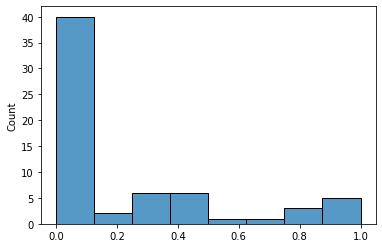

In [34]:
print("BHR-Test")
gs_between_p_vals = [x[1] for x in between_results]
gs_between_p_vals_fdr, _, _, _ = multipletests(
    gs_between_p_vals, 
    method='fdr_bh',
    alpha=0.25
)
print('\n'.join(map(str, sorted(between_results, key=lambda x: x[1])[:50])))
print(Counter(gs_between_p_vals_fdr))
sns.histplot(gs_between_p_vals)
plt.show()

WHR-Test
('GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 0.0001)
('GO_EPIDERMIS_DEVELOPMENT', 0.0001)
('GO_APOPTOTIC_SIGNALING_PATHWAY', 0.0001)
('GO_CELL_CELL_ADHESION', 0.0001)
('GO_KERATINOCYTE_DIFFERENTIATION', 0.0001)
('GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0004)
('GO_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.0004)
('GO_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.0007)
('GO_LEUKOCYTE_CELL_CELL_ADHESION', 0.0012)
('GO_REGULATION_OF_T_CELL_ACTIVATION', 0.006607201850016518)
('GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 0.011344299489506523)
('GO_T_CELL_ACTIVATION', 0.013123359580052493)
('GO_NEGATIVE_REGULATION_OF_LEUKOCYTE_CELL_CELL_ADHESION', 0.01448225923244026)
('GO_T_CELL_RECEPTOR_SIGNALING_PATHWAY', 0.017421602787456445)
('GO_T_CELL_PROLIFERATION', 0.020222446916076844)
('GO_POSITIVE_REGULATION_OF_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY', 0.024721878862793572)
('GO_RESPONSE_TO_INTERFERON_GAMMA', 0.05025125628140704)
('GO_CELL_CELL_ADHESION_VIA_PLASM

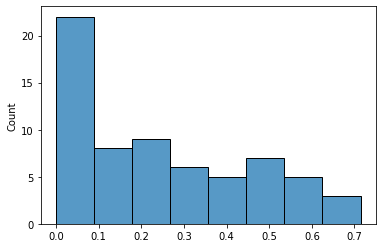

In [35]:
print("WHR-Test")
gs_within_p_vals = [x[1] for x in within_results]
gs_within_p_vals_fdr, p_vals_fdr, _, _ = multipletests(
    gs_within_p_vals, 
    method='fdr_bh',
    alpha=0.25
)
print('\n'.join(map(str, sorted(within_results, key=lambda x: x[1])[:50])))
print(Counter(gs_within_p_vals_fdr))
sns.histplot(gs_within_p_vals)
plt.show()

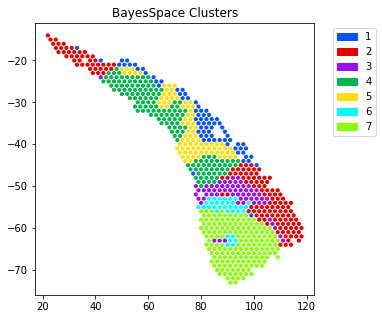

In [36]:
llrtp.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="BayesSpace Clusters",
    dsize=10
)

In [37]:
def plot_gene_set_result(data_res, gs, est_type, corr_magnitude=False, data_res_2=None, plot_pairwise_bar=False, plot_conf=True):
    if gs in data_res['gene_set_to_pairwise_pvals'].keys():
        if data_res_2 is not None:
            assert frozenset(data_res['gene_set_to_genes'].keys()) == frozenset(data_res_2['gene_set_to_genes'].keys())
            generate_gene_set_plots(
                data_res['gene_set_to_genes'][gs], 
                adata,
                condition='BayesSpace_11',
                estimate_type=est_type,
                sigma=7,
                pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
                pairwise_pvals_2=data_res_2['gene_set_to_pairwise_pvals'][gs],
                corr_magnitude=corr_magnitude,
                plot_conf=plot_conf
            )
        else:
            generate_gene_set_plots(
                data_res['gene_set_to_genes'][gs], 
                adata,
                condition='BayesSpace_11',
                estimate_type=est_type,
                sigma=7,
                pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
                corr_magnitude=corr_magnitude,
                plot_conf=plot_conf
            )
        plt.show()
        if plot_pairwise_bar:
            sns.histplot(list(data_res['gene_set_to_pairwise_pvals'][gs].values()))
            plt.show()
            p_vals_fdr, _, _, _ = multipletests(
                list(data_res['gene_set_to_pairwise_pvals'][gs].values()), 
                method='fdr_bh',
                alpha=0.05
            )
            print(Counter(p_vals_fdr))
    else:
        generate_gene_set_plots(
            data_res['gene_set_to_genes'][gs], 
            adata,
            condition='BayesSpace_11',
            estimate_type=est_type,
            sigma=7,
            corr_magnitude=corr_magnitude
        )

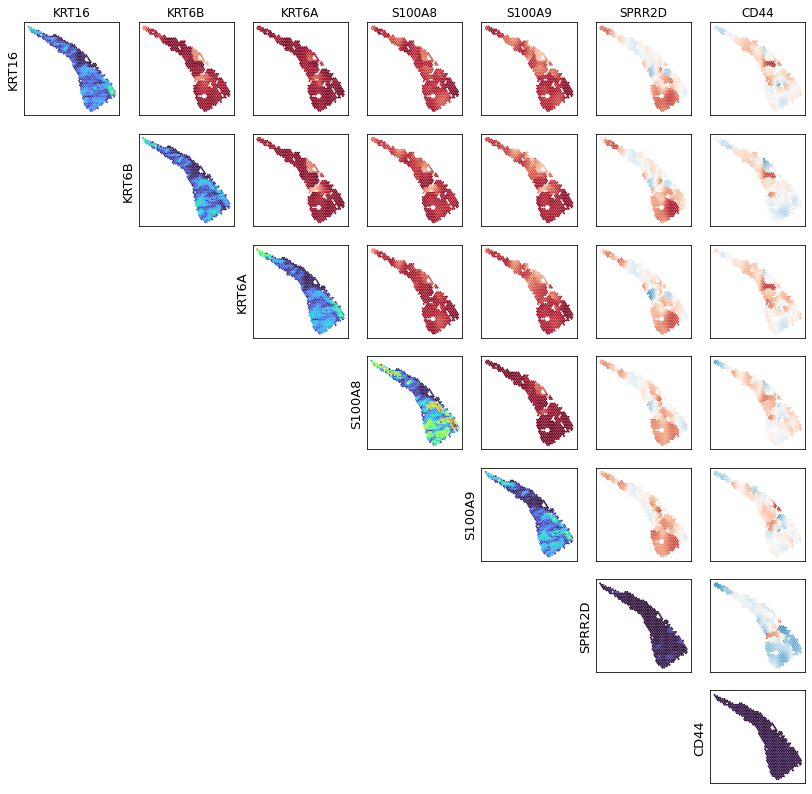

In [38]:
generate_gene_set_plots(
    ['KRT16', 'KRT6B', 'KRT6A', 'S100A8', 'S100A9', 'SPRR2D', 'CD44'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5,
    #pairwise_pvals=data_res['gene_set_to_pairwise_pvals'][gs],
    #pairwise_pvals_2=data_res_2['gene_set_to_pairwise_pvals'][gs],
    corr_magnitude=False,
    plot_conf=False,
    fig_path=None
)

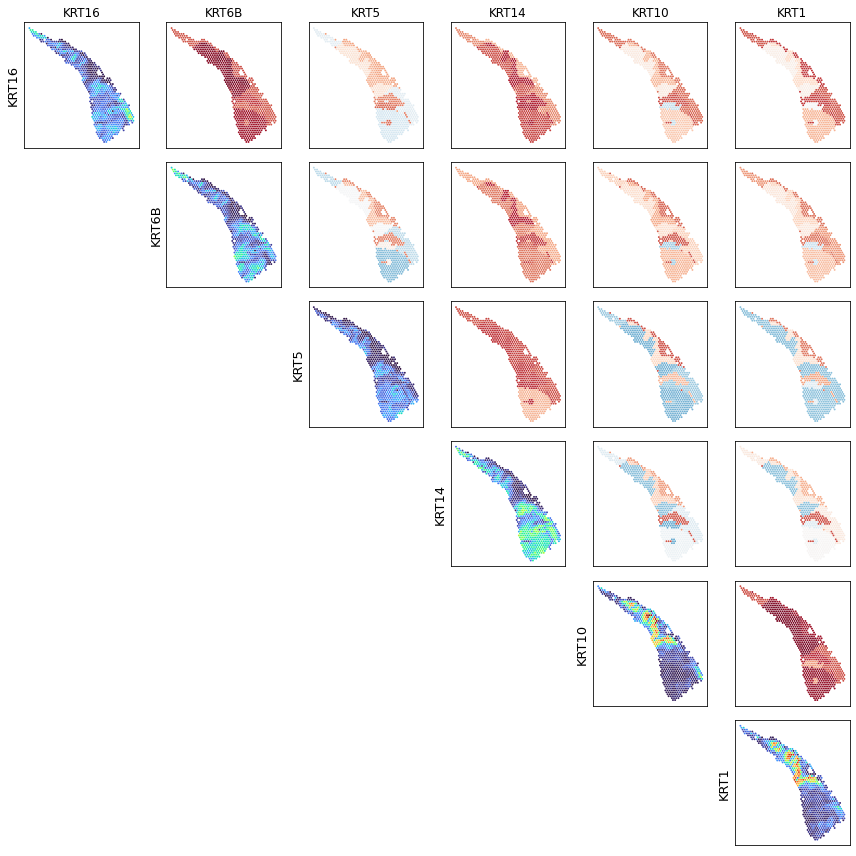

In [40]:
generate_gene_set_plots(
    ['KRT16', 'KRT6B', 'KRT5', 'KRT14', 'KRT10', 'KRT1'], 
    adata, 
    condition='BayesSpace_11', 
    sigma=5,
    corr_magnitude=False,
    estimate_type='regional',
    plot_conf=False,
    pairwise_pvals=None,
    pairwise_pvals_2=None,
    fig_path='./figures/P4_keratin_pairwise_regional.pdf'
)

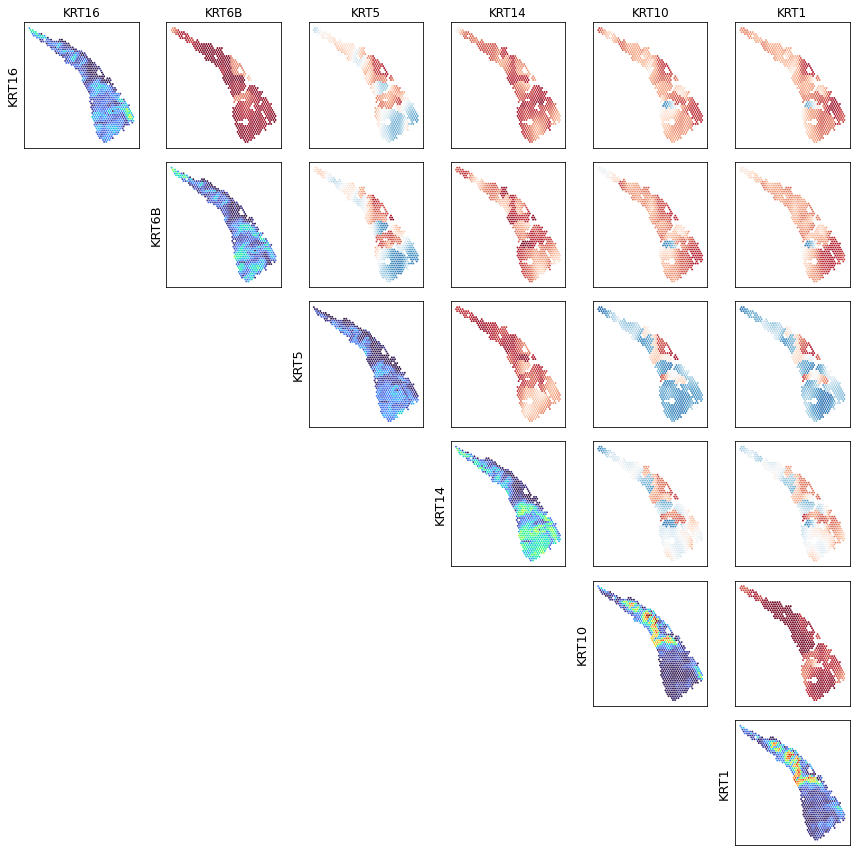

In [41]:
generate_gene_set_plots(
    ['KRT16', 'KRT6B', 'KRT5', 'KRT14', 'KRT10', 'KRT1'], 
    adata, 
    condition='BayesSpace_11', 
    sigma=5,
    corr_magnitude=False,
    estimate_type='local',
    plot_conf=False,
    pairwise_pvals=None,
    pairwise_pvals_2=None,
    fig_path='./figures/P4_keratin_pairwise.pdf'
)

Kept 3424/3820 spots.
Hit maximum permutations threshold of 20. P-value = 0.001
P-value:  0.001
{11: 0.079, 8: 0.001, 7: 0.027, 9: 0.001, 3: 0.002, 2: 0.001, 1: 0.234, 10: 0.515, 5: 0.614, 4: 0.515, 6: 0.906}
Kept 3424/3820 spots.
For cluster pair (4, 1), kept 697/708 spots.
Hit maximum permutations threshold of 20. P-value = 0.006
For cluster pair (5, 1), kept 497/509 spots.
Hit maximum permutations threshold of 20. P-value = 0.003
For cluster pair (5, 4), kept 926/939 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 36. P-value = 0.5555555555555556
For cluster pair (6, 1), kept 142/172 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 21. P-value = 0.9523809523809523
For cluster pair (6, 4), kept 571/602 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster pair (6, 5), kept 371/403 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 21. P-value

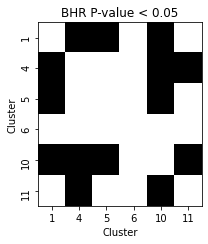

In [26]:
run_full_analysis_gene_set(['KRT16', 'KRT6B', 'KRT14', 'KRT5', 'KRT10', 'KRT1'], sigma=5, test_between=False, n_perms=1000)

In [ ]:
df_plot = pairwise_clust_between('KRT10', 'KRT5')
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT10, KRT5\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
#fig.savefig('./figures/Patient6_KRT10_KRT5_pairwise_BHR_pvals.pdf', format='pdf')

Trying to set attribute `.obs` of view, copying.
/Users/matthewbernstein/Development/python3_dev/lib/python3.7/site-packages/ipykernel_launcher.py:53: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "bbox_layout" which is no longer supported as of 3.3 and will become an error two minor releases later


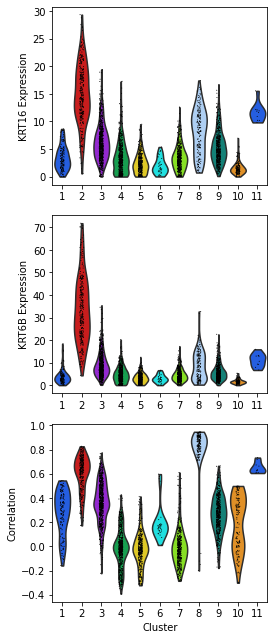

In [41]:
adata_keep = adata.copy()
corrs, keep_inds = spatialcorr.utils.compute_local_correlation(
    adata, 
    'KRT16', 'KRT6B',
    kernel_matrix=None, 
    row_key='row', 
    col_key='col', 
    condition='BayesSpace_11', 
    sigma=5,
    contrib_thresh=10
)
adata_keep = adata_keep[keep_inds,:]
adata_keep.obs['Correlation KRT16 & KRT6B'] = corrs

fig, axarr = plt.subplots(3,1, figsize=(4, 9))
cust_pal = np.array(spatialcorr.plot.PALETTE_MANY)[
    [0, 1, 2, 3, 4, 5, 6, 7, 9, 10]
]
sc.pl.violin(
    adata_keep, 
    'KRT16', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[0], 
    show=False
)
sc.pl.violin(
    adata_keep, 
    'KRT6B', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[1], 
    show=False
)
sc.pl.violin(
    adata_keep, 
    'Correlation KRT16 & KRT6B', 
    groupby='BayesSpace_11', 
    palette=cust_pal, 
    ax=axarr[2], 
    show=False
)

axarr[0].set_xlabel('')
axarr[1].set_xlabel('')
axarr[2].set_xlabel('Cluster')
axarr[0].set_ylabel('KRT16 Expression')
axarr[1].set_ylabel('KRT6B Expression')
axarr[2].set_ylabel('Correlation')
#plt.show()

plt.tight_layout()
fig.savefig('./figures/P6_KRT16_KRT6B_expression_corr_distr_violin.pdf', bbox_layout='tight', format='pdf')

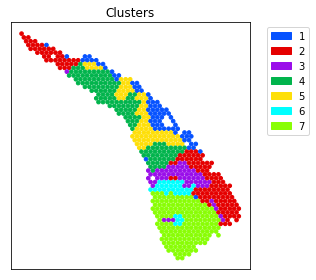

In [42]:
fig, ax = plt.subplots(1,1, figsize=(4.5, 4))
llrtp.plot_slide(
    adata.obs, 
    adata.obs['BayesSpace_11'], 
    cmap='categorical', 
    title="Clusters",
    dsize=13,
    ticks=False,
    figure=fig,
    ax=ax
)

plt.tight_layout()
fig.savefig('./figures/P4_clusters.pdf', format='pdf')



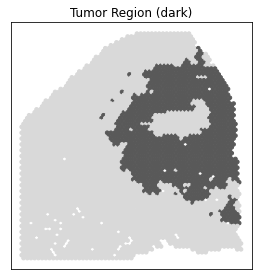

In [40]:
fig, ax = plt.subplots(1,1, figsize=(3.7, 4))
spatialcorr.plot_slide(
    adata.obs, 
    [x in set([2,3]) for x in adata.obs['BayesSpace_11']], 
    cmap='categorical', 
    title="Tumor Region (dark)",
    dsize=13,
    ticks=False,
    figure=fig,
    ax=ax,
    cat_palette=['#d9d9d9', '#595959']
)

plt.tight_layout()
fig.savefig('./figures/P6_tumor_region.pdf', format='pdf')

In [43]:
def pairwise_clust_between(genes, max_perms=500, run_regions=None):
    ct_to_ct_to_pval = spatialcorr.run_test_between_region_pairs(
        adata,
        genes,
        5,
        'BayesSpace_11',
        contrib_thresh=10,
        row_key='row',
        col_key='col',
        verbose=1,
        n_procs=5,
        standardize_var=False,
        max_perms=max_perms,
        mc_pvals=True,
        spot_to_neighbors=None,
        run_regions=run_regions
    )
    da = []
    for ct_1 in sorted(set(ct_to_ct_to_pval.keys())):
        row = []
        for ct_2 in sorted(set(ct_to_ct_to_pval.keys())):
            if ct_1 == ct_2:
                row.append(False)
            else:
                row.append(ct_to_ct_to_pval[ct_1][ct_2] < 0.05)
        da.append(row)
    df_plot = pd.DataFrame(
        data=da,
        columns=sorted(set(ct_to_ct_to_pval.keys())),
        index=sorted(set(ct_to_ct_to_pval.keys()))
    )
    return df_plot

In [44]:
df_plot = pairwise_clust_between('KRT16', 'KRT6B')

Kept 642/733 spots.


KeyError: 'Could not find key K in .var_names or .obs.columns.'

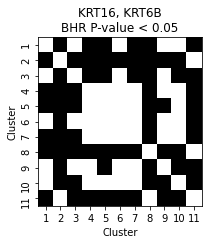

In [54]:
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT16, KRT6B\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient6_KRT16_KRT6B_pairwise_BHR_pvals.pdf', format='pdf')

In [55]:
df_plot = pairwise_clust_between('KRT10', 'KRT5')

For cluster pair (2, 1), kept 436/518 spots.
Hit maximum permutations threshold of 20. P-value = 0.002
For cluster pair (3, 1), kept 910/1005 spots.
Hit maximum permutations threshold of 20. P-value = 0.002
For cluster pair (3, 2), kept 1068/1101 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster pair (4, 1), kept 708/819 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 317. P-value = 0.06309148264984227
For cluster pair (4, 2), kept 866/915 spots.
Hit maximum permutations threshold of 20. P-value = 0.002
For cluster pair (4, 3), kept 1340/1402 spots.
Hit maximum permutations threshold of 20. P-value = 0.002
For cluster pair (5, 1), kept 509/607 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster pair (5, 2), kept 667/703 spots.
Hit maximum permutations threshold of 20. P-value = 0.002
For cluster pair (5, 3), kept 1141/1190 spots.
Hit maximum

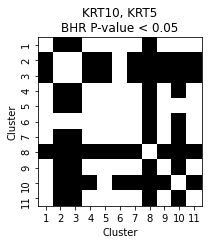

In [56]:
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT10, KRT5\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient6_KRT10_KRT5_pairwise_BHR_pvals.pdf', format='pdf')

In [51]:
df_plot = pairwise_clust_between('KRT5', 'KRT14')

For cluster pair (2, 1), kept 436/518 spots.
Hit maximum permutations threshold of 20. P-value = 0.016
For cluster pair (3, 1), kept 910/1005 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 346. P-value = 0.057803468208092484
For cluster pair (3, 2), kept 1068/1101 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster pair (4, 1), kept 708/819 spots.
Hit maximum permutations threshold of 20. P-value = 0.004
For cluster pair (4, 2), kept 866/915 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 20. P-value = 1.0
For cluster pair (4, 3), kept 1340/1402 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 71. P-value = 0.28169014084507044
For cluster pair (5, 1), kept 509/607 spots.
Hit maximum permutations threshold of 20. P-value = 0.024
For cluster pair (5, 2), kept 667/703 spots.
Number of nulls > obs has hit threshold of 20. Total permutations u

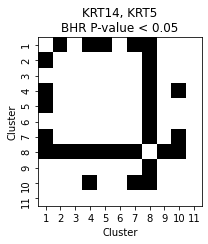

In [52]:
fig, ax = plt.subplots(1,1, figsize=(3, 3.5))
res = sns.heatmap(df_plot, cmap='Greys', cbar=False, ax=ax)
for _, spine in res.spines.items():
    spine.set_visible(True)
ax.set_title('KRT14, KRT5\nBHR P-value < 0.05')
ax.set_ylabel('Cluster')
ax.set_xlabel('Cluster')
plt.tight_layout()
fig.savefig('./figures/Patient6_KRT14_KRT5_pairwise_BHR_pvals.pdf', format='pdf')

## GO Leukocyte Cell Cell Adhesion

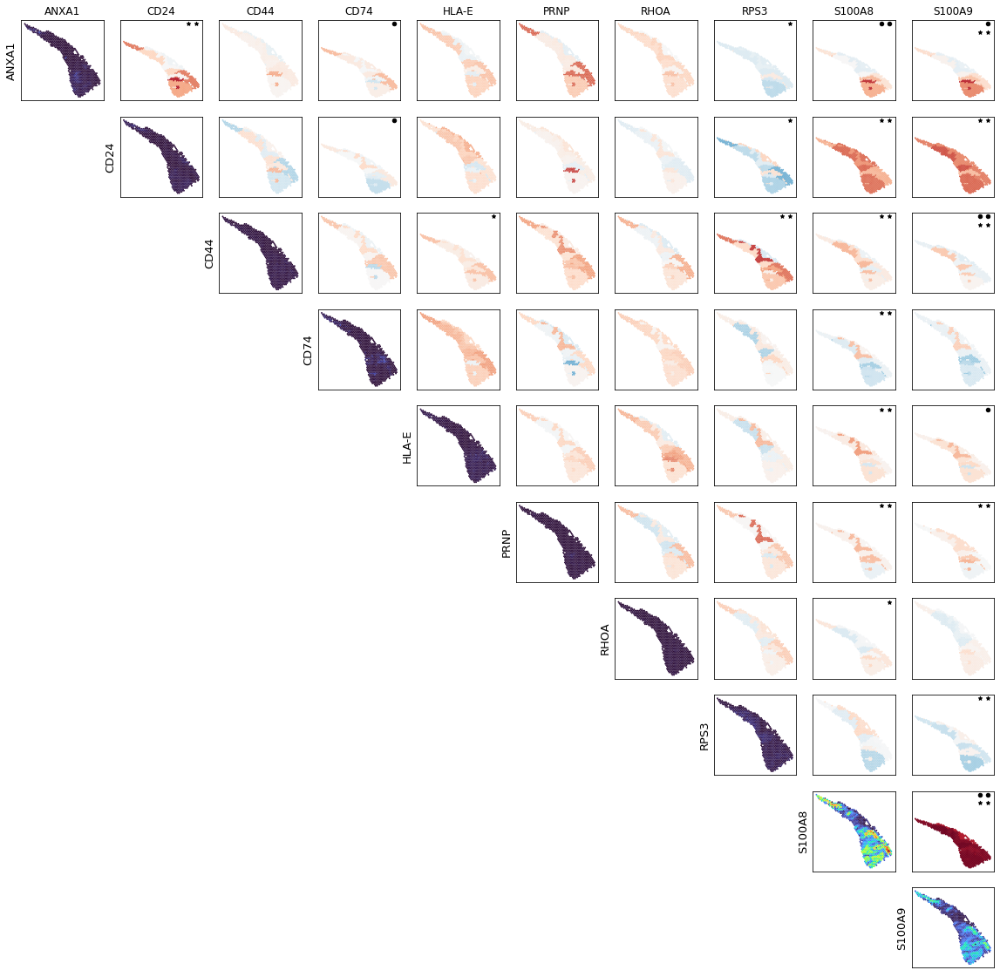

In [45]:
plot_gene_set_result(
    j_cell_cell_adhesion_between, 
    'GO_LEUKOCYTE_CELL_CELL_ADHESION', 
    est_type='regional',
    data_res_2=j_cell_cell_adhesion_within,
    plot_conf=False
)

## GO Response to Interleukin 4

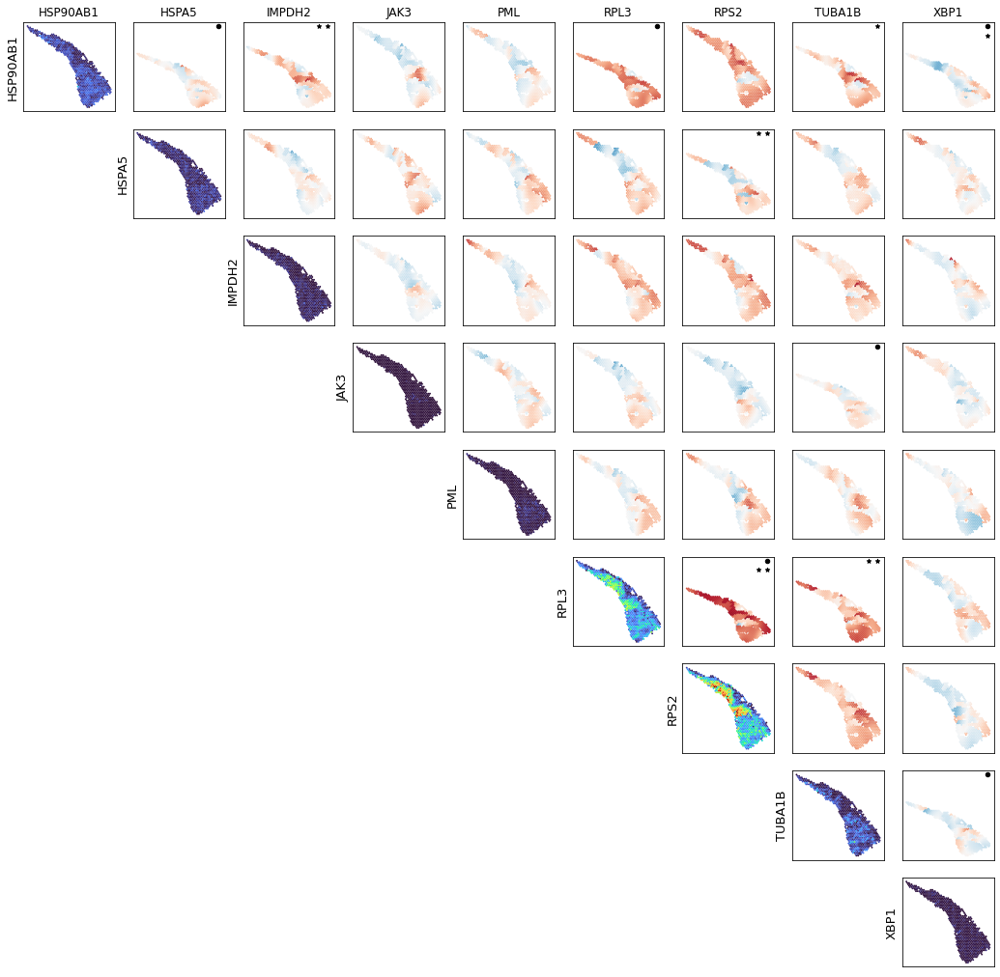

In [46]:
plot_gene_set_result(
    j_interleukin_between, 
    'GO_RESPONSE_TO_INTERLEUKIN_4', 
    est_type='local',
    data_res_2=j_interleukin_within,
    plot_conf=False
)

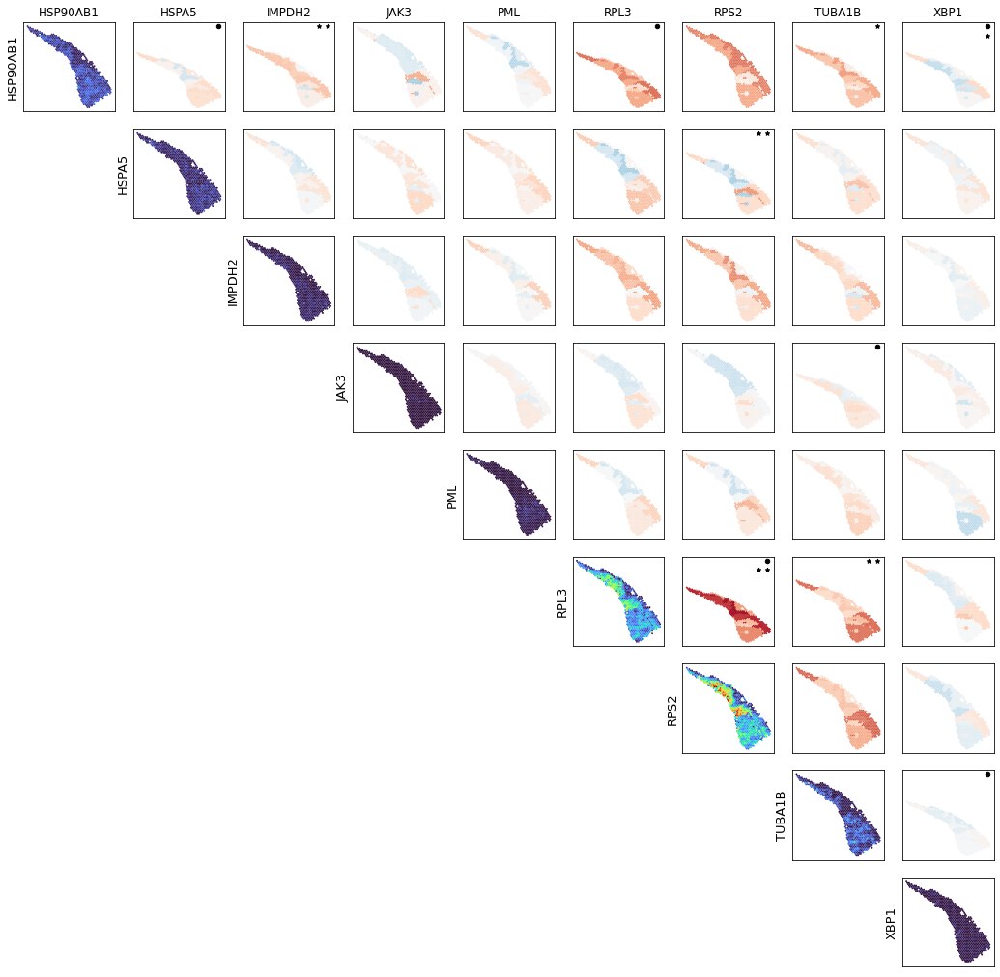

In [47]:
plot_gene_set_result(
    j_interleukin_between, 
    'GO_RESPONSE_TO_INTERLEUKIN_4', 
    est_type='regional',
    data_res_2=j_interleukin_within,
    plot_conf=False
)

Kept 3424/3820 spots.
P-value: 0.042
Kept 3424/3820 spots.
P-value: 0.002


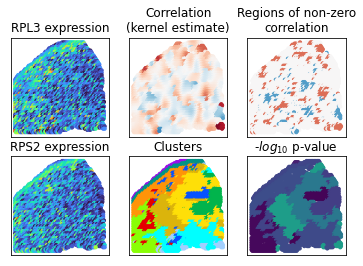

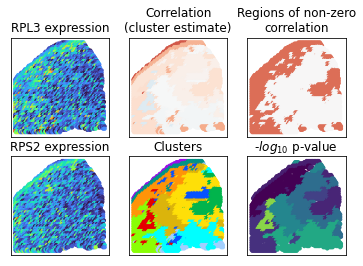

In [64]:
full_analysis_pair_2(
    'RPL3', 'RPS2',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'RPL3', 'RPS2', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

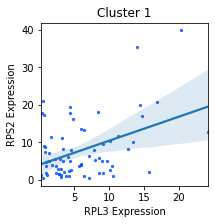

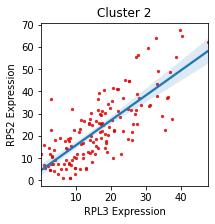

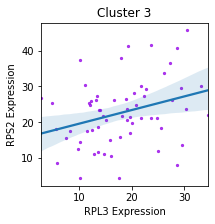

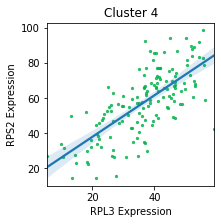

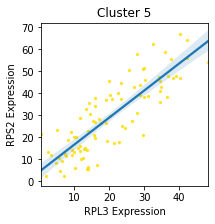

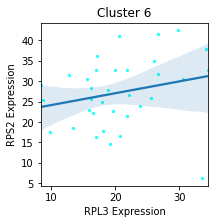

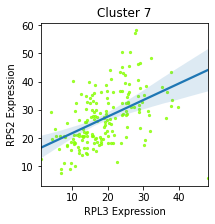

In [49]:
for c_i, i in enumerate([0,1,2,3,4,5,6]):
    clust = i+1
    plot_cluster_scatter('RPL3', 'RPS2', clust, color=spatialcorr.plot.PALETTE_MANY[c_i])#, xlim=(0, 4), ylim=(0,4))
    plt.title(f'Cluster {clust}')
    plt.show()

# GO Cell Cell Adhesion

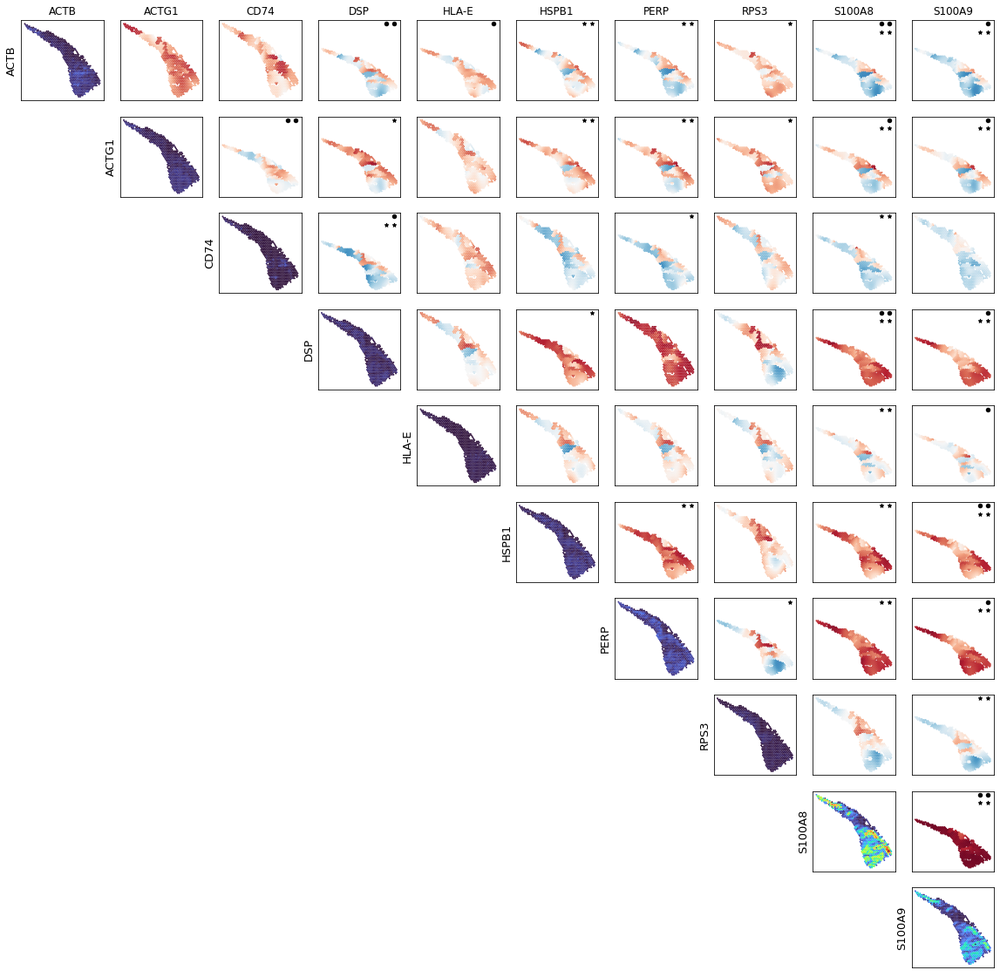

In [50]:
plot_gene_set_result(
    j_cell_cell_adhesion_between, 
    'GO_CELL_CELL_ADHESION', 
    est_type='local',
    data_res_2=j_cell_cell_adhesion_within,
    plot_conf=False
)

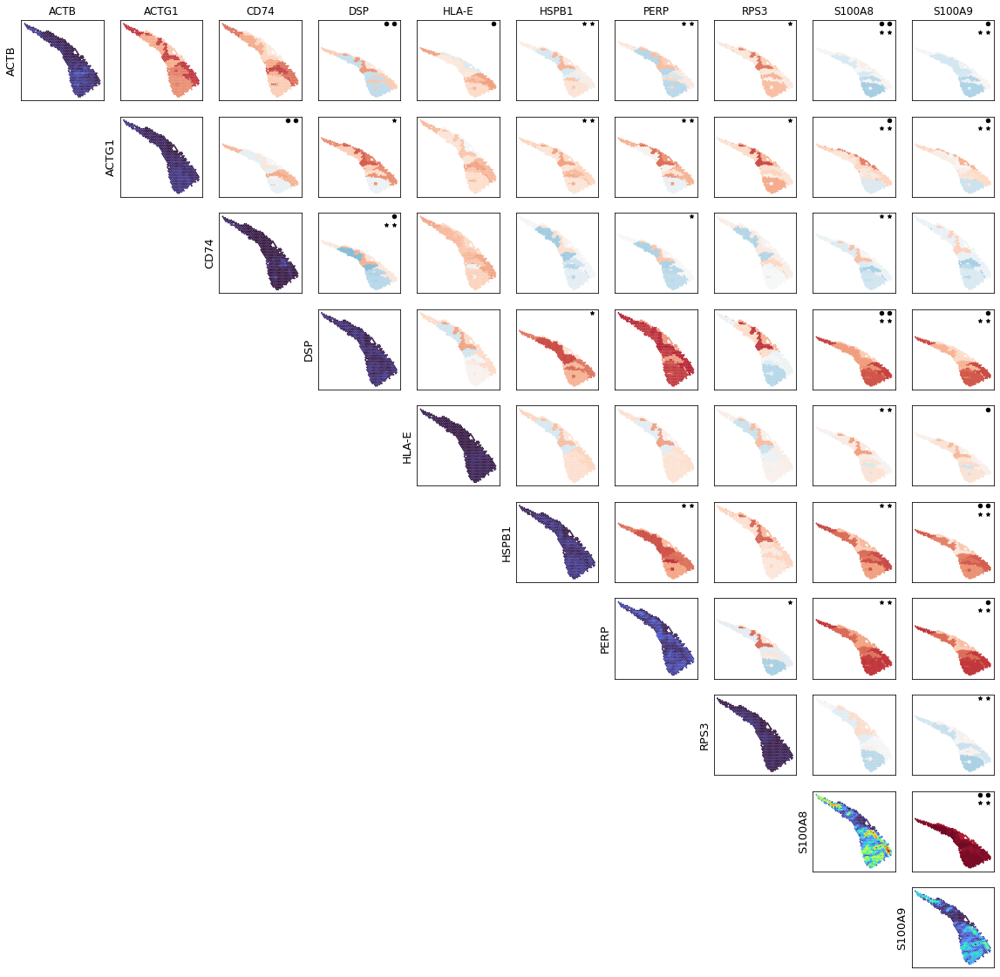

In [51]:
plot_gene_set_result(
    j_cell_cell_adhesion_between, 
    'GO_CELL_CELL_ADHESION', 
    est_type='regional',
    data_res_2=j_cell_cell_adhesion_within,
    plot_conf=False
)

# GO Keratinocyte Differentiation

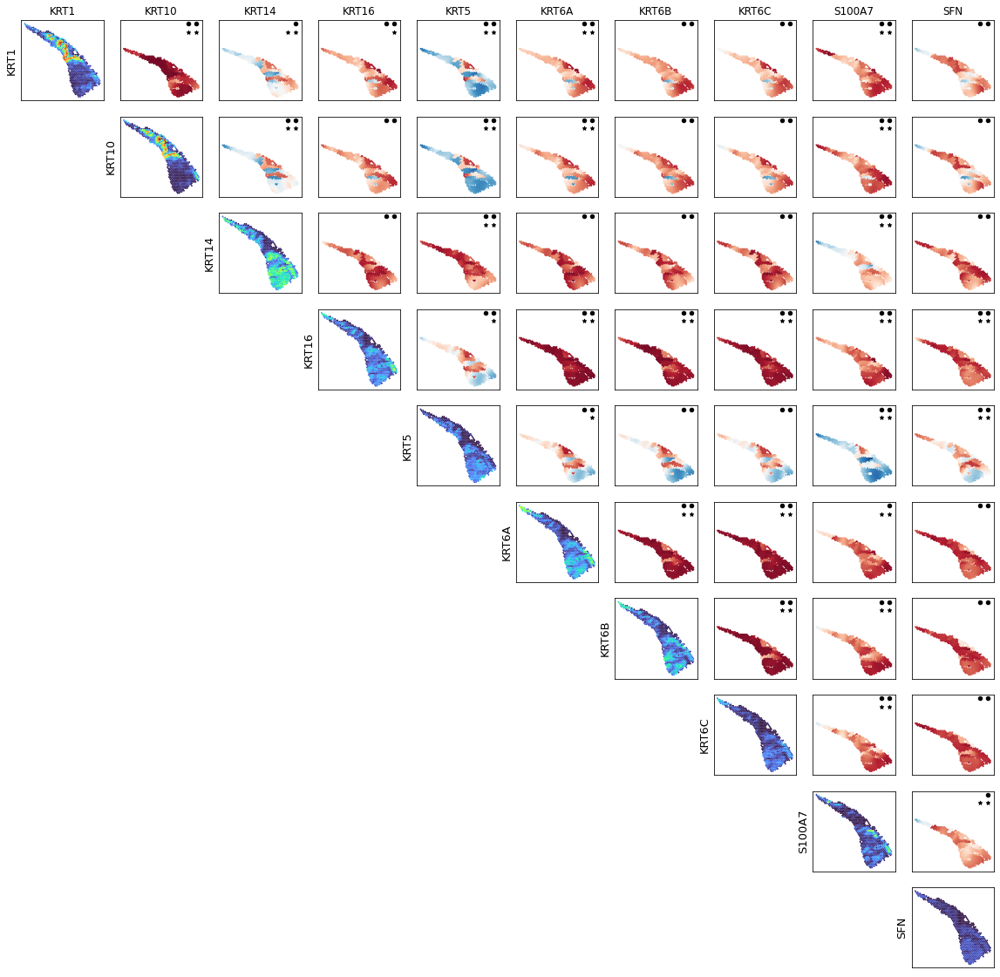

In [52]:
plot_gene_set_result(
    j_keratinocyte_between, 
    'GO_KERATINOCYTE_DIFFERENTIATION', 
    est_type='local',
    data_res_2=j_keratinocyte_within,
    plot_conf=False
)

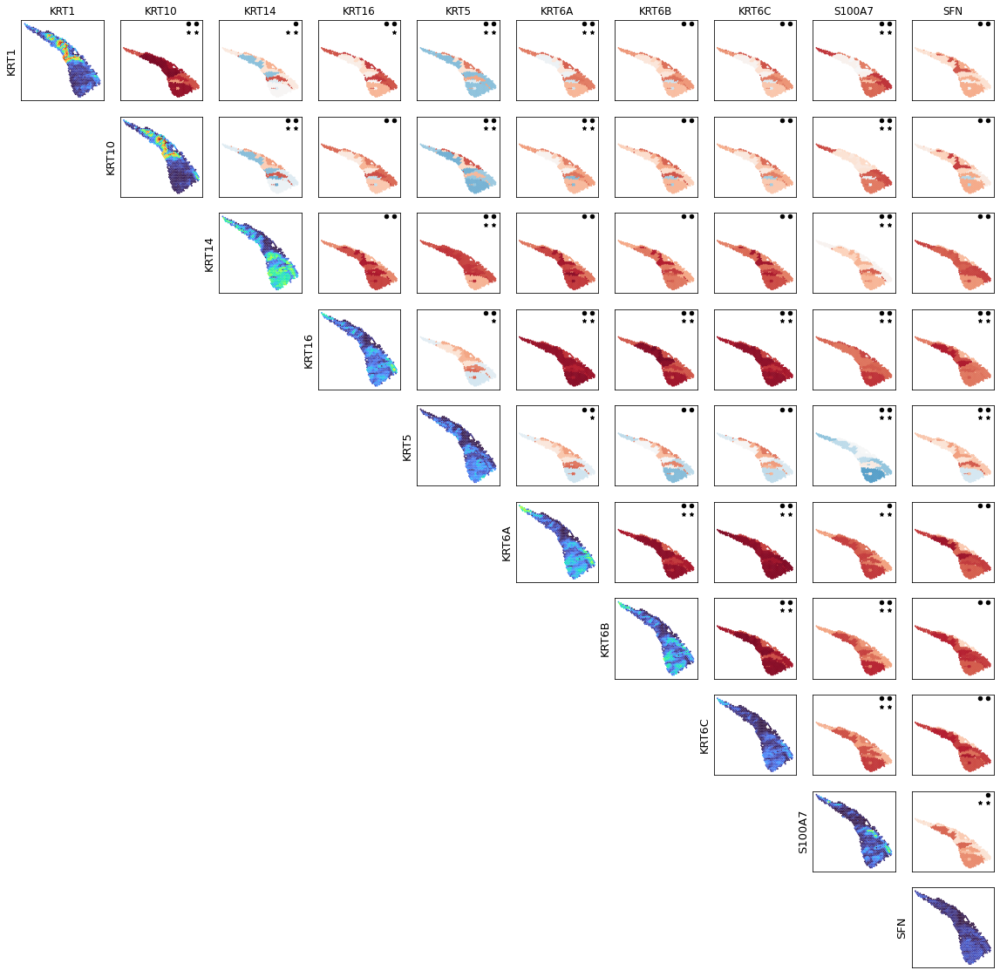

In [53]:
plot_gene_set_result(
    j_keratinocyte_between, 
    'GO_KERATINOCYTE_DIFFERENTIATION', 
    est_type='regional',
    data_res_2=j_keratinocyte_within,
    plot_conf=False
)

## Gene pair: KRT6B, KRT16

Kept 642/733 spots.
P-value: 0.01
Kept 642/733 spots.
For cluster pair (3, 1), kept 74/88 spots.
Hit maximum permutations threshold of 20. P-value = 0.14
For cluster pair (5, 1), kept 105/118 spots.
Hit maximum permutations threshold of 20. P-value = 0.01
For cluster pair (5, 3), kept 111/122 spots.
Hit maximum permutations threshold of 20. P-value = 0.01
For cluster pair (6, 1), kept 49/63 spots.
Hit maximum permutations threshold of 20. P-value = 0.17
For cluster pair (6, 3), kept 55/67 spots.
Number of nulls > obs has hit threshold of 20. Total permutations used: 67. P-value = 0.29850746268656714
For cluster pair (6, 5), kept 86/97 spots.
Hit maximum permutations threshold of 20. P-value = 0.01
For cluster pair (7, 1), kept 211/219 spots.
Hit maximum permutations threshold of 20. P-value = 0.01
For cluster pair (7, 3), kept 217/223 spots.
Hit maximum permutations threshold of 20. P-value = 0.01
For cluster pair (7, 5), kept 248/253 spots.
Hit maximum permutations threshold of 20. P-

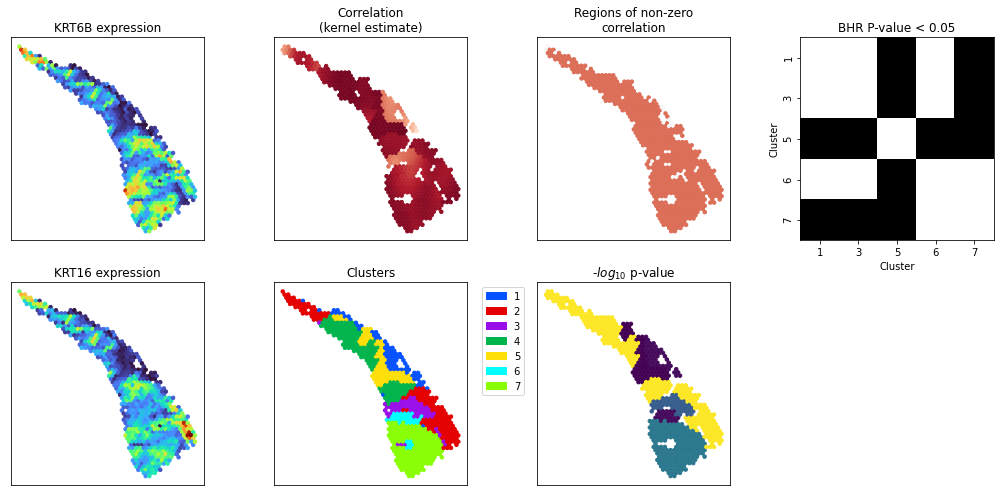

In [54]:
full_analysis_pair_2(
    'KRT6B', 'KRT16',
    sigma=5, 
    max_perms=100, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
#full_analysis_pair_2(
#    'KRT6B', 'KRT16', 
#    sigma=5, 
#    max_perms=500, 
#    n_procs=5, 
#    test_between=True, 
#    spot_to_neighbors=bc_to_neighs_full_clust,
#    spot_to_neighbors_clust=bc_to_neighs_full_clust
#)

## Gene pair: KRT10, KRT5

Kept 3424/3820 spots.
P-value: 0.002
Kept 3424/3820 spots.
P-value: 0.002


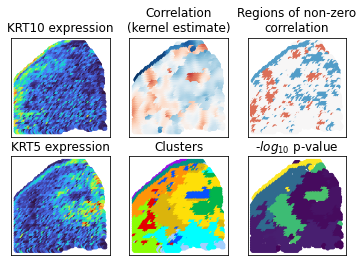

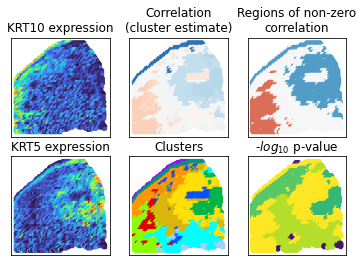

In [42]:
full_analysis_pair_2(
    'KRT10', 'KRT5',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT10', 'KRT5', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

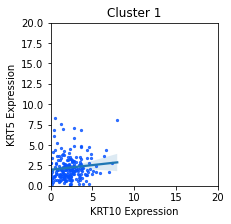

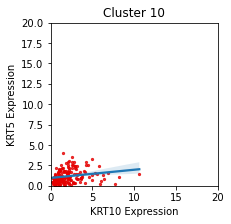

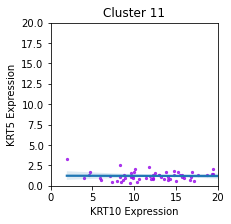

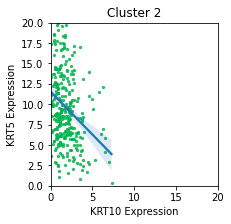

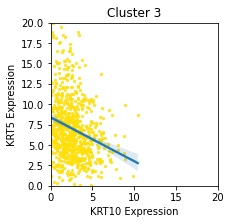

...

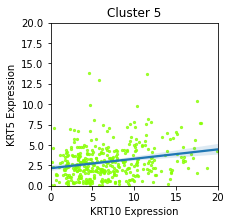

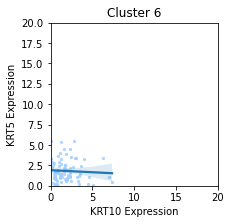

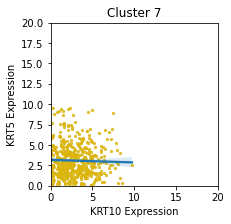

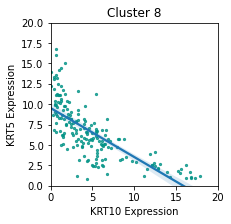

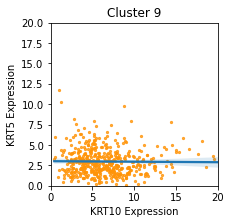

In [45]:
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('KRT10', 'KRT5', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 20), ylim=(0,20))
    plt.title(f'Cluster {clust}')
    plt.show()

## Gene pair: KRT10, KRT6B

Kept 3424/3820 spots.
P-value: 0.002
Kept 3424/3820 spots.
P-value: 1.0


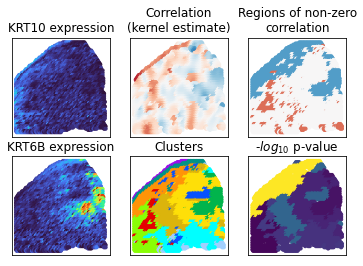

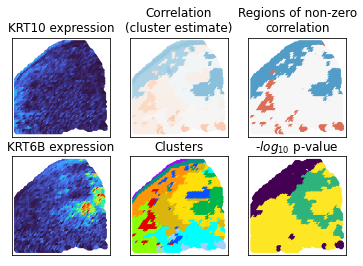

In [25]:
full_analysis_pair_2(
    'KRT10', 'KRT6B',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT10', 'KRT6B', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

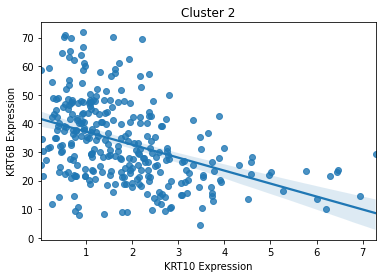

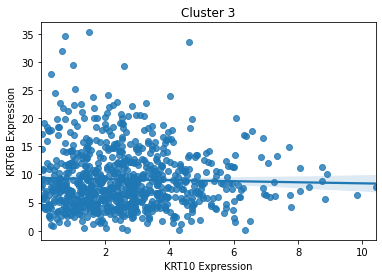

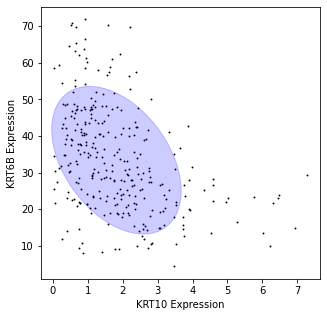

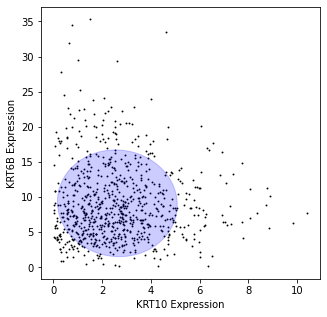

In [33]:
plot_cluster_scatter('KRT10', 'KRT6B', '2')
plt.title('Cluster 2')
plt.show()
plot_cluster_scatter('KRT10', 'KRT6B', '3')
plt.title('Cluster 3')
plt.show()

import matplotlib as mpl
plot_cluster_mvn('KRT10', 'KRT6B', '2')
plot_cluster_mvn('KRT10', 'KRT6B', '3')

In [23]:
p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT6B', 'KRT10'],
    5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=200,
    mc_pvals=False,
    spot_to_neighbors=bc_to_neighs_clust_cond
)

Kept 3424/3820 spots.
Spotwise null matrix shape:  (3424, 199)
Shape of neighborhood nulls matrix:  (3424, 199)


Kept 3424/3820 spots.
P-value: 0.006
Kept 3424/3820 spots.
P-value: 0.002


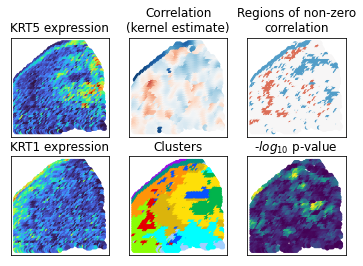

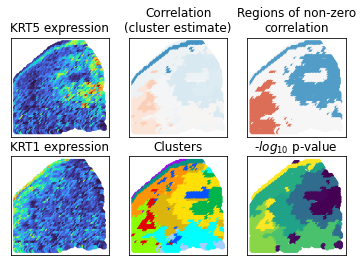

In [24]:
full_analysis_pair_2(
    'KRT5', 'KRT1',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'KRT5', 'KRT1', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

plot_gene_set_result(
    j_b_cell_between, 
    'GO_B_CELL_MEDIATED_IMMUNITY', 
    est_type='local',
    data_res_2=j_b_cell_within
)

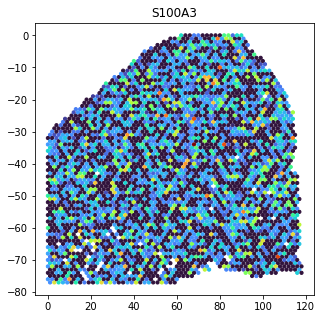

In [75]:
plot_gene('S100A3', adata, cmap='turbo')

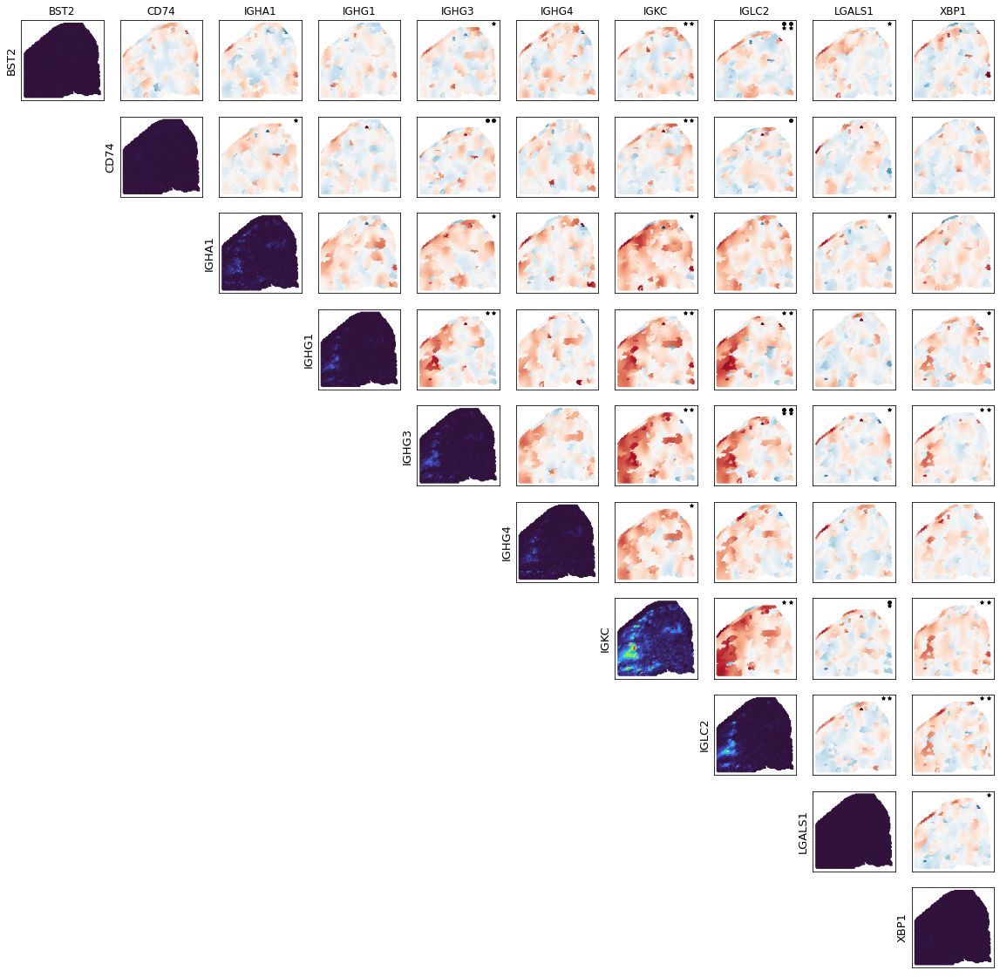

In [138]:
plot_gene_set_result(
    j_b_cell_between, 
    'GO_B_CELL_ACTIVATION', 
    est_type='local',
    data_res_2=j_b_cell_within,
    plot_conf=False
)

In [18]:
def compare_to_permutation(g1, g2, sigma=5):

    ct_to_indices = defaultdict(lambda: [])
    for i, ct in enumerate(adata.obs['BayesSpace_11']):
        ct_to_indices[ct].append(i)

    print("REAL:")
    expr = adata.obs_vector(g1)
    llrtp.plot_slide(
        adata.obs, 
        expr, 
        cmap='turbo', 
        title=g2,
        dsize=10
    )
    plt.title(g1)
    plt.show()


    expr = adata.obs_vector(g2)
    llrtp.plot_slide(
        adata.obs, 
        expr, 
        cmap='turbo', 
        title=g2,
        dsize=10
    )
    plt.title(g2)
    plt.show()
    corrs, kept_inds, _ = spatialcorr.plot_correlation(
        adata,
        g1, g2,
        sigma=sigma,
        contrib_thresh=10,
        kernel_matrix=None,
        row_key='row',
        col_key='col',
        condition='BayesSpace_11',
        cmap='RdBu_r',
        colorbar=True,
        ticks=True,
        estimate='local',
        dsize=13
    )
    plt.show()
    print("PERMUTED:")
    for i in range(5):
        adata_perm = adata.copy()
        perm_coords = spatialcorr.permute_coords(np.arange(adata.obs.shape[0]), ct_to_indices)
        adata_perm.obs = adata.obs.iloc[perm_coords]

        expr = adata_perm.obs_vector(g1)
        llrtp.plot_slide(
            adata_perm.obs, 
            expr, 
            cmap='turbo', 
            title=g1,
            dsize=10
        )
        plt.title(g1)
        plt.show()


        expr = adata_perm.obs_vector(g2)
        llrtp.plot_slide(
            adata_perm.obs, 
            expr, 
            cmap='turbo', 
            title=g2,
            dsize=10
        )
        plt.title(g2)
        plt.show()

        corrs, kept_inds, _ = spatialcorr.plot_correlation(
            adata_perm,
            g1, g2,
            sigma=sigma,
            contrib_thresh=10,
            kernel_matrix=None,
            row_key='row',
            col_key='col',
            condition='BayesSpace_11',
            cmap='RdBu_r',
            colorbar=True,
            ticks=True,
            estimate='local',
            dsize=13
        )
        plt.show()
        
        p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
            adata_perm,
            [g1, g2],
            sigma,
            cond_key='BayesSpace_11',
            contrib_thresh=10,
            row_key='row',
            col_key='col',
            verbose=1,
            n_procs=5,
            test_between_conds=False,
            compute_spotwise_pvals=True,
            max_perms=500,
            mc_pvals=False
        )
        print("P-value: ", p_val)

#compare_to_permutation('CD74', 'IGHG3')  # Sig
#compare_to_permutation('CD74', 'IGHG4')   # Not sig



#compare_to_permutation('IGHG3', 'IGLC2')

#compare_to_permutation('IGKC', 'IGHG3') # Not sig

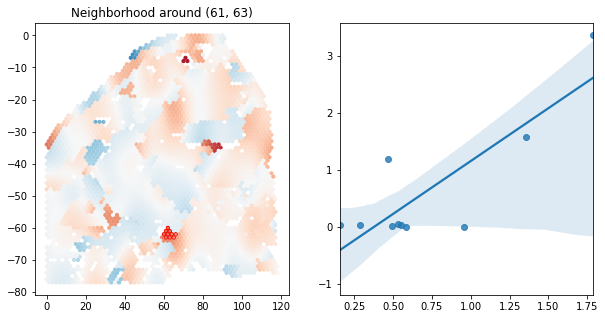

In [52]:
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'CD74', 'IGHG3',
    61,
    63,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

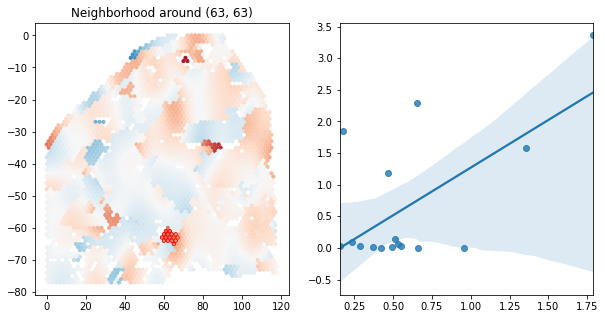

In [53]:
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'CD74', 'IGHG3',
    63,
    63,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

In [ ]:
p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals_1 = spatialcorr.run_test(
    adata,
    ['IGKC', 'IGHG3'],
    5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    mc_pvals=False
)
p_val, t_obs, t_nulls, kept_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals_2 = spatialcorr.run_test(
    adata,
    ['CD74', 'IGHG3'],
    5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    mc_pvals=False
)

sns.kdeplot(spot_p_vals_1, color='red')
sns.kdeplot(spot_p_vals_2, color='blue')
plt.show()

sns.histplot(spot_p_vals_1, color='red', alpha=0.2, bins=30)
sns.histplot(spot_p_vals_2, color='blue', alpha=0.2, bins=30)
plt.show()

sns.histplot(-1 * np.log10(spot_p_vals_1), color='red', alpha=0.2)
sns.histplot(-1 * np.log10(spot_p_vals_2), color='blue', alpha=0.2)
plt.show()

sns.kdeplot(-1 * np.log10(spot_p_vals_1), color='red')
sns.kdeplot(-1 * np.log10(spot_p_vals_2), color='blue')
plt.show()

In [ ]:
corrs, kept_inds = plot_within('CD74', 'IGHG3', sigma=7)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'CD74', 'IGHG3',
    62,
    60,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

#### Why did the WHR-Test not reject on the pair IGHG4, IGLC2?

It looks like this is due to an outlier

In [ ]:
corrs, kept_inds = plot_within('IGHG4', 'IGLC2', sigma=7)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'IGHG4', 'IGLC2',
    11,
    39,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

# GO Interferon Gamma Mediated Signaling Pathway

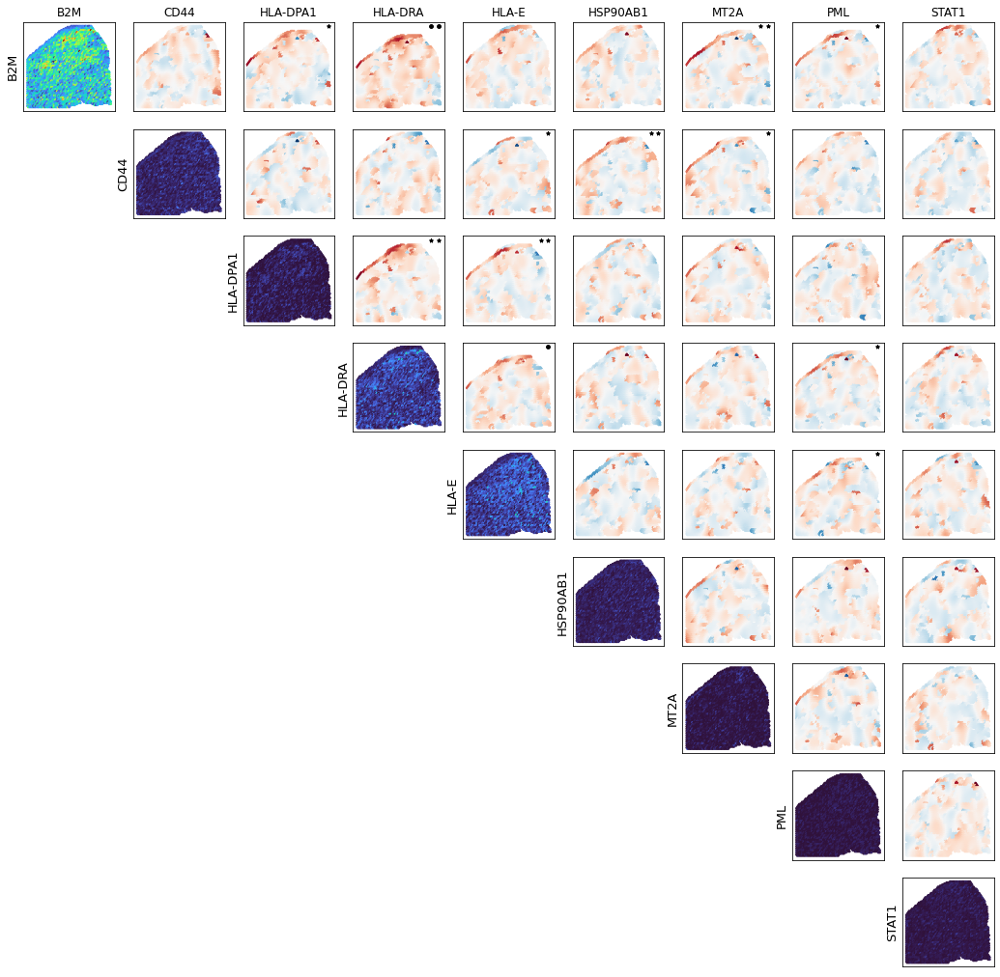

In [139]:
plot_gene_set_result(
    j_interferon_between, 
    'GO_INTERFERON_GAMMA_MEDIATED_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_interferon_within
    plot_conf=False
)

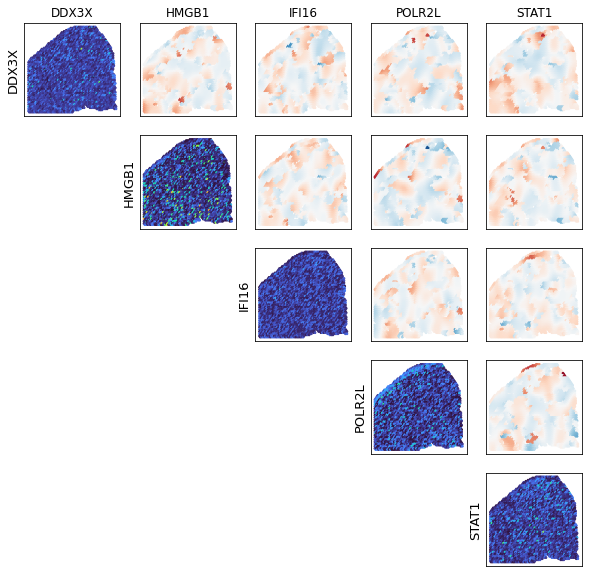

In [140]:
plot_gene_set_result(
    j_interferon_between, 
    'GO_POSITIVE_REGULATION_OF_TYPE_I_INTERFERON_PRODUCTION', 
    est_type='local',
    data_res_2=j_interferon_within
    
)

# GO Epidermis Development

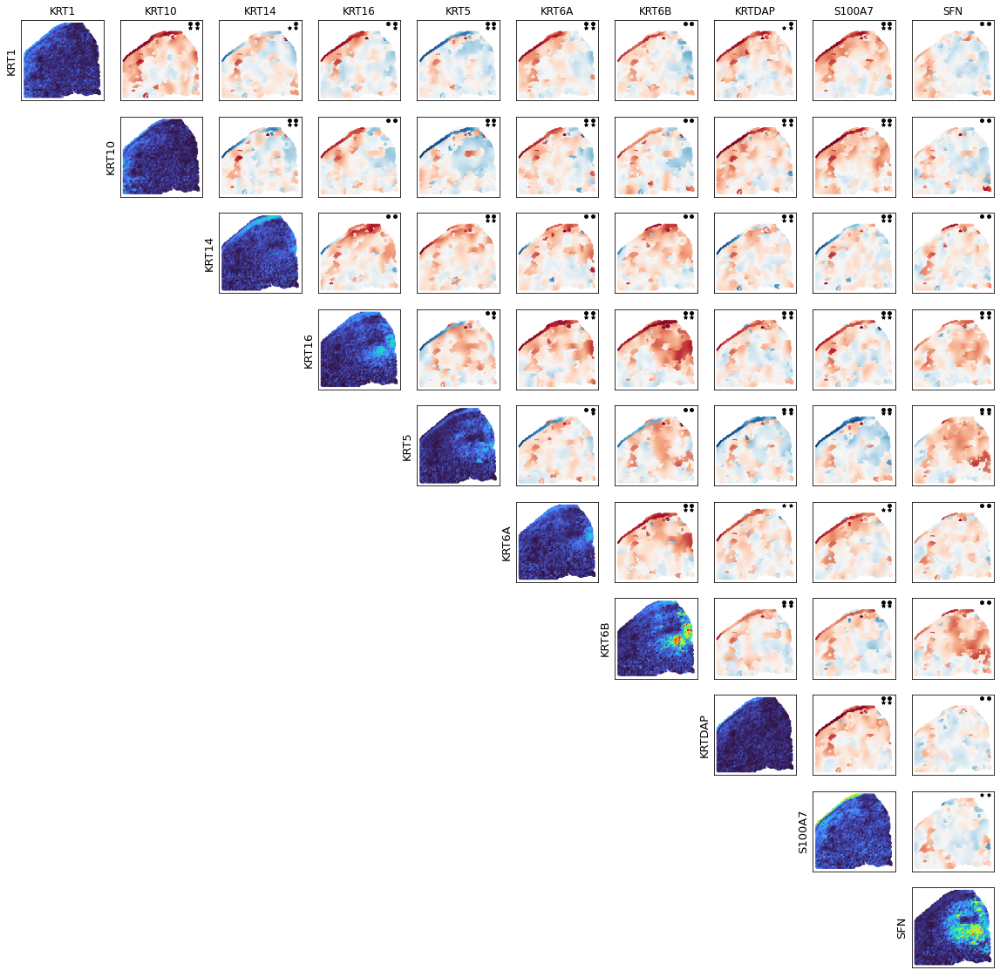

In [197]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_EPIDERMIS_DEVELOPMENT', 
    est_type='local',
    data_res_2=j_epidermis_dev_within,
    plot_conf=False  
)

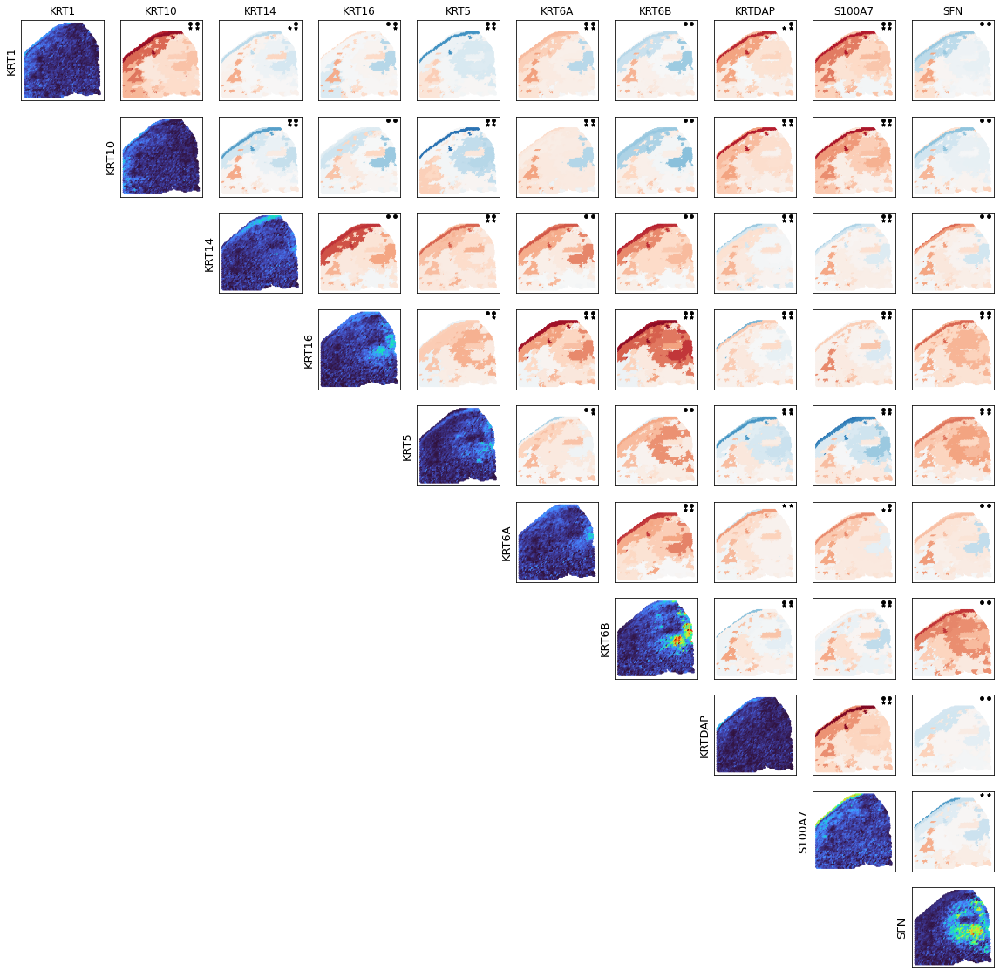

In [196]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_EPIDERMIS_DEVELOPMENT', 
    est_type='regional',
    data_res_2=j_epidermis_dev_within,
    plot_conf=False  
)

## Gene pair of interest:  S100A7 and KRT5

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.002
Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.002


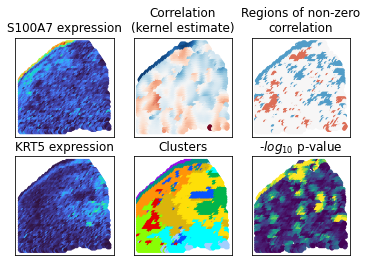

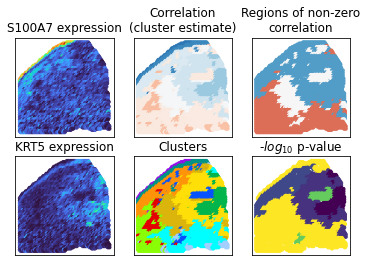

In [122]:
full_analysis_pair_2(
    'S100A7', 'KRT5',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'S100A7', 'KRT5', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

In [ ]:
##

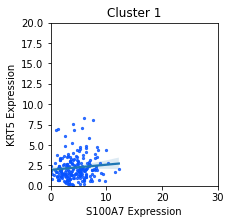

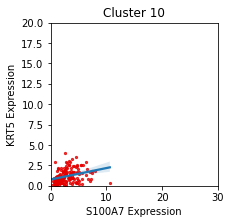

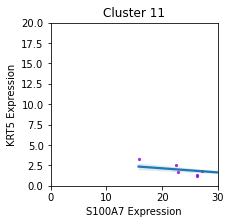

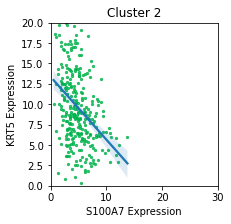

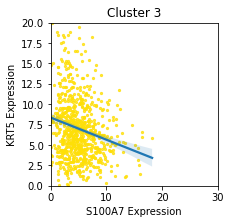

...

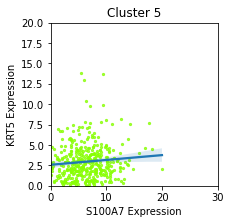

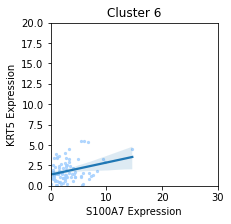

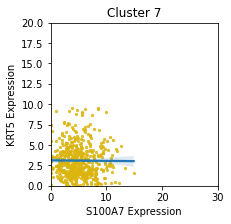

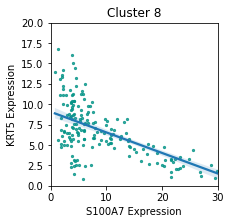

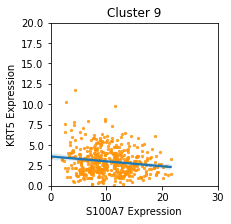

In [83]:
import matplotlib as mpl
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('S100A7', 'KRT5', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 30), ylim=(0,20))
    #plot_cluster_mvn('S100A7', 'KRT5', clust, xlim=(0, 30), ylim=(0,20))
    plt.title(f'Cluster {clust}')
    plt.show()

## Gene pair of interest: KRT5, KRT10

There looks to be some negative correlation within the TSK-clusters. Do these correspond to regions with high TSK-scores?

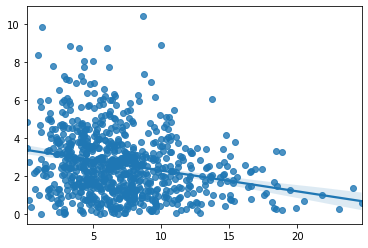

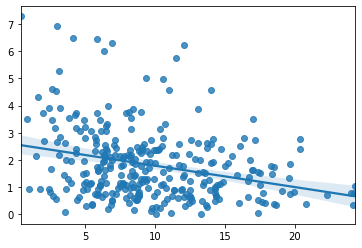

In [231]:
expr_1 = adata.obs_vector('KRT5')[ct_to_inds['3']]
expr_2 = adata.obs_vector('KRT10')[ct_to_inds['3']]
sns.regplot(expr_1, expr_2)#, s=4)
plt.show()

expr_1 = adata.obs_vector('KRT5')[ct_to_inds['2']]
expr_2 = adata.obs_vector('KRT10')[ct_to_inds['2']]
sns.regplot(expr_1, expr_2)#, s=4)
plt.show()

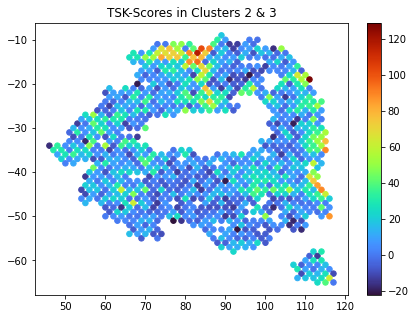

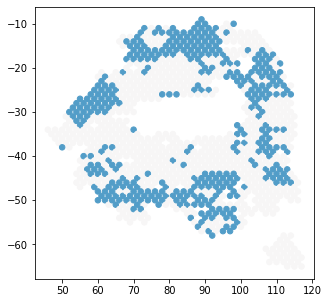

In [255]:
corrs, keep_inds = corr_pos_neg('KRT5', 'KRT10', adata, bc_to_neighs=bc_to_neighs)

plot_inds = sorted(set(clust_to_indices['3']+clust_to_indices['2']) & set(keep_inds))
corrs_restrict = [
    corr
    for corr, ind
    in zip(corrs, keep_inds)
    if ind in set(plot_inds)
]
inds_restrict = [
    ind
    for corr, ind
    in zip(corrs, keep_inds)
    if ind in set(plot_inds)
]
llrtp.plot_slide(
    adata.obs.iloc[plot_inds], 
    tsk_scores[plot_inds], 
    cmap='turbo',
    #vmin=-25,
    #vmax=100,
    colorbar=True,
    title='TSK-Scores in Clusters 2 & 3',
    dsize=30
)
plt.show()
llrtp.plot_slide(
    adata.obs.iloc[inds_restrict], 
    corrs_restrict, 
    cmap='RdBu_r',
    vmin=-1.8,
    vmax=1.8,
    dsize=30
)
plt.show()

## Gene pair of interest KRT16 and S100A8

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)


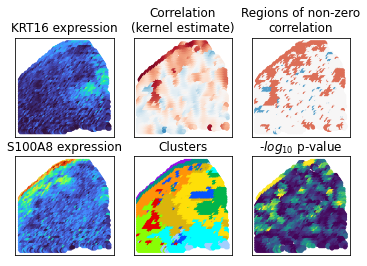

In [56]:
full_analysis_pair_2(
    'KRT16', 'S100A8', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)

## Gene pair of interest: KRT10 KRT16

#### Something weird happens here where the marginal correlation in cluster 8 is significantly different from the local correlations

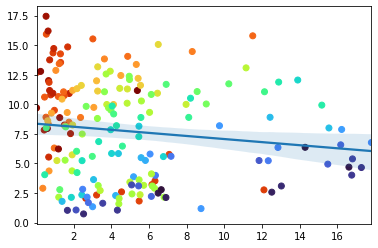

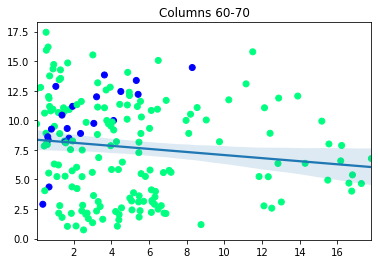

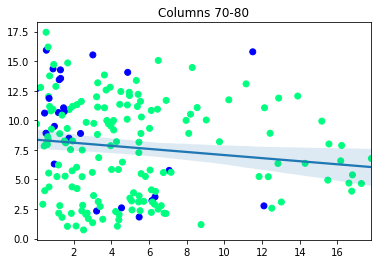

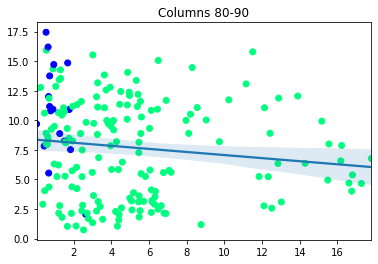

In [187]:
plot_cluster_scatter('KRT10', 'KRT16', '8', col_vals=np.array(adata.obs['col']), cmap='turbo')
plt.show()

plot_cluster_scatter('KRT10', 'KRT16', '8',  
    np.logical_not(np.logical_and(
        np.array(adata.obs['col']) >= 60, 
        np.array(adata.obs['col']) <= 70
    )).astype('int'), cmap='winter'
)
plt.title('Columns 60-70')
plt.show()

plot_cluster_scatter('KRT10', 'KRT16', '8',  
    np.logical_not(np.logical_and(
        np.array(adata.obs['col']) >= 70, 
        np.array(adata.obs['col']) < 80
    )).astype('int'), cmap='winter'
)
plt.title('Columns 70-80')
plt.show()
plot_cluster_scatter('KRT10', 'KRT16', '8',  
    np.logical_not(np.logical_and(
        np.array(adata.obs['col']) >= 80, 
        np.array(adata.obs['col']) < 90
    )).astype('int'), cmap='winter'
)
plt.title('Columns 80-90')
plt.show()

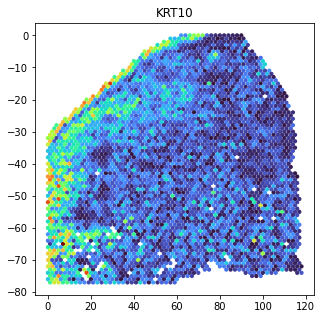

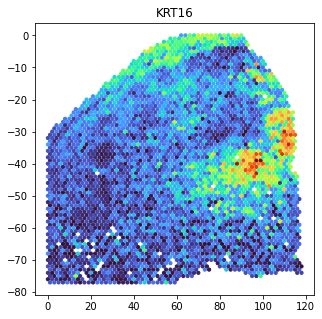

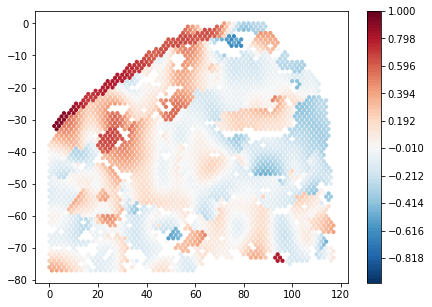

In [188]:
plot_cluster_corrs, kept_inds = plot_within('KRT10', 'KRT16', condition='BayesSpace_11', sigma=5, dsize=10)

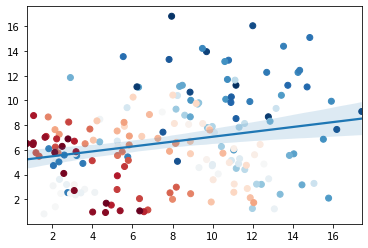

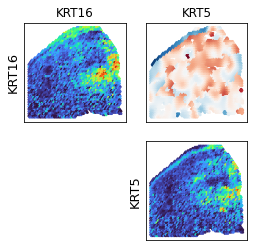

In [147]:
plot_cluster_scatter('KRT16', 'KRT5', '8', col_vals=np.array(adata.obs['col']), cmap='RdBu')
generate_gene_set_plots(
    ['KRT16', 'KRT5'], 
    adata, 
    condition='BayesSpace_11', 
    sigma=5,
    corr_magnitude=False,
    estimate_type='local', 
    pairwise_pvals=None,
    pairwise_pvals_2=None
)




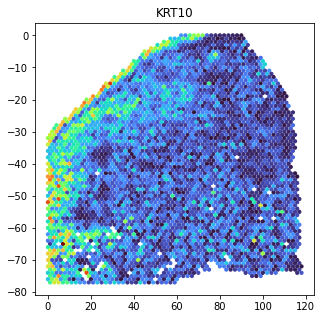

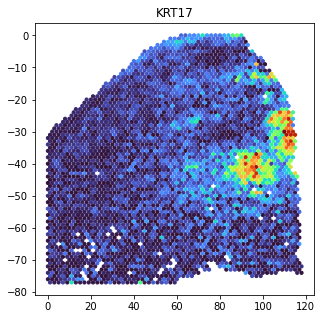

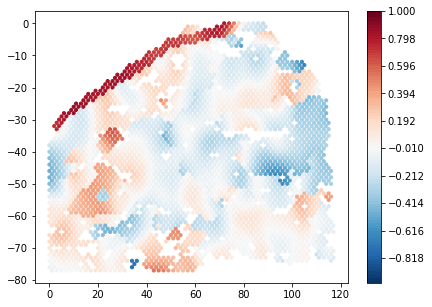

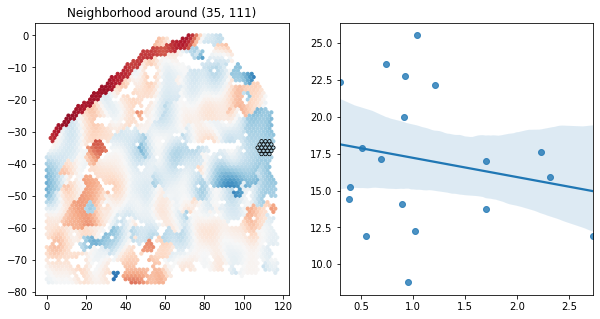

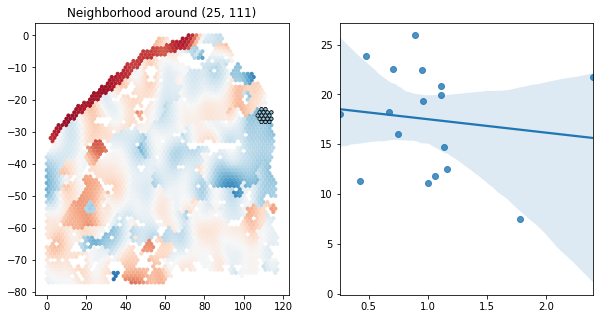

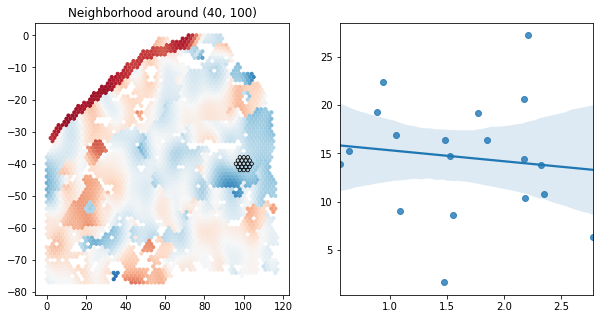

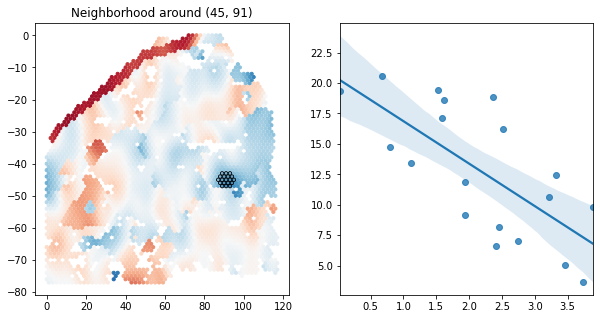

In [105]:
corrs, kept_inds = plot_within('KRT10', 'KRT17', condition='BayesSpace_11', sigma=5, dsize=10)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'KRT10', 'KRT17',
    35,
    111,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='black'
)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'KRT10', 'KRT17',
    25,
    111,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='black'
)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'KRT10', 'KRT17',
    40,
    100,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='black'
)
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'KRT10', 'KRT17',
    45,
    91,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='black'
)

# GO Regulation of Epidermis Development

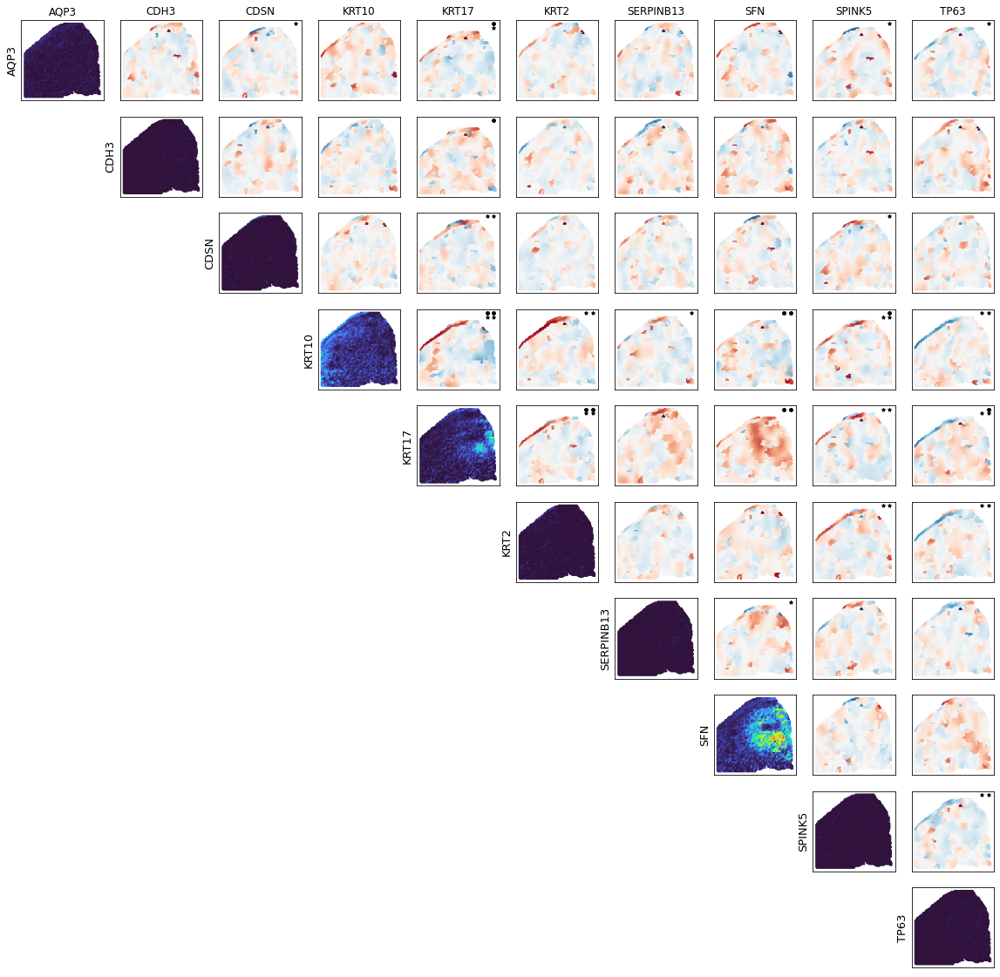

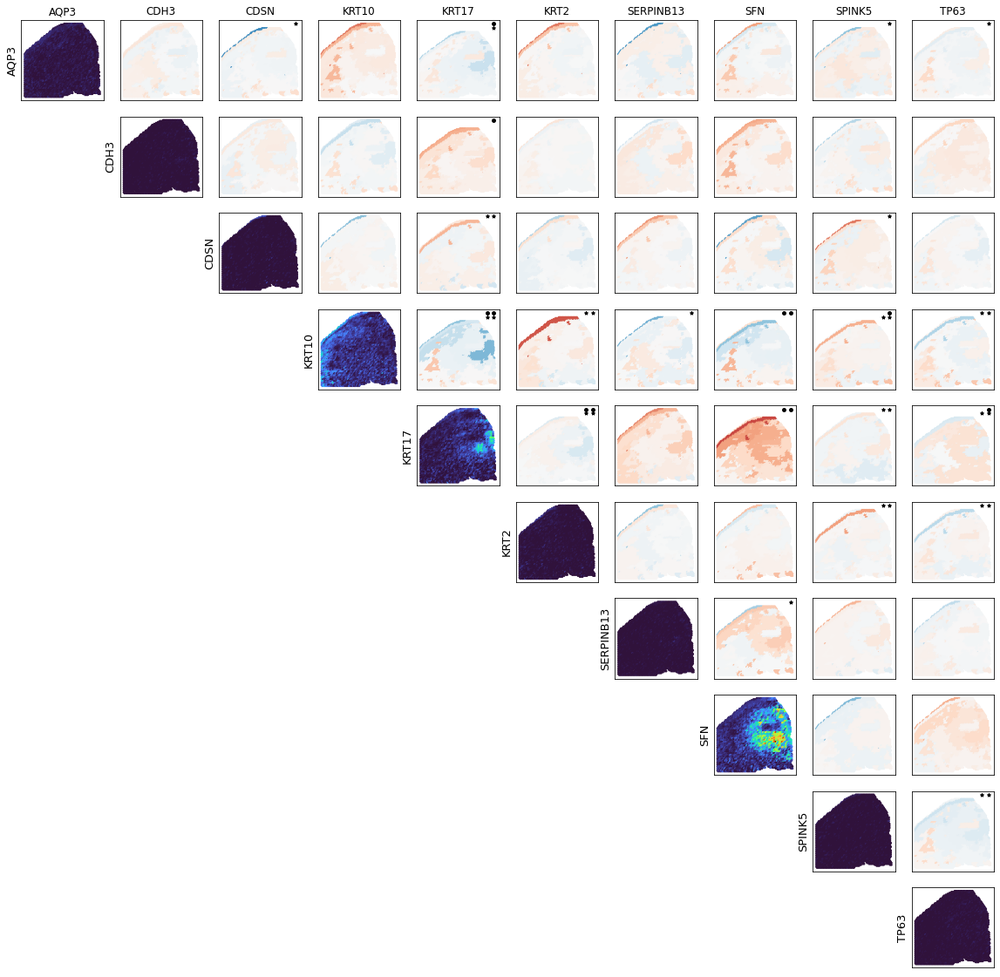

In [190]:
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 
    est_type='local',
    data_res_2=j_epidermis_dev_within
    
)
plot_gene_set_result(
    j_epidermis_dev_between, 
    'GO_REGULATION_OF_EPIDERMIS_DEVELOPMENT', 
    est_type='regional',
    data_res_2=j_epidermis_dev_within
    
)

Kept 3424/3820 spots.
P-value: 0.002
Kept 3424/3820 spots.
P-value: 0.132


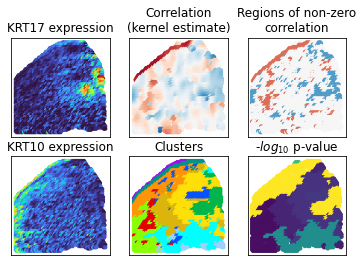

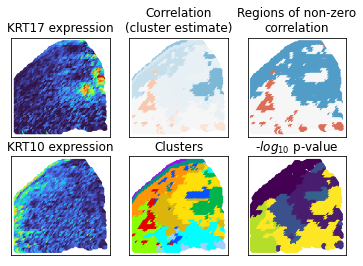

In [60]:
full_analysis_pair_2(
    'KRT17', 'KRT10',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'KRT17', 'KRT10', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

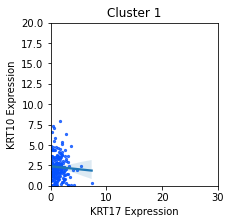

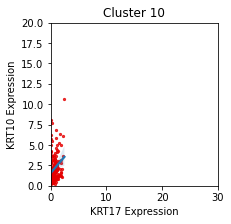

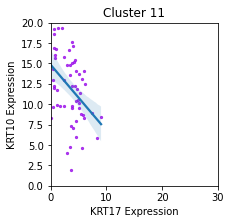

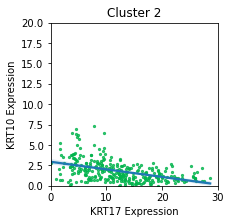

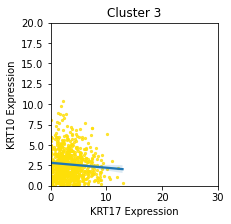

...

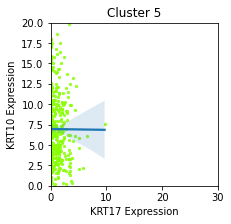

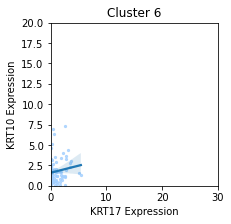

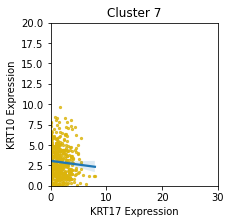

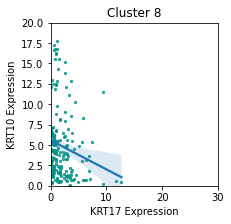

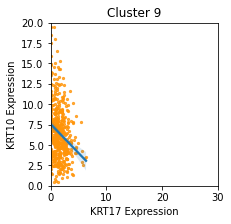

In [61]:
import matplotlib as mpl
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('KRT17', 'KRT10', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 30), ylim=(0,20))
    #plot_cluster_mvn('S100A7', 'KRT5', clust, xlim=(0, 30), ylim=(0,20))
    plt.title(f'Cluster {clust}')
    plt.show()

# GO Apoptotic signalling pathway

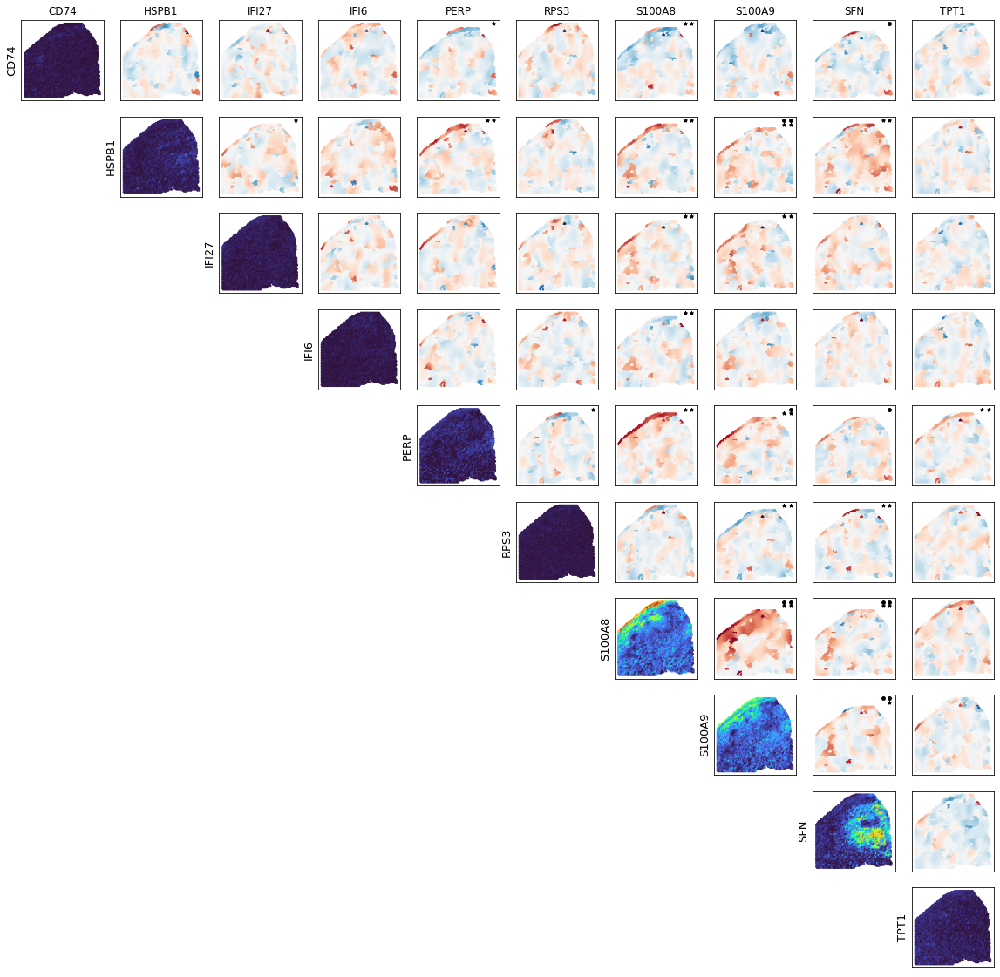

In [95]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_apoptosis_within
    
)

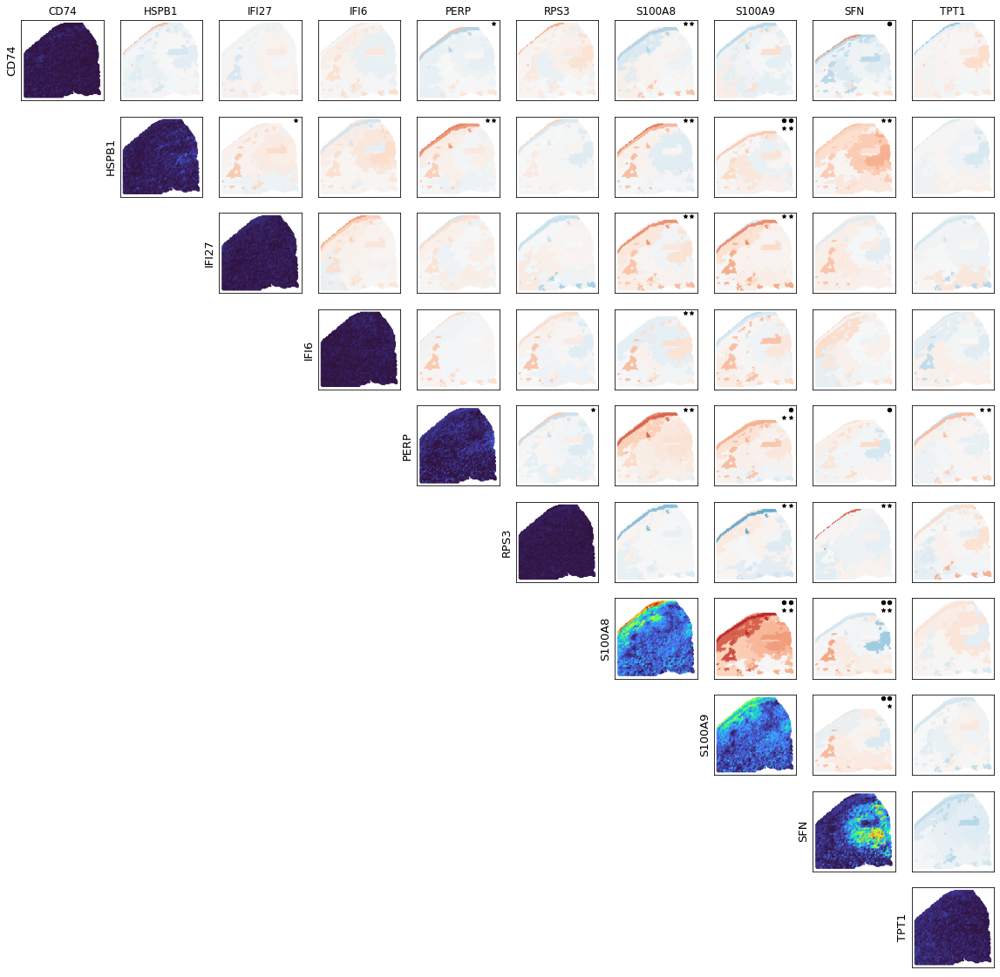

In [33]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

## GO Positive Regulation of Apoptotic Signaling Pathway

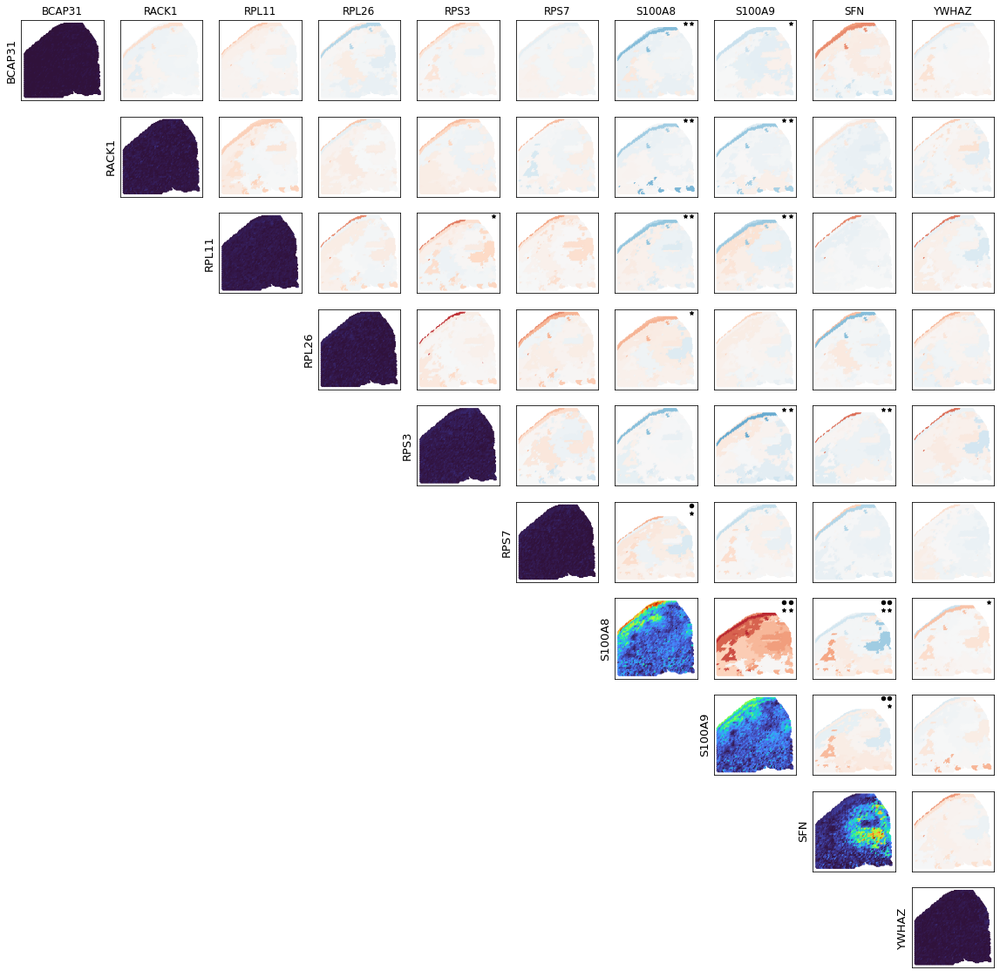

In [58]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

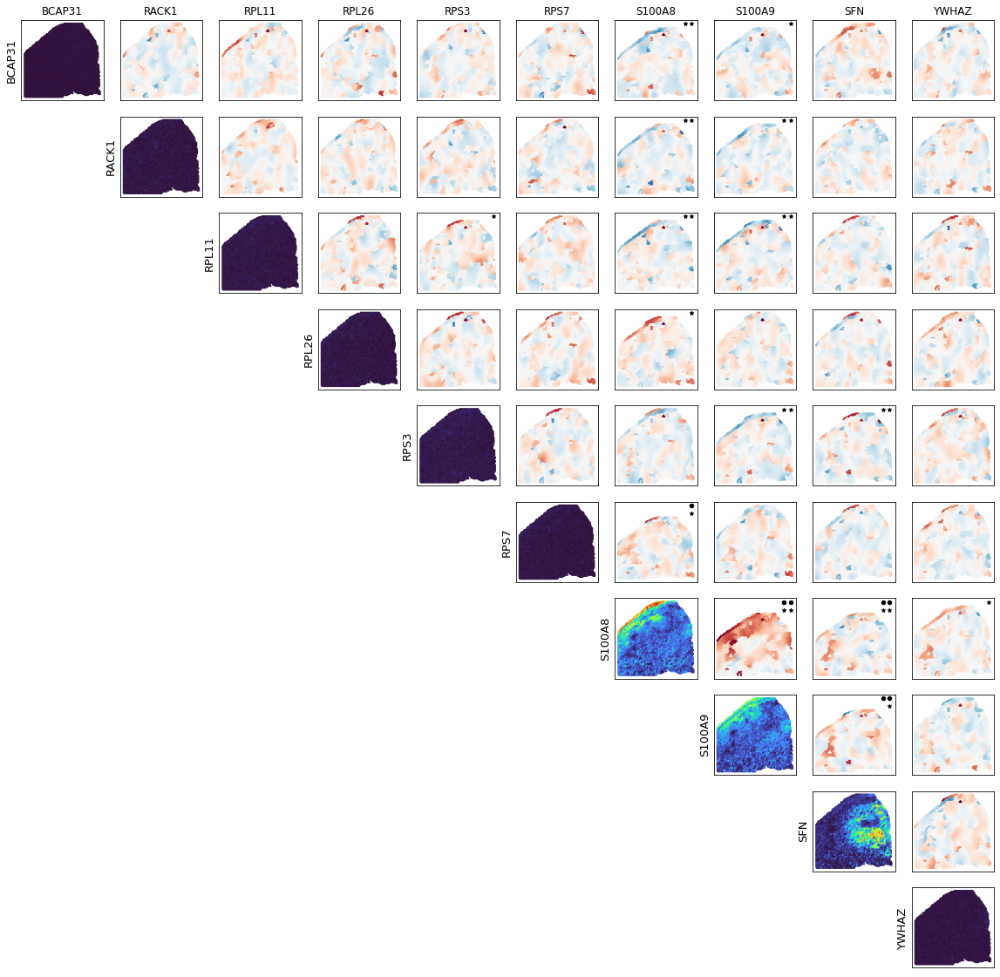

In [59]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_POSITIVE_REGULATION_OF_APOPTOTIC_SIGNALING_PATHWAY', 
    est_type='local',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)

# GO Intrinsic Apoptotic Signaling Pathway in Response to DNA Damage by P53 Class Mediator

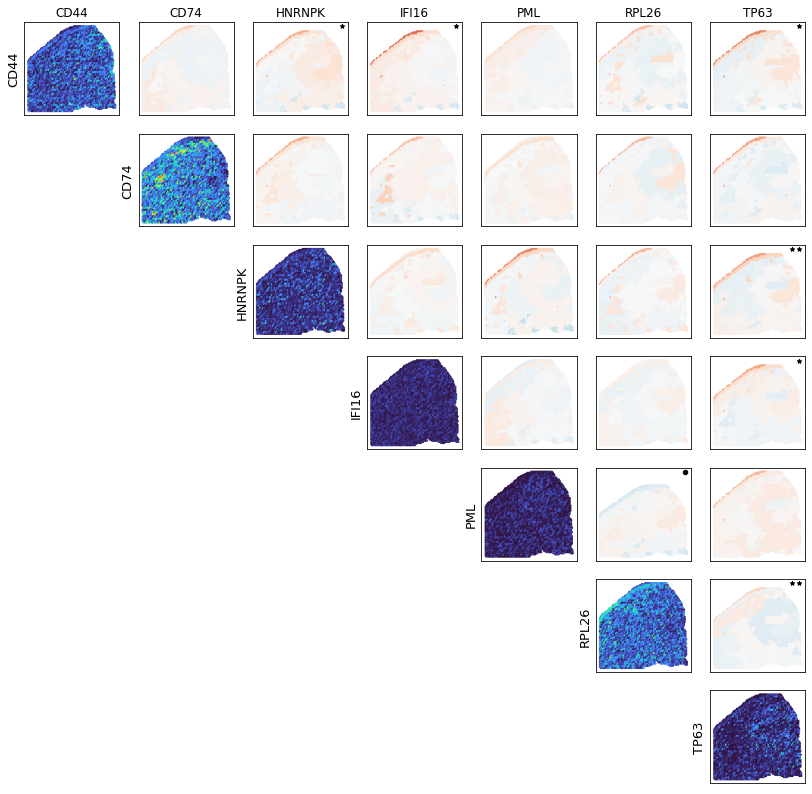

In [80]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE_BY_P53_CLASS_MEDIATOR', 
    est_type='regional',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)


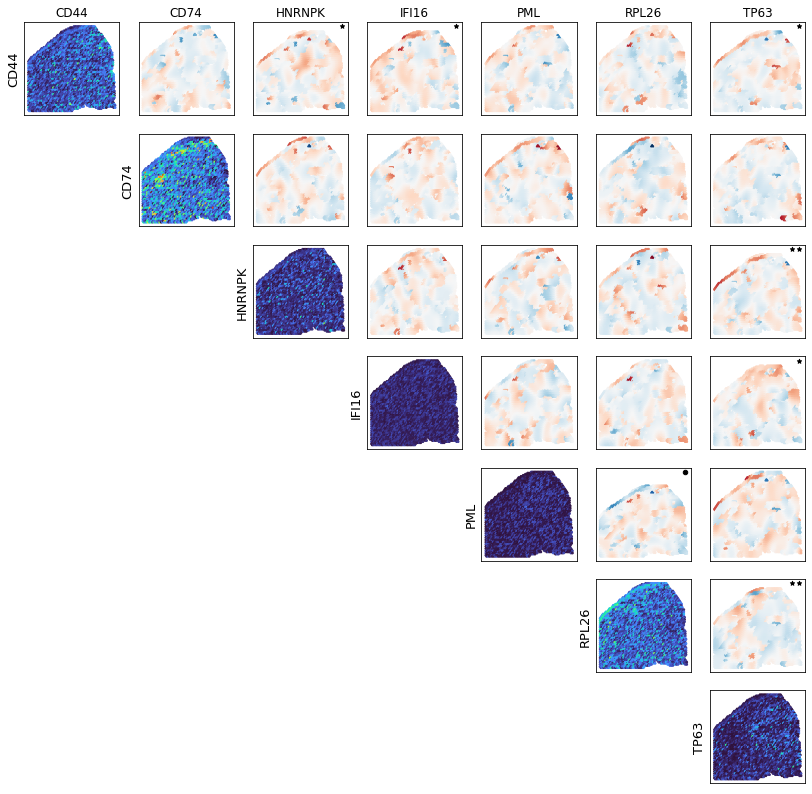

In [81]:
plot_gene_set_result(
    j_apoptosis_between, 
    'GO_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY_IN_RESPONSE_TO_DNA_DAMAGE_BY_P53_CLASS_MEDIATOR', 
    est_type='local',
    data_res_2=j_apoptosis_within,
    plot_conf=False
)



## Gene pair of interest: RPL26, TP63

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.478
Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.006


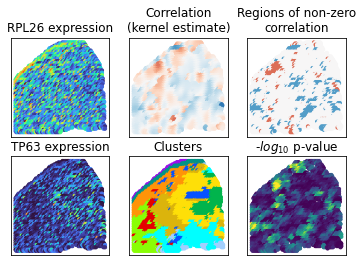

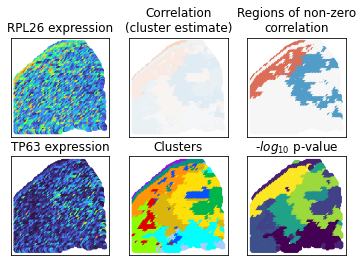

In [118]:
full_analysis_pair_2(
    'RPL26', 'TP63',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'RPL26', 'TP63', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

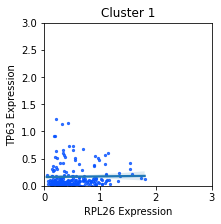

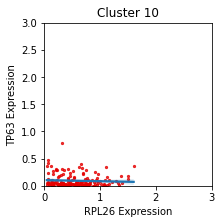

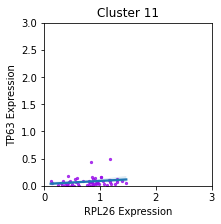

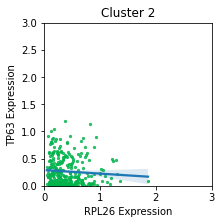

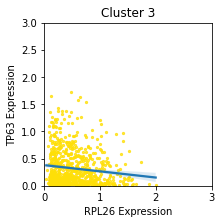

...

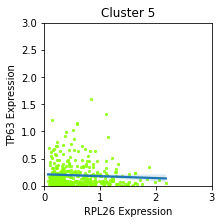

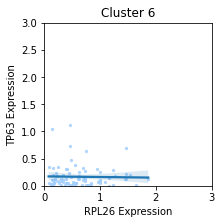

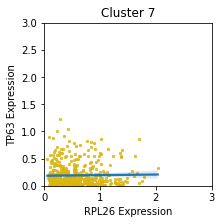

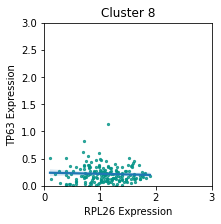

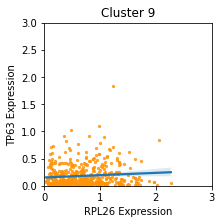

In [66]:
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('RPL26', 'TP63', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 3), ylim=(0,3))
    plt.title(f'Cluster {clust}')
    plt.show()

Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.354
Kept 3424/3820 spots.
Shape of neighborhood nulls matrix:  (3424, 100)
P-value: 0.006


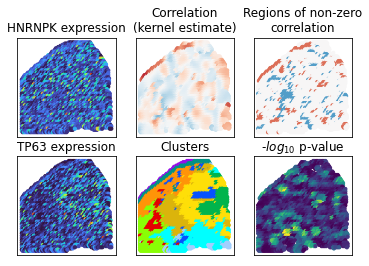

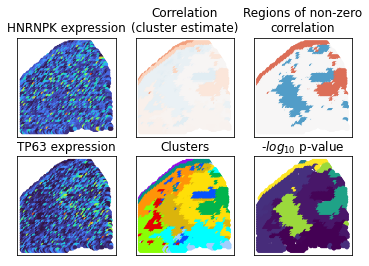

In [115]:
full_analysis_pair_2(
    'HNRNPK', 'TP63',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond
)
full_analysis_pair_2(
    'HNRNPK', 'TP63', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust
)

# GO Regulation of T Cell Activation

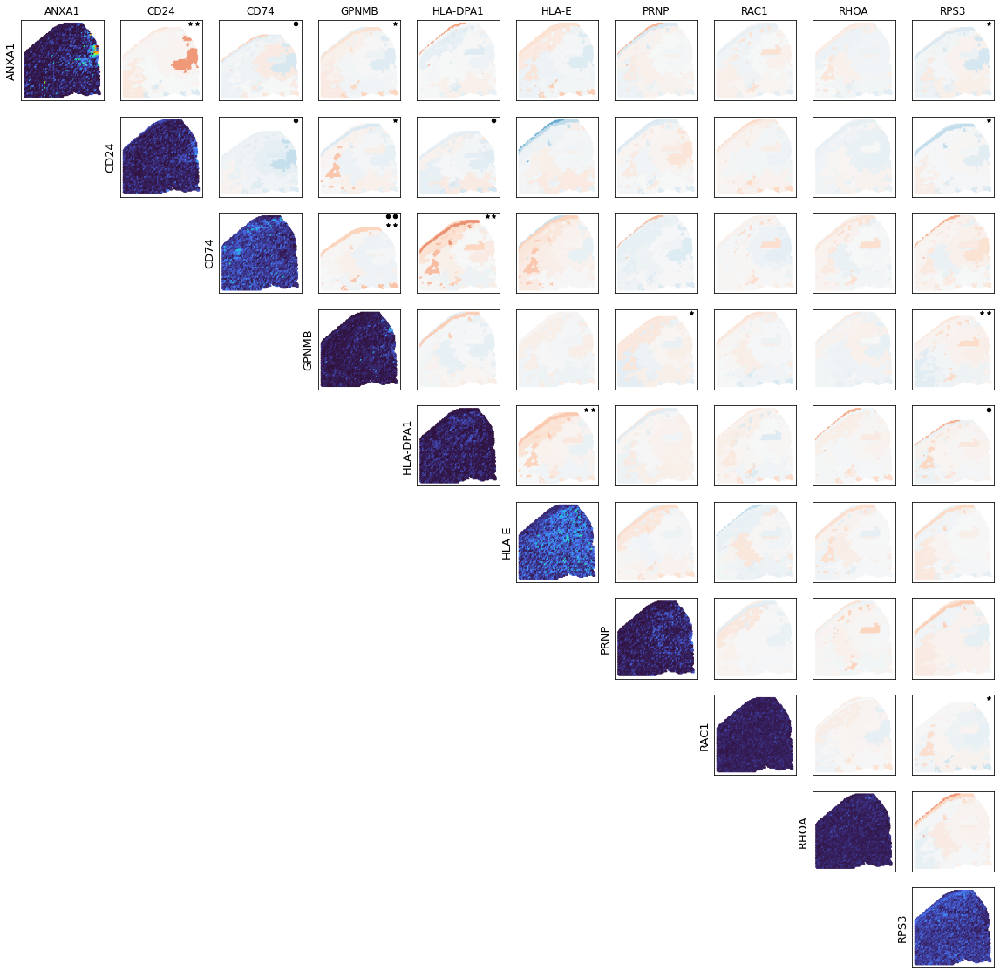

In [58]:
plot_gene_set_result(
    j_t_cell_between, 
    'GO_REGULATION_OF_T_CELL_ACTIVATION', 
    est_type='regional',
    data_res_2=j_t_cell_within,
    plot_conf=False
)

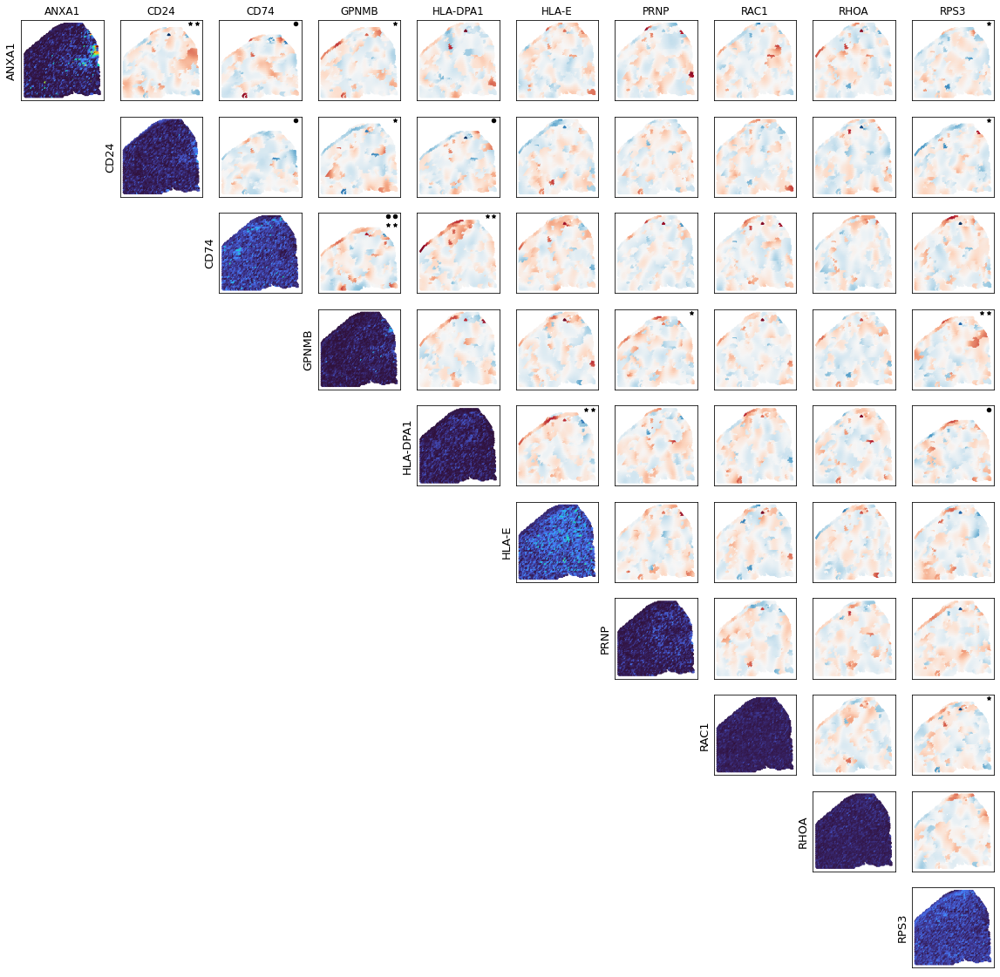

In [52]:
plot_gene_set_result(
    j_t_cell_between, 
    'GO_REGULATION_OF_T_CELL_ACTIVATION', 
    est_type='local',
    data_res_2=j_t_cell_within,
    plot_conf=False
)

In [51]:
gps, all_corrs = compute_pairwise_corrs(j_t_cell_within['gene_set_to_pairwise_pvals']['GO_REGULATION_OF_T_CELL_ACTIVATION'])

['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']


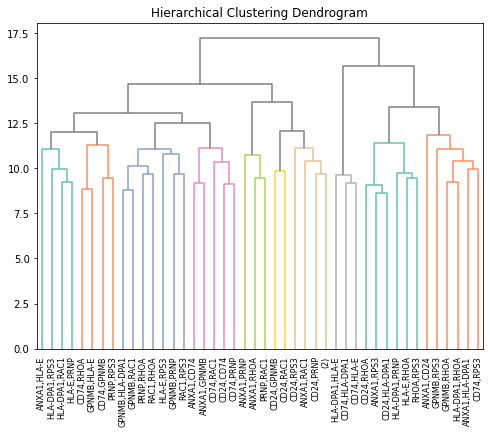

In [55]:
cluster_corrs(gps, all_corrs, color_thresh=12)

## Gene pair of interest: CD24, ANXA1

Kept 3424/3820 spots.
P-value: 0.476
Kept 3424/3820 spots.
P-value: 0.004


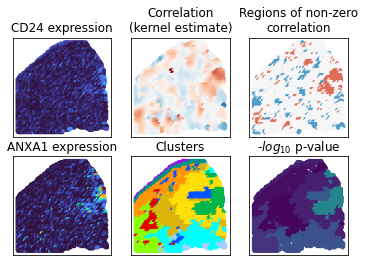

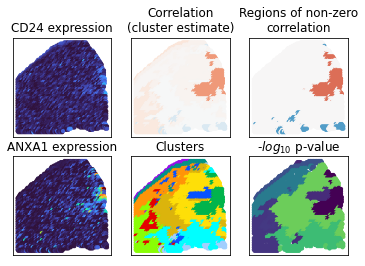

In [56]:
full_analysis_pair_2(
    'CD24', 'ANXA1',
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=False, 
    spot_to_neighbors=bc_to_neighs_clust_cond,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)
full_analysis_pair_2(
    'CD24', 'ANXA1', 
    sigma=5, 
    max_perms=500, 
    n_procs=5, 
    test_between=True, 
    spot_to_neighbors=bc_to_neighs_full_clust,
    spot_to_neighbors_clust=bc_to_neighs_full_clust
)

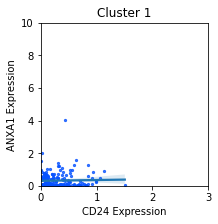

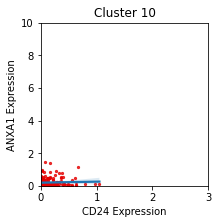

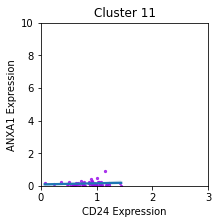

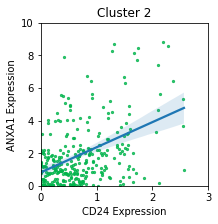

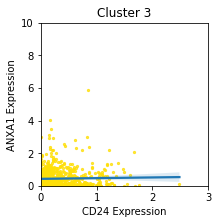

...

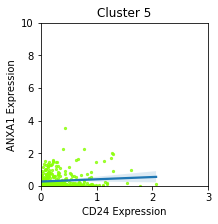

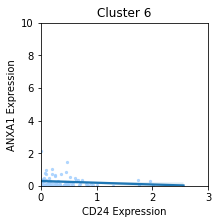

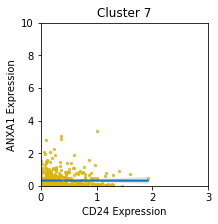

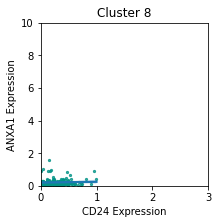

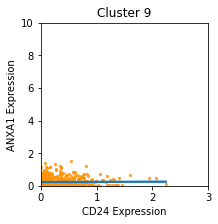

In [72]:
for c_i, i in enumerate([0, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8]):
    clust = str(i+1)
    plot_cluster_scatter('CD24', 'ANXA1', clust, color=spatialcorr.plot.PALETTE_MANY[c_i], xlim=(0, 3), ylim=(0,10))
    plt.title(f'Cluster {clust}')
    plt.show()

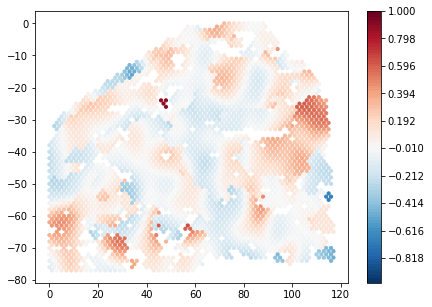

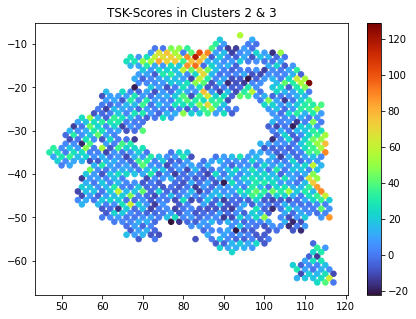

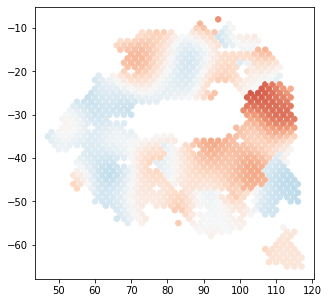

In [67]:
#corrs, keep_inds = corr_pos_neg('ANXA1', 'CD24', adata, bc_to_neighs=bc_to_neighs)
#corrs, keep_inds = plot_within('ANXA1', 'CD24', adata)
corrs, keep_inds, _ = spatialcorr.plot_correlation(
    adata,
    'ANXA1', 'CD24',
    sigma=5,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    colorbar=True,
    ticks=True,
    estimate='local',
    dsize=10
)

plot_inds = sorted(set(clust_to_indices['3']+clust_to_indices['2']) & set(keep_inds))
corrs_restrict = [
    corr
    for corr, ind
    in zip(corrs, keep_inds)
    if ind in set(plot_inds)
]
inds_restrict = [
    ind
    for corr, ind
    in zip(corrs, keep_inds)
    if ind in set(plot_inds)
]
llrtp.plot_slide(
    adata.obs.iloc[plot_inds], 
    tsk_scores[plot_inds], 
    cmap='turbo',
    #vmin=-25,
    #vmax=100,
    colorbar=True,
    title='TSK-Scores in Clusters 2 & 3',
    dsize=30
)
plt.show()
llrtp.plot_slide(
    adata.obs.iloc[inds_restrict], 
    corrs_restrict, 
    cmap='RdBu_r',
    vmin=-1,
    vmax=1,
    dsize=30
)
plt.show()


JUNK?

In [ ]:
corrs, kept_inds, _ = spatialcorr.plot_correlation(
    adata,
    'IRF3', 'IRF7',
    sigma=7,
    contrib_thresh=10,
    kernel_matrix=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    corr_magnitude=False,
    cmap='RdBu_r',
    colorbar=False,
    ticks=False,
    ax=None,
    figure=None,
    estimate='local',
    dsize=3
)
plt.show()
spatialcorr.plot_local_scatter(
    adata[kept_inds,:],
    'IRF3', 'IRF7',
    47,
    21,
    corrs,
    color_spots=None,
    row_key='row',
    col_key='col',
    condition='BayesSpace_11',
    cmap='RdBu_r',
    neighb_color='red'
)

In [ ]:
plot_gene_set_result_between(j_interferon_between, 'GO_POSITIVE_REGULATION_OF_INTERFERON_GAMMA_BIOSYNTHETIC_PROCESS')

In [ ]:
sns.histplot(adata.obs_vector('KRT10'))
plt.show()

sns.histplot(adata.obs_vector('KRT17'))
plt.show()

sns.histplot(adata.obs_vector('SFN'))
plt.show()

In [ ]:
generate_gene_set_plots(
    ['HLA-E', 'IFI27', 'IFI6'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['HLA-E', 'IFI27', 'IFI6'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    ['RPL3', 'RPS2'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['RPL3', 'RPS2'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)


In [ ]:
generate_gene_set_plots(
    ['CD74', 'HSPB1', 'IFI27', 'IFI6', 'PERP', 'RPS3', 'S100A8', 'S100A9', 'SFN', 'TPT1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['CD74', 'HSPB1', 'IFI27', 'IFI6', 'PERP', 'RPS3', 'S100A8', 'S100A9', 'SFN', 'TPT1'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    [
        "CD74",
        "HSPB1",
        "IFI6",
        "RPS3",
        "S100A8",
        "S100A9",
        "SFN",
        "TPT1"
    ], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    [
        "CD74",
        "HSPB1",
        "IFI6",
        "RPS3",
        "S100A8",
        "S100A9",
        "SFN",
        "TPT1"
    ], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT10', 'KRT17'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT10', 'KRT17'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT14', 'KRT16'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['KRT14', 'KRT16'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['S100A7', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['S100A7', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=True,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['SFN', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=True,
    compute_spotwise_pvals=False,
    max_perms=500,
    standardize_var=False
)
print("P-value: ", p_val)

p_val, t_obs, t_nulls, keep_inds, obs_spot_lls, spotwise_t_nulls, spot_p_vals = spatialcorr.run_test(
    adata,
    ['SFN', 'KRT1'],
    sigma=5,
    cond_key='BayesSpace_11',
    contrib_thresh=10,
    row_key='row',
    col_key='col',
    verbose=1,
    n_procs=5,
    test_between_conds=False,
    compute_spotwise_pvals=False,
    max_perms=500,
    standardize_var=True
)
print("P-value: ", p_val)

In [ ]:
generate_gene_set_plots(
    ['KRT1', 'KRT14', 'KRT16', 'KRT6A', 'KRT6B', 'S100A7', 'SFN'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['KRT1', 'KRT14', 'KRT16', 'KRT6A', 'KRT6B', 'S100A7', 'SFN'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)

In [ ]:
generate_gene_set_plots(
    ['CALML5', 'CSTA', 'DSP', 'FABP5', 'KRT1', 'KRT10', 'KRT14', 'KRT16', 'KRT17', 'KRT5', 'KRT6A', 'KRT6B', 'KRT6C', 'KRTDAP', 'PERP', 'PI3', 'S100A7', 'SFN', 'SPRR1B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=7
)
generate_gene_set_plots(
    ['CALML5', 'CSTA', 'DSP', 'FABP5', 'KRT1', 'KRT10', 'KRT14', 'KRT16', 'KRT17', 'KRT5', 'KRT6A', 'KRT6B', 'KRT6C', 'KRTDAP', 'PERP', 'PI3', 'S100A7', 'SFN', 'SPRR1B'],
    adata,
    condition='BayesSpace_11',
    estimate_type='regional',
    sigma=7
)


In [ ]:

generate_gene_set_plots(
    ['FBXW7', 'MCL1', 'PARK7', 'SFPQ', 'SOD1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)
generate_gene_set_plots(
    ['FBXW7', 'MCL1', 'PARK7', 'SFPQ', 'SOD1'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5
)

In [ ]:
# Apoptosis-related
generate_gene_set_plots(
    ['BNIP3', 'LAMP1', 'SRGN', 'UBE4B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)
generate_gene_set_plots(
    ['BNIP3', 'LAMP1', 'SRGN', 'UBE4B'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='local',
    sigma=5
)

In [ ]:
j_epidermis_dev_within

In [ ]:
plot_gene_set_result_between(j_epidermis_dev_within, 'GO_POSITIVE_REGULATION_OF_EPIDERMIS_DEVELOPMENT')

In [ ]:
generate_gene_set_plots(
    j_epidermis_dev_within['gene_set_to_genes']['GO_NEGATIVE_REGULATION_OF_EPIDERMIS_DEVELOPMENT'], 
    adata,
    condition='BayesSpace_11',
    estimate_type='regional'
)

In [ ]:
generate_gene_set_plots(
    j_keratinocyte_within['gene_set_to_genes']['GO_POSITIVE_REGULATION_OF_KERATINOCYTE_PROLIFERATION'], 
    adata,
    condition='BayesSpace_11',
    sigma=10
)

In [ ]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
generate_gene_set_plots(
    j_keratinocyte_within['gene_set_to_genes']['GO_NEGATIVE_REGULATION_OF_KERATINOCYTE_PROLIFERATION'], 
    adata,
    sigma=10
)